In [2302]:
import glob
import os
from readfiles import *
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import h5py
from lomapost import * #All functions defined within module lomapost
%matplotlib inline

In [2303]:
import uncertainties as unc  
import uncertainties.unumpy as unumpy 


In [2304]:
set_fig_props()

In [2305]:
from IPython.display import clear_output
from IPython.display import Image

In [1475]:
#Some parameter definitions for plotting:
#----------------------------------------
xlen=plt.rcParams['figure.figsize'][0]
xyratio=0.6
ylen = xyratio*xlen
#PRINT or not??
#PRINT = True
PRINT = True
l_case_color = ['k','b','g','r']
l_case_style = ['k-','b-','g-','r-']
save_folder='/share/drive/toni/VDML/JFM_joint/'
#fformat = '.png'
fformat = '.eps'
fformat = '.pdf'


# Ref Data

In [1476]:
pantanodotdm=[[1.0,2,4,8.0],[1.0,0.668,0.569,0.367]]
CdeltaPant=[0.117,0.084,0.093,0.071]
dmratiosPant=[1.00,0.67,0.57,0.37]
fpant = np.divide(CdeltaPant,CdeltaPant[0])
dmtodwPant = fpant/dmratiosPant
conv=dmtodwPant*5.0
import scipy.io as sio
R11BM =np.loadtxt('/data2/toni/work/db/R11_1990.dat');
R22BM =np.loadtxt('/data2/toni/work/db/R22_1990.dat');
R33BM =np.loadtxt('/data2/toni/work/db/R33_1990.dat');
R12BM =np.loadtxt('/data2/toni/work/db/R12_1990.dat');
R12RM =np.loadtxt('/data2/toni/work/db/R12_1994.dat');
UselfRM =np.loadtxt('/data2/toni/work/db/uselfRogersMoser.dat');
ums20pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_umean_s20.dat');
ums40pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_umean_s40.dat');
ums80pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_umean_s80.dat');
rhos20pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_rhomean_s20.dat');
rhos40pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_rhomean_s40.dat');
rhos80pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_rhomean_s80.dat');
R12s1pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos1.dat');
R12s2pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos2.dat');
R12s4pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos4.dat');
R12s8pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos8.dat');
urmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u1.dat')
vrmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u2.dat')
wrmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u3.dat')
uvrmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u12.dat')
s80=sio.loadmat('/share/drive/toni/VDML/JFM/VDML_JFM/SSphys2_s8.mat')
s40=sio.loadmat('/share/drive/toni/VDML/JFM/VDML_JFM/SSphys2_s4.mat')
s20=sio.loadmat('/share/drive/toni/VDML/JFM/VDML_JFM/SSphys2_s2.mat')
s10=sio.loadmat('/share/drive/toni/VDML/JFM/VDML_JFM/SSphys2_s1.mat')

# Job selection

In [2412]:
p_results   = '/share/drive/toni/VDML/'          #Define path to folder with all results
#l_folders = os.listdir(p_results) #print available jobs (folders)
p_folders   = [p_results+ 's10/01/h5.stats', p_results+ 's10/02/h5.stats', p_results +'s10/04/newman/h5.stats', p_results+ 's10/06/h5.stats', \
               p_results+ 's20/01/h5.stats', p_results+ 's20/02/h5.stats', p_results+ 's20/03/h5.stats', p_results +'s20/04/h5.stats', \
               p_results+ 's40/01/h5.stats', p_results+ 's40/02/h5.stats', p_results+ 's40/03/h5.stats', p_results +'s40/04/h5.stats', \
               p_results+ 's80/01/h5.stats', p_results+ 's80/02/h5.stats', p_results+ 's80/03/h5.stats', p_results +'s80/04/h5.stats']

njobs = len(p_folders) 
PRINT = True
#define option and styles for sta reading

In [2413]:
lgroup    = [0,0,0,0,1,1,1,1,2,2,2,2,3,3,3,3];
laverage  = [1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1] # Says which to average
lcases    = [[0,1,2,3],[4,5,6,7],[8,9,10,11],[12,13,14,15]]
ncases    = 4
vlim      = [5.0,4.5,3.0,3.0]

(-184.0, 184.0)

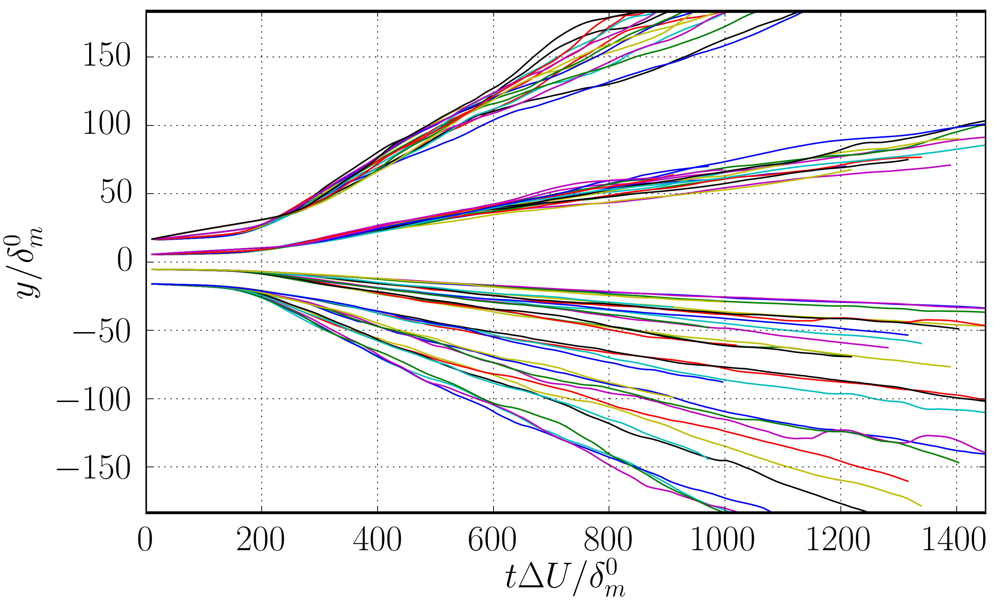

In [2414]:
posumin = [[] for x in range(njobs)]
posumax = [[] for x in range(njobs)]
posu0 = [[] for x in range(njobs)]
posrho10 = [[] for x in range(njobs)]
posepmax =[[] for x in range(njobs)]
posurmsmax =[[] for x in range(njobs)]
tmax_phys=[[] for x in range(njobs)]
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
xi = np.linspace(-2,2,200) #vector x to interpolate (chi)
for path,ijob in zip(p_folders,range(len(p_folders))):
    with h5py.File(path,"r") as f:
        um = np.array(f['um'])
        bet = np.array(f['bet'])
        w3m = np.array(f['w3m'])
        urms = np.array(f['urms'])
        rhom = np.array(f['rhom'])
        rum = np.array(f['rum'])
        umax=np.max(um[:,0])
        umin=np.min(um[:,0])
        y = np.array(f['y'])
        time = np.array(f['time'])
        ddtmp =np.array(f['dw'])
        mag = um[0,-1]
        #mag = np.max(rum/rhom)
        getlim = False
        for i in range(len(time)):
            yxi = y/ddtmp[i]
            scaled = np.interp(xi,yxi,um[:,i])
            #scaled = np.interp(xi,yxi,urms[:,i])
            #scaledrho = np.interp(xi,yxi,rhom[:,i])
        #ep = stats[ijob][ista]['epR'][:]
        #epmax = ep.max()
        #posep = (y[where(ep==epmax)]/dmtmp)
        #posurms= (y[where(urms==urms.max())]/dmtmp)
        #posdudy = (y[where(dudy==dudy.max())]/dmtmp)
            pos1 = np.interp(-0.99*mag,-scaled,xi)
            pos2 = np.interp(0.99*mag,-scaled,xi)
            #Asking for at least 2 vortices on Z
            #if (getlim == False and 2*np.pi/bet/ddtmp[i]/2.0<=2.0):
            #    tmax_phys[ijob] = time[i]
            #    getlim=True
            val = vlim[lgroup[ijob]]
            if (getlim == False and val*pos2*ddtmp[i]>=y[-1]):
                tmax_phys[ijob] = time[i]
                getlim=True
        #pos0 = np.interp(0.0,-scaled,xi)
        #pos10 = np.interp(-1.0,-scaledrho,xi)
        #posu0[ijob]  = r_[posu0[ijob]  , pos0]
            posumin[ijob]= r_[posumin[ijob], pos2]
            posumax[ijob]= r_[posumax[ijob], pos1]
    plt.plot(time,posumin[ijob]*ddtmp)
    plt.plot(time,posumax[ijob]*ddtmp)
    plt.plot(time,posumin[ijob]*ddtmp*3)
    plt.plot(time,posumax[ijob]*ddtmp*3)

plt.plot([0.0,1450],[y[0],y[0]],'k-',lw=3.0)
plt.plot([0.0,1450],[y[-1],y[-1]],'k-',lw=3.0)
#plt.plot([0.0,1450],[0.33*y[-1],0.33*y[-1]],'k--')

#plt.plot([0.0,1450],[0.33*y[0],0.33*y[0]],'k--')
plt.xlabel(r'$t\Delta U/\delta_m^0$')
plt.ylabel(r'$y/\delta_m^0$')
plt.grid('on')
plt.xlim([0,1450])
plt.ylim([y[0],y[-1]])

In [2415]:
print lcases[0]
print ncases
tmaxcases=np.zeros(ncases)
Dtcases=np.zeros(ncases)
tmaxcases = 1/tmaxcases #infinite value initialization
Dtcases = 1/Dtcases
for icase in range(ncases):
    for ijob in lcases[icase]:
        path = p_folders[ijob];
        with h5py.File(path,"r") as f:
            #lkeys[icase] = f.keys()
            #for name in f:
                #print name
            time = np.array(f['time'])
        tmaxcases[icase] = min(tmaxcases[icase],tmax_phys[ijob])
        Dtcases[icase]   = min(Dtcases[icase],np.min(np.diff(time)))
    if tmaxcases[icase] == 0.0:
        tmaxcases[icase]= 1450
    print tmaxcases[icase]
    icase = icase +1
    
#tmaxcases[1]=min(tmaxcases[0],tmaxcases[1])
#tmaxcases[3]=min(tmaxcases[2],tmaxcases[3])
print Dtcases

[0, 1, 2, 3]
4
596.258422852
616.117126465
890.667358398
873.093200684
[ 0.          8.29614258  7.99401855  4.01013184]


#Based on previous number and the value of Dw remaining constant
tmaxcases[0] = 820
tmaxcases[1] = 820
tmaxcases[2] = 830
tmaxcases[3] = 900


In [2416]:
print tmaxcases
#Test
tmaxcases= [550,550,600,670]
#tmaxcases[0]=750
tmax = 950.0

[ 596.25842285  616.11712646  890.6673584   873.09320068]


In [2419]:
# Define time bins
#vNtimes = [61,61,61,61]
vNtimes = [21,21,26,26]
vtcases = [0,0,0,0]
for icase in range(ncases):
    vtcases[icase]=np.linspace(80.0,tmaxcases[icase],vNtimes[icase])
    print np.min(np.diff(vtcases[icase]))

23.5
23.5
20.8
23.6


In [2420]:
vstats = []
print ncases
vmy = [0,0,0,0]
vy = [0,0,0,0]
vkeys_t = [[],[],[],[]]
vkeys_scal = [[],[],[],[]]
vkeys_prof = [[],[],[],[]]
for icase in range(ncases):#For each case we have the jobs numbered in ljobs
    #First read the keys
    path = p_folders[lcases[icase][0]]

    print icase
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        vmy[icase] = len(np.array(f['y']))
        for name in f:
            if len(time)==len(np.array(f[name])):
                if name!='time':
                    vkeys_t[icase].append(name)
            elif len(np.array(f[name]))==1:
                vkeys_scal[icase].append(name)
            elif name =='y' or name=='fmap':
                vy[icase]=np.array(f['y'])
            else:
                vkeys_prof[icase].append(name)

4
0
1
2
3


In [2443]:
mydict = [{},{},{},{}]

for icase in range(ncases):
    for variable in vkeys_scal[icase]:#For each variable
        for ijob in lcases[icase]:
            path = p_folders[ijob]
            #print ijob
            with h5py.File(path,"r") as f:
                scal_value = np.array(f[variable])
        mydict[icase][variable] = scal_value

for icase in range(ncases):
    for variable in vkeys_t[icase]:#For each variable
        vtemp  = np.zeros([vNtimes[icase]]) #Initialize vectors
        vtemp2  = np.zeros([vNtimes[icase]]) #Initialize vectors
        vcount = np.zeros([vNtimes[icase]])
        for ijob in lcases[icase]:
            path = p_folders[ijob]
            #print ijob
            with h5py.File(path,"r") as f:
                time = np.array(f['time'])
                buff = np.array(f[variable])
            if time[-1] <= tmaxcases[icase]:
                itmax = -1
            else:
                itmax = np.where(time>=tmaxcases[icase])[0][0]
            for ii in range(1,vNtimes[icase]):
                for it in range(0,itmax):
                    if (vtcases[icase][ii-1]<=time[it]<=vtcases[icase][ii]):
                        vtemp[ii]  = vtemp[ii]  + buff[it]
                        vtemp2[ii]  = vtemp2[ii]  + buff[it]**2
                        vcount[ii] = vcount[ii] + 1
        mydict[icase][variable] = vtemp/vcount         
        mydict[icase][variable+'std'] = np.sqrt(vtemp2/vcount-(vtemp/vcount)**2 )
for icase in range(ncases):
    for variable in vkeys_prof[icase]:#For each variable
        #print variable
        vtemp  = np.zeros([vmy[icase],vNtimes[icase]]) #Initialize vectors
        vtemp2  = np.zeros([vmy[icase],vNtimes[icase]]) #Initialize vectors
        vcount = np.zeros([vNtimes[icase]])
        for ijob in lcases[icase]:
            path = p_folders[ijob]
            #print ijob
            with h5py.File(path,"r") as f:
                time = np.array(f['time'])
                buff = np.array(f[variable])
            if time[-1] <= tmaxcases[icase]:
                itmax = -1
            else:
                itmax = np.where(time>=tmaxcases[icase])[0][0]
            for ii in range(1,vNtimes[icase]):
                for it in range(0,itmax):
                    if (vtcases[icase][ii-1]<=time[it]<=vtcases[icase][ii]):
                        vtemp[:,ii]  = vtemp[:,ii]  + buff[:,it]
                        vtemp2[:,ii]  = vtemp2[:,ii]  + buff[:,it]**2
                        vcount[ii] = vcount[ii] + 1
        mydict[icase][variable] = np.divide(vtemp,vcount)
        mydict[icase][variable+'std'] = np.sqrt(vtemp2/vcount-(vtemp/vcount)**2)
            
            

#vdm = vdm/vcount

In [2425]:
SS1=[600,600,690,710]
SS1=[400,400,450,550]
ivtmin = [0,0,0,0]
for icase in range(ncases):
    ivtmin[icase] = np.where(vtcases[icase]>=SS1[icase])[0][0]


In [2466]:
for icase in range(ncases):
    itmax = len(mydict[icase]['dm'])
    dme = np.zeros([itmax])
    dwe = np.zeros([itmax])
    dmpointe = np.zeros([itmax])
    
    for it in range(0,itmax):
        dme [it] = calcdmcomp(vy[icase],mydict[icase]['um'][:,it],mydict[icase]['rum'][:,it],mydict[icase]['rhom'][:,it])
        dwe [it] = calcdwcomp(vy[icase],mydict[icase]['um'][:,it],mydict[icase]['rum'][:,it],mydict[icase]['rhom'][:,it])
        dmpointe[it] = -2.0*np.trapz(mydict[icase]['rhom'][:,it]*mydict[icase]['R12'][:,it]* \
                                     der1(vy[icase],mydict[icase]['rum'][:,it]/mydict[icase]['rhom'][:,it]),vy[icase])
    mydict[icase]['dme'] = dme
    mydict[icase]['dwe'] = dwe
    mydict[icase]['dmpointe'] = dmpointe
    print 2*np.pi/mydict[icase]['bet']/dwe[ivtmin[icase]]
    print 2*np.pi/mydict[icase]['bet']/dwe[-1]

[ 5.78875828]
[ 4.19899893]
[ 6.07577181]
[ 4.41547346]
[ 5.81149864]
[ 4.20406055]
[ 5.49625015]
[ 4.34793568]


1.0336451159
1.02871806218
1.04423718388
1.03528767916


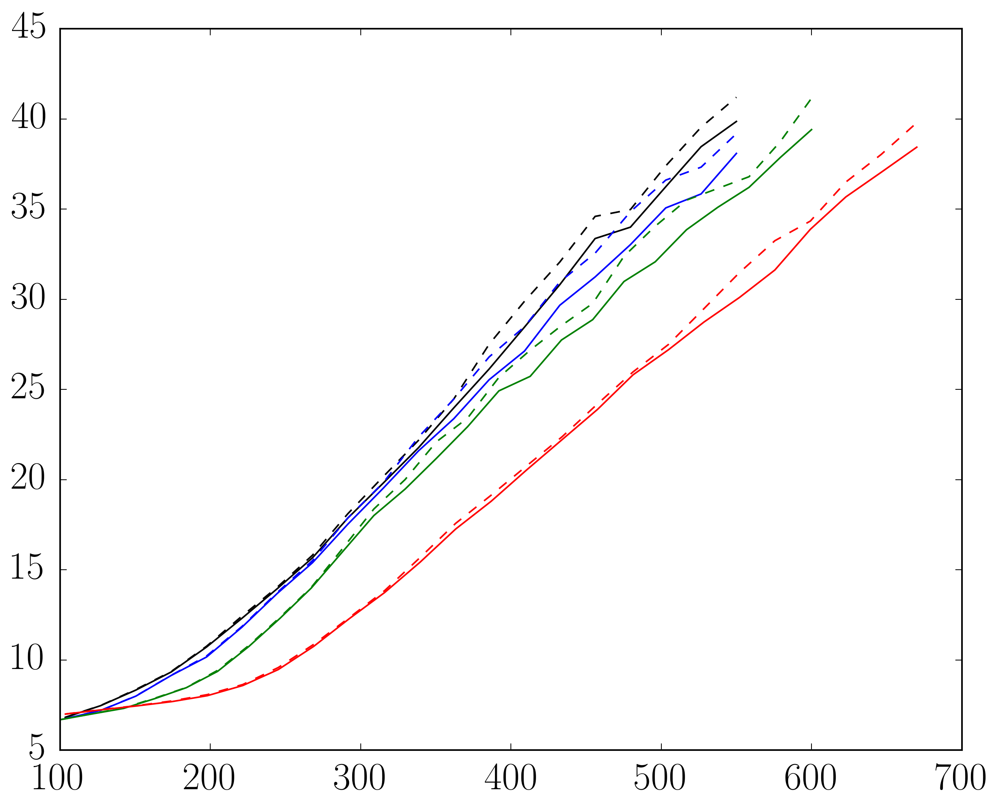

In [2427]:
for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase]['dw'],l_case_style[icase])
    plt.plot(vtcases[icase],mydict[icase]['dwe'],l_case_style[icase],ls='--')
    print mydict[icase]['dwe'][-1]/mydict[icase]['dw'][-1]

In [2428]:
print tmaxcases

[550, 550, 600, 670]


# Time series

figure saved at /share/drive/toni/VDML/JFM_joint/dmvstime_ave.pdf!


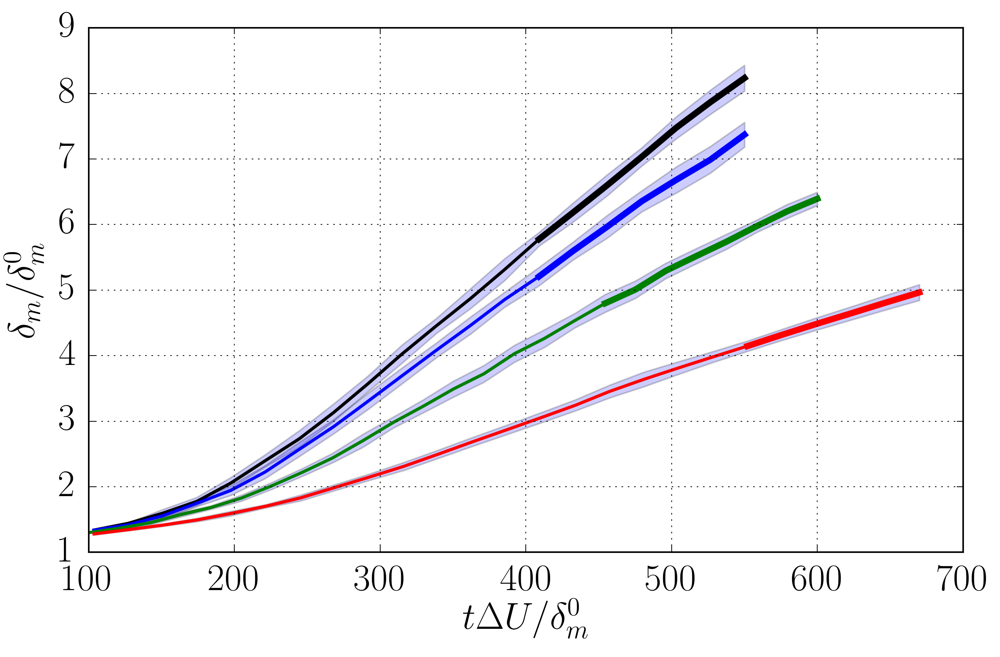

In [2435]:
figname = 'dmvstime_ave'
ylabel = r'$\delta_m/\delta_m^0$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase][variable],'-',color=l_case_color[icase],lw=2.0)
    ax.plot(vtcases[icase][ivtmin[icase]:],mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0)
    plt.fill_between(vtcases[icase],mydict[icase][variable]+mydict[icase][variable+'std']\
                    , mydict[icase][variable]-mydict[icase][variable+'std'],alpha=0.2)
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

figure saved at /share/drive/toni/VDML/JFM_joint/dmpointvstime_ave.pdf!


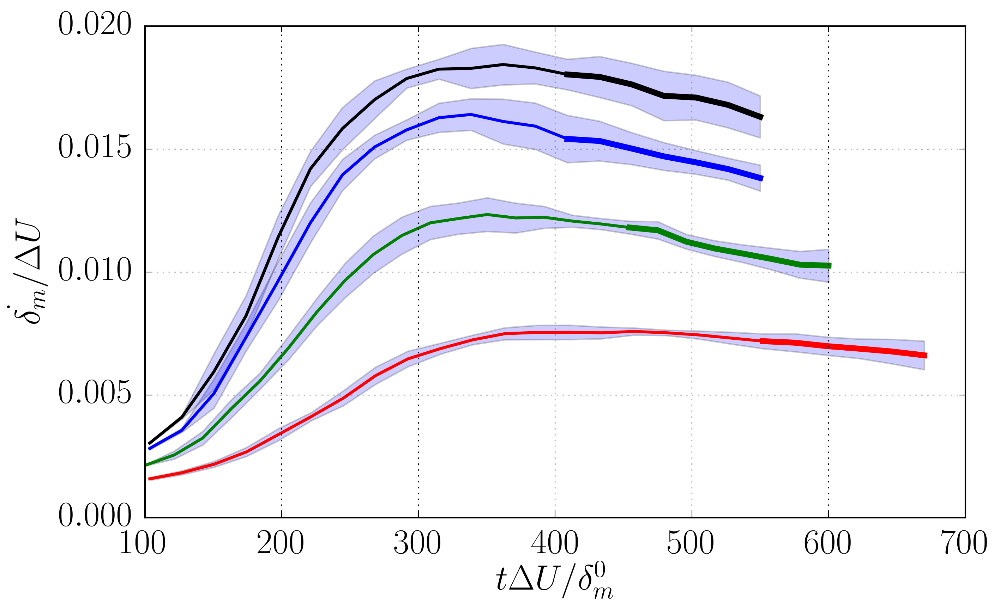

In [2436]:
figname = 'dmpointvstime_ave'
ylabel = r'$\dot{\delta_m}/\Delta U$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'dmpoint'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase][variable],'-',color=l_case_color[icase],lw=2.0)
    ax.plot(vtcases[icase][ivtmin[icase]:],mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0)
    plt.fill_between(vtcases[icase],mydict[icase][variable]+mydict[icase][variable+'std']\
                    , mydict[icase][variable]-mydict[icase][variable+'std'],alpha=0.2)
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Turnover times = 15.588600639
Turnover times = 10.7420574501
Turnover times = 13.6210183737
Turnover times = 13.0768605854
figure saved at /share/drive/toni/VDML/JFM_joint/dwvstime_ave.pdf!


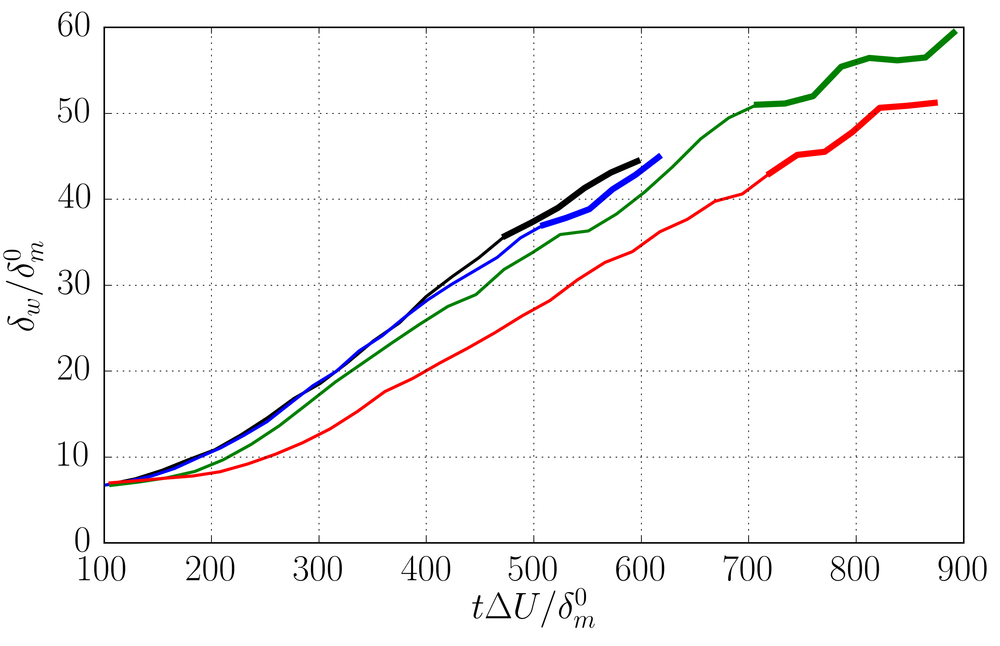

In [2373]:
figname = 'dwvstime_ave'
ylabel = r'$\delta_w/\delta_m^0$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase][variable],'-',color=l_case_color[icase],lw=2.0)
    ax.plot(vtcases[icase][ivtmin[icase]:],mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0) 
    print "Turnover times = %s"% (len(lcases[icase])*(vtcases[icase][-1]-vtcases[icase][ivtmin[icase]])/((mydict[icase][variable][ivtmin[icase]]+mydict[icase][variable][-2])/2))
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Max Redw = 6897.62368488
Max Redw = 6855.76305031
Max Redw = 9040.45816792
Max Redw = 8141.70999135
figure saved at /share/drive/toni/VDML/JFM_joint/Redwvstime_ave.pdf!


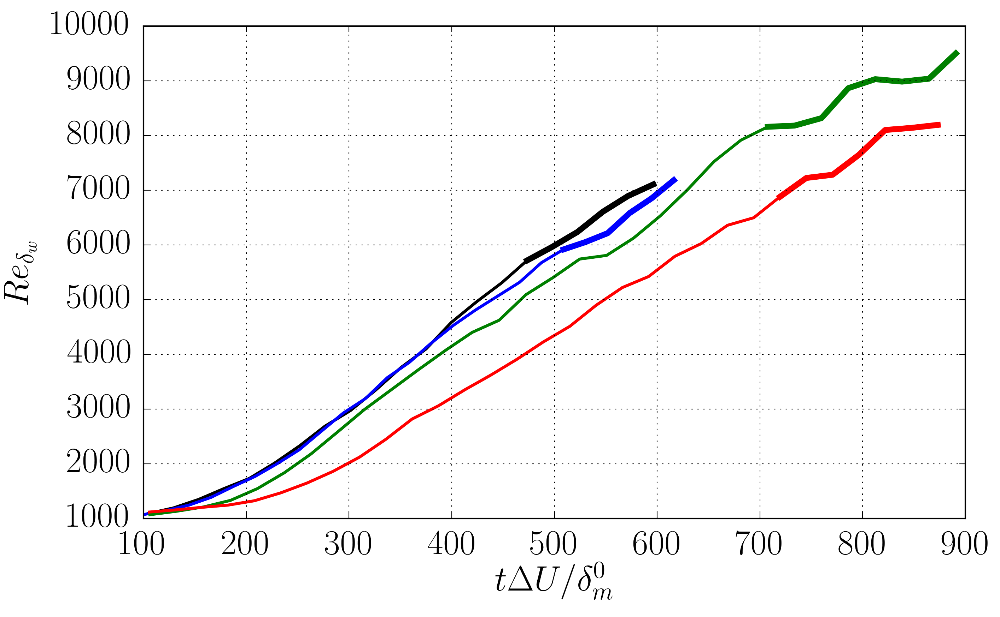

In [2374]:
figname = 'Redwvstime_ave'
ylabel = r'$Re_{\delta_w}$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
for icase in range(ncases):
    plt.plot(vtcases[icase],160*mydict[icase][variable],'-',color=l_case_color[icase],lw=2.0)
    ax.plot(vtcases[icase][ivtmin[icase]:],160*mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0) 
    print "Max Redw = %s"%(160*mydict[icase][variable][-2])
    #print "Turnover times = %s"%(3*(vtcases[icase][-1]-vtcases[icase][ivtmin[icase]])/mydict[icase][variable][ivtmin[icase]])
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Max Relambda= 159.359260044
Max Relambda= 145.731631063
Max Relambda= 132.371718114
Max Relambda= 100.835485963
figure saved at /share/drive/toni/VDML/JFM_joint/Relambdavstime_ave.pdf!


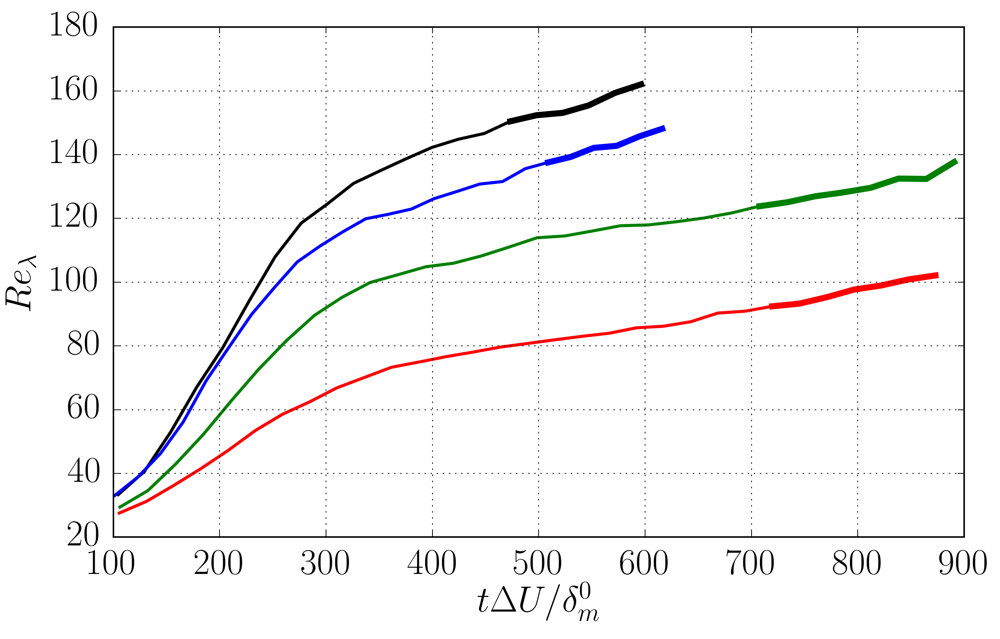

In [2375]:
figname = 'Relambdavstime_ave'
ylabel = r'$Re_{\lambda}$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'Relambda'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase][variable],'-',color=l_case_color[icase],lw=2.0)
    ax.plot(vtcases[icase][ivtmin[icase]:],mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0) 
    print "Max Relambda= %s"%(mydict[icase][variable][-2])
    #print "Turnover times = %s"%(3*(vtcases[icase][-1]-vtcases[icase][ivtmin[icase]])/mydict[icase][variable][ivtmin[icase]])
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

figure saved at /share/drive/toni/VDML/JFM_joint/epsvstime_ave.pdf!


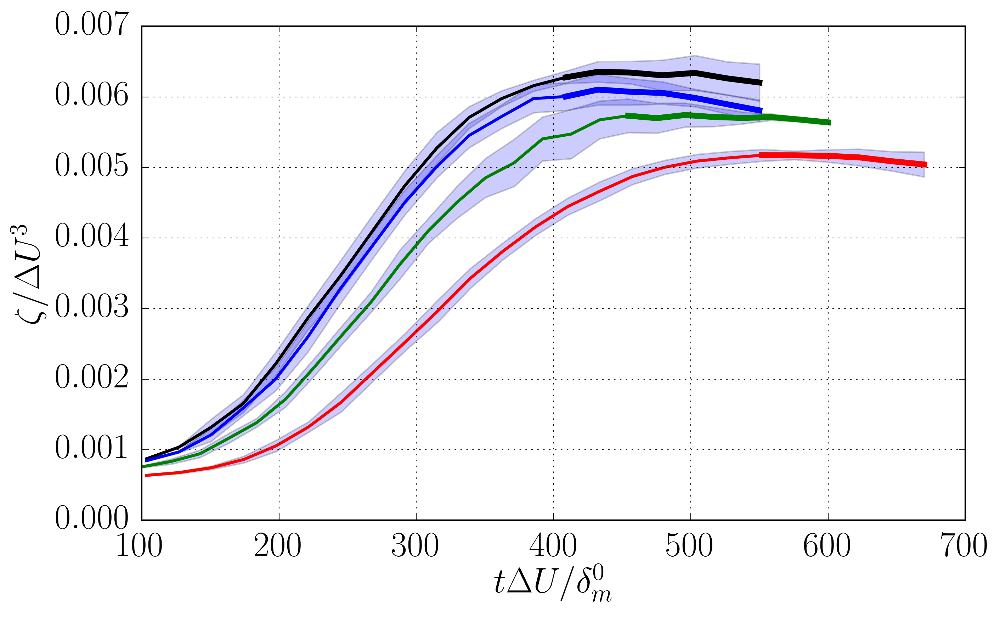

In [2437]:
figname = 'epsvstime_ave'
ylabel = r'$\zeta/\Delta U^3$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'EPS'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase][variable],'-',color=l_case_color[icase],lw=2.0)
    ax.plot(vtcases[icase][ivtmin[icase]:],mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0)
    plt.fill_between(vtcases[icase],mydict[icase][variable]+mydict[icase][variable+'std']\
                    , mydict[icase][variable]-mydict[icase][variable+'std'],alpha=0.2)
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

figure saved at /share/drive/toni/VDML/JFM_joint/dyetamax.pdf!


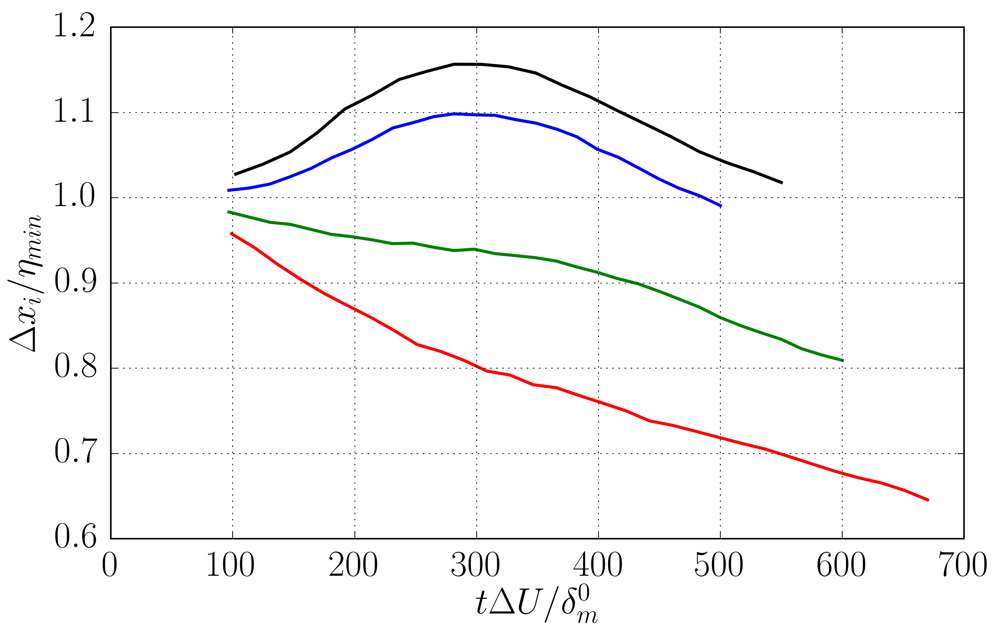

In [2391]:
figname = 'dyetamax'
ylabel = r'$\Delta x_i/\eta_{min}$'
xlabel = r'$t\Delta U/\delta_m^0$'
Debug = False
variable = 'dyeta'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
for icase in range(ncases):
    plt.plot(vtcases[icase],np.nanmax(mydict[icase][variable],axis=0),'-',color=l_case_color[icase],lw=2.0)
    #ax.plot(vtcases[icase][ivtmin[icase]:],mydict[icase][variable][ivtmin[icase]:],l_case_style[icase],lw=4.0) 
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')

if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

IndexError: index 0 is out of bounds for axis 0 with size 0

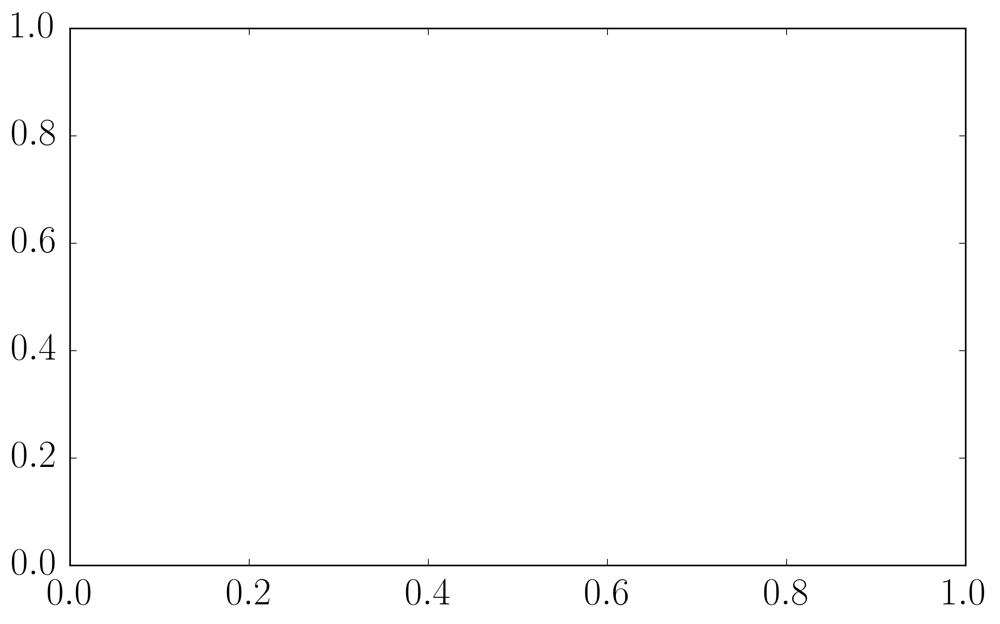

In [2467]:
fformat='.pdf'
scase =2
icase=1
variable='R33'
PRINT=True
figname = variable+'contours%srun'%(scase)
scaling = 'dwe'
#jlist = [0,1,2] #s=1
#jlist= [3,4,5] #s=2
#jlist= [2] #s=8
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
t1 = 100; t2 =840; 
scaling = 'dm'
derivative= False
Ntimes=21; ny = 500;
pcmatrix = np.zeros([ny,Ntimes])
tvec = np.linspace(t1,t2,Ntimes)
delta = np.array(mydict[icase][scaling])
time = vtcases[icase]
fun   = np.array(mydict[icase][variable])
y=vy[icase]
for i in range(Ntimes-1):
    yxi,f,ef = getSSprofile(time,y,delta,fun,variable,tvec[i],tvec[i+1])
        #yxi, f, ef = getSSprofile(path,variable,tvec[i],tvec[i+1],scaling, ny)
    pcmatrix[:,i] = pcmatrix[:,i] + f

        
NC=20
plt.pcolor(tvec,yxi,pcmatrix,vmin=0)
#plt.contourf(tvec,yxi,pcmatrix,np.linspace(np.min(pcmatrix),np.max(pcmatrix),NC))
plt.ylim([-5,10])
plt.ylabel(r'$y/\delta_m$')
plt.xlabel(r'$\tau$')
plt.grid('on')
plt.colorbar()
stitle="%s s=%s averaged" % (variable,scase)
plt.title(stitle)
PRINT = False
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')

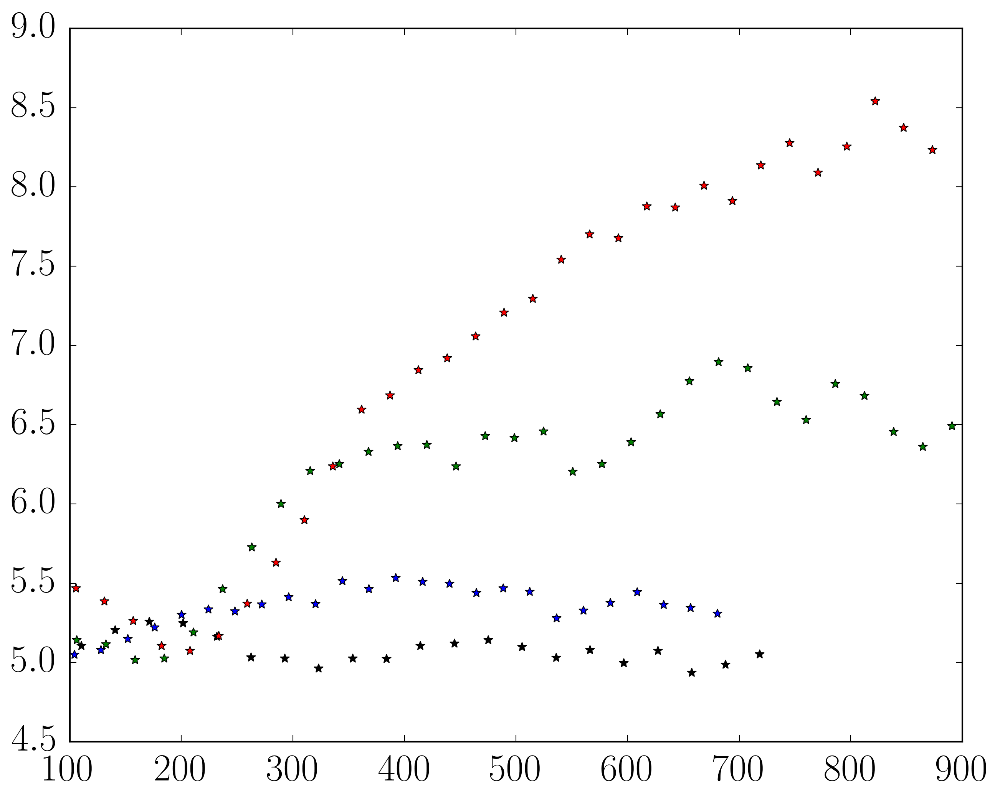

In [2348]:
Debug = False
variable = 'dwe'
variable2 = 'dme'
for icase in range(ncases):
    plt.plot(vtcases[icase],mydict[icase][variable]/mydict[icase][variable2],'*',color=l_case_color[icase])

    

/share/drive/toni/VDML/JFM_joint/SSR22all.pdf


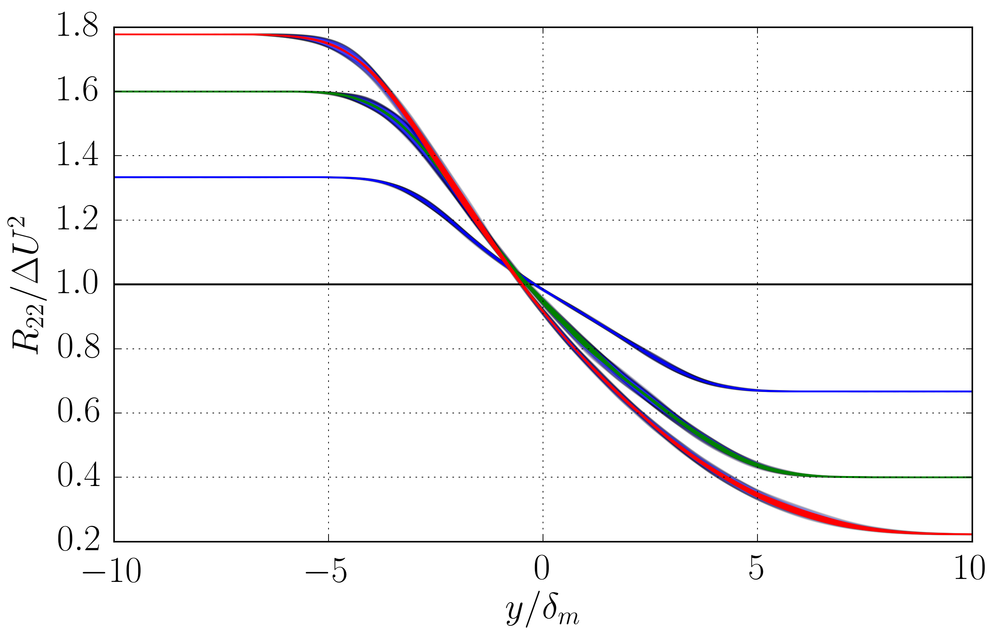

In [2446]:
PRINT = True
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
xlabel = r'$y/\delta_m$'
ylabel = r'$R_{22}/\Delta U^2$'
figname = 'SSR22all'
Debug = False
variable = 'rhom'
for icase in range(ncases):
    itmin = np.where(vtcases[icase]>SS1[icase])[0][0]
    for it in range(itmin,len(vtcases[icase])):
        plt.plot(vy[icase]/mydict[icase]['dm'][it],mydict[icase][variable][:,it],color=l_case_color[icase])
        plt.fill_between(vy[icase]/mydict[icase]['dm'][it],mydict[icase][variable][:,it]+mydict[icase][variable+'std'][:,it]\
                    , mydict[icase][variable][:,it]-mydict[icase][variable+'std'][:,it],alpha=0.2)
plt.xlim([-10,10])
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')


/share/drive/toni/VDML/JFM_joint/SSR22all.pdf


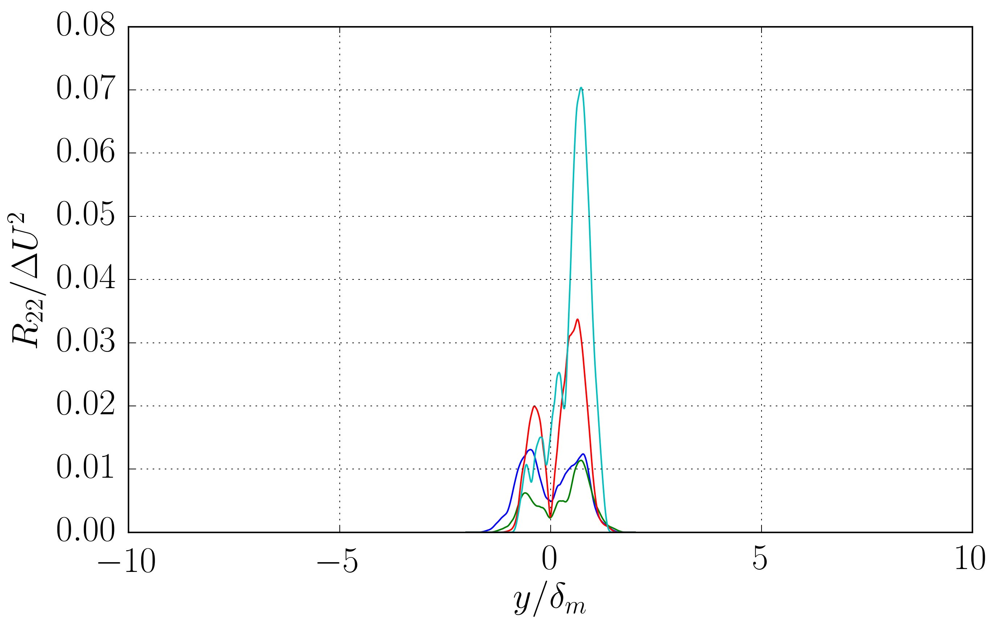

In [2490]:
PRINT = True
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
xlabel = r'$y/\delta_m$'
ylabel = r'$R_{22}/\Delta U^2$'
figname = 'SSR22all'
Debug = False
variable = 'Tmstd'

for icase in range(ncases):
    itmin = np.where(vtcases[icase]>SS1[icase])[0][0]
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun)
    #for it in range(itmin,len(vtcases[icase])):
    #    plt.plot(vy[icase]/mydict[icase]['dm'][it],mydict[icase][variable][:,it],color=l_case_color[icase])
        #plt.fill_between(vy[icase]/mydict[icase]['dm'][it],mydict[icase][variable][:,it]+mydict[icase][variable+'std'][:,it]\
        #            , mydict[icase][variable][:,it]-mydict[icase][variable+'std'][:,it],alpha=0.2)
plt.xlim([-10,10])
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.grid('on')
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')


# Mean PROFILES

In [2394]:
#plt.plot(s80['y'],s80['rho'])
s80.keys()

['rhos', '__header__', '__globals__', 'dUdy', 'Vs', 'U', 'y', '__version__']

figure saved at /share/drive/toni/VDML/JFM_joint/rhom_dm_ave.pdf!


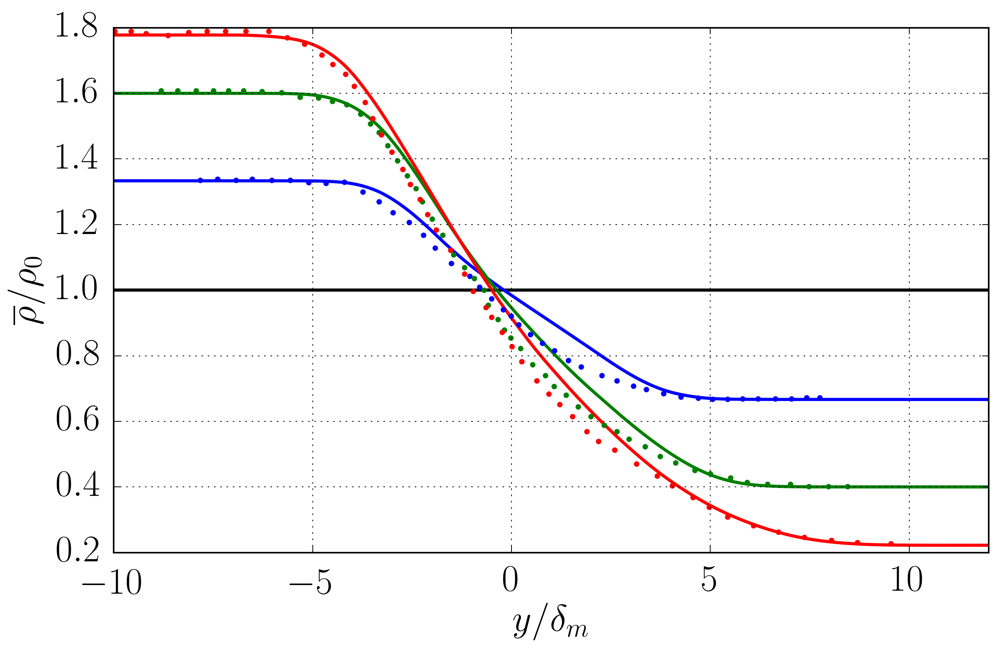

In [2460]:
figname = 'rhom_dm_ave'
ylabel = r'$\overline{\rho}/\rho_0$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'rhom'

for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    funstd   = np.array(mydict[icase][variable+'std'])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun2 = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    yxi,funstd2,efun2 = getSSprofile(time,y,delta,funstd,variable+'std',SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)

    plt.fill_between(yxi, (fun+funstd2), fun-funstd2,alpha=0.2)
    
#plt.plot(rhos20pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
plt.plot(rhos20pantano[:,0],rhos20pantano[:,1],'.',color=l_case_color[1])
plt.plot(rhos40pantano[:,0],rhos40pantano[:,1],'.',color=l_case_color[2])
plt.plot(rhos80pantano[:,0],rhos80pantano[:,1],'.',color=l_case_color[3])
#plt.plot(s80['y'],s80['rhos'],'--',color=l_case_color[3])
plt.xlim([-10,12])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

figure saved at /share/drive/toni/VDML/JFM_joint/rum_dm_ave.pdf!


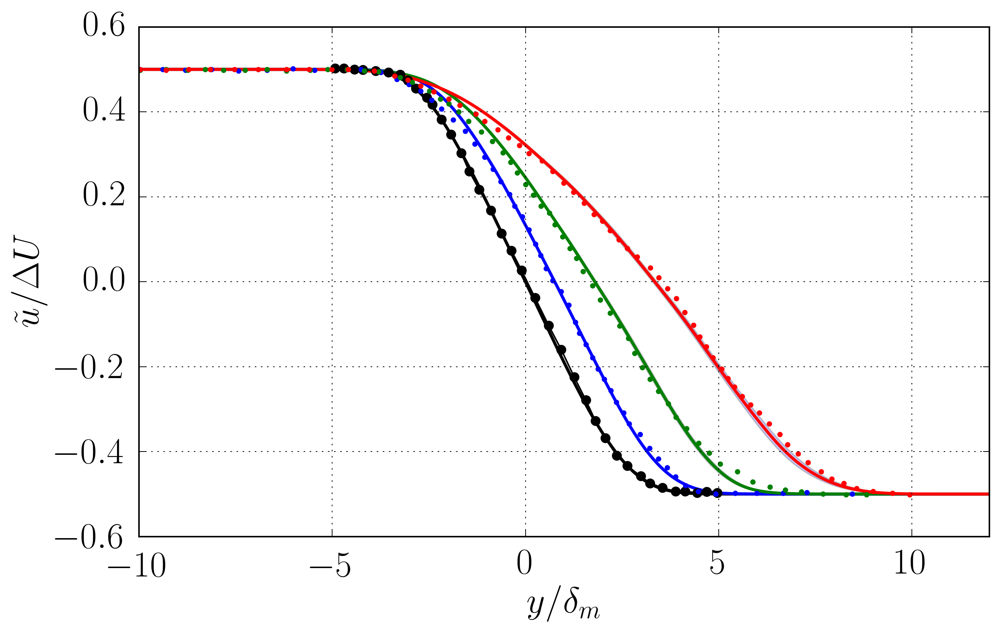

In [2461]:
figname = 'rum_dm_ave'
ylabel = r'$\tilde{u}/\Delta U$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'rum'

for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])/np.array(mydict[icase]['rhom'])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    
plt.plot(UselfRM[:,0],-UselfRM[:,1],'-o',color=l_case_color[0])
plt.plot(ums20pantano[:,0],ums20pantano[:,1],'.',color=l_case_color[1])
plt.plot(ums40pantano[:,0],ums40pantano[:,1],'.',color=l_case_color[2])
plt.plot(ums80pantano[:,0],ums80pantano[:,1],'.',color=l_case_color[3])    
plt.xlim([-10,12])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 2.34106475373  for case 0
Relative dispersion is 2.71247878819  for case 1
Relative dispersion is 2.61863255934  for case 2
Relative dispersion is 4.19520255786  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R11_dm_ave.pdf!


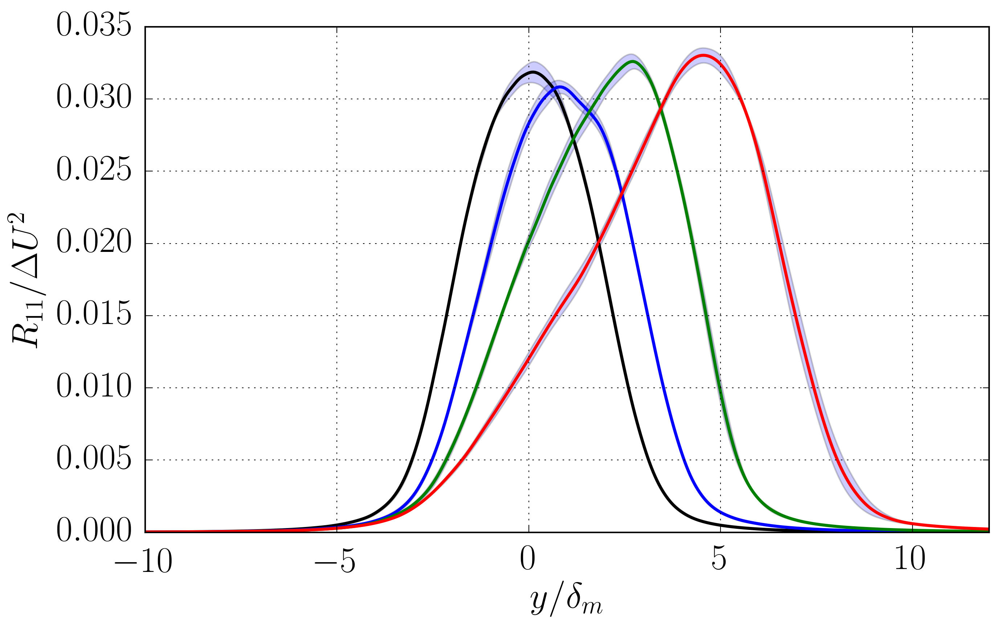

In [2462]:
figname = 'R11_dm_ave'
ylabel = r'$R_{11}/\Delta U^2$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R11'
#urmsRM
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
plt.xlim([-10,12])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 2.31507496687  for case 0
Relative dispersion is 2.62090938183  for case 1
Relative dispersion is 5.30297803966  for case 2
Relative dispersion is 2.61225363521  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R11_dw_ave.pdf!


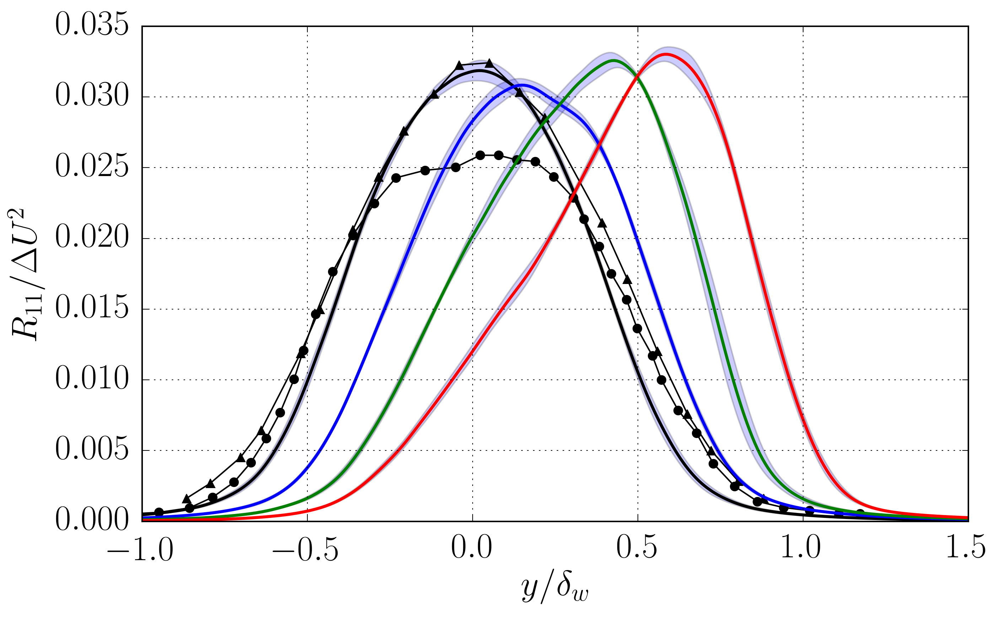

In [2468]:
figname = 'R11_dw_ave'
ylabel = r'$R_{11}/\Delta U^2$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R11'
plt.plot(urmsRM[:,0]/4.2,urmsRM[:,1],'-o',color='k')
plt.plot(R11BM[:,0],R11BM[:,1]**2,'-^',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
plt.xlim([-1,1.5])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

figure saved at /share/drive/toni/VDML/JFM_joint/R22_dm_ave.pdf!


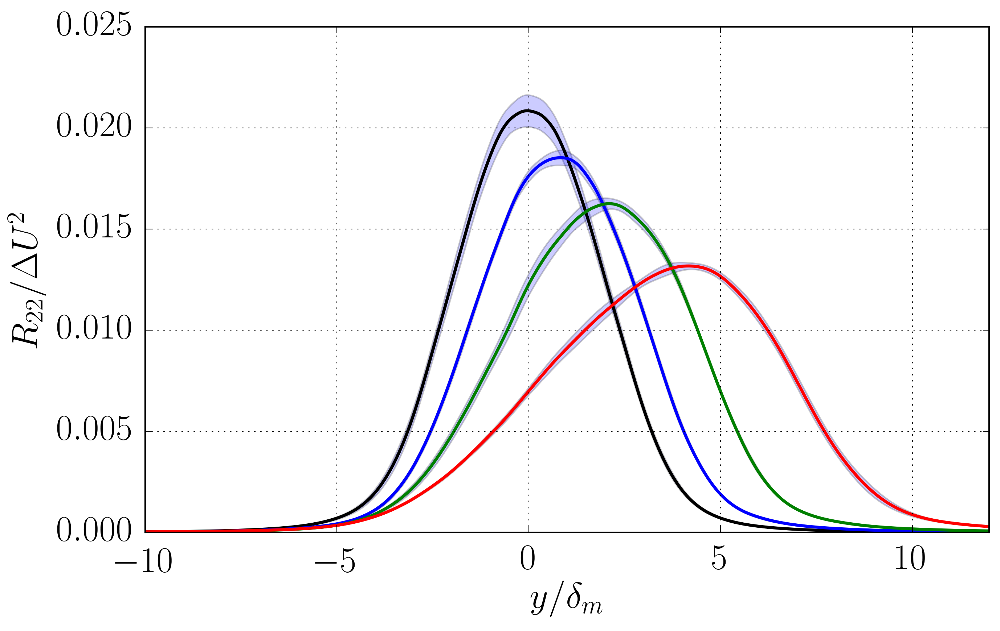

In [2399]:
figname = 'R22_dm_ave'
ylabel = r'$R_{22}/\Delta U^2$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R22'
#plt.plot(urmsRM[:,0]/4.2,urmsRM[:,1],'-o',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
plt.xlim([-10,12])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 3.37448033396  for case 0
Relative dispersion is 3.06811125535  for case 1
Relative dispersion is 3.65221019325  for case 2
Relative dispersion is 2.36660598961  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R22_dw_ave.pdf!


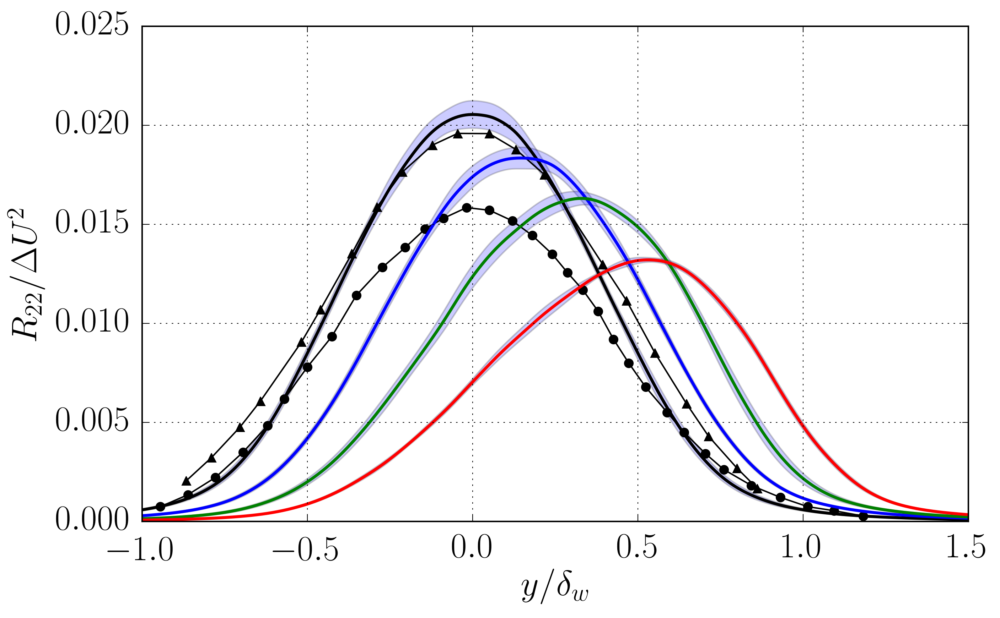

In [2469]:
figname = 'R22_dw_ave'
ylabel = r'$R_{22}/\Delta U^2$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R22'
plt.plot(vrmsRM[:,0]/4.2,vrmsRM[:,1],'-o',color='k')
plt.plot(R22BM[:,0],R22BM[:,1]**2,'-^',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
plt.xlim([-1,1.5])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 4.52546003127  for case 0
Relative dispersion is 3.47093779411  for case 1
Relative dispersion is 3.5841188677  for case 2
Relative dispersion is 3.6717232545  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R33_dm_ave.pdf!


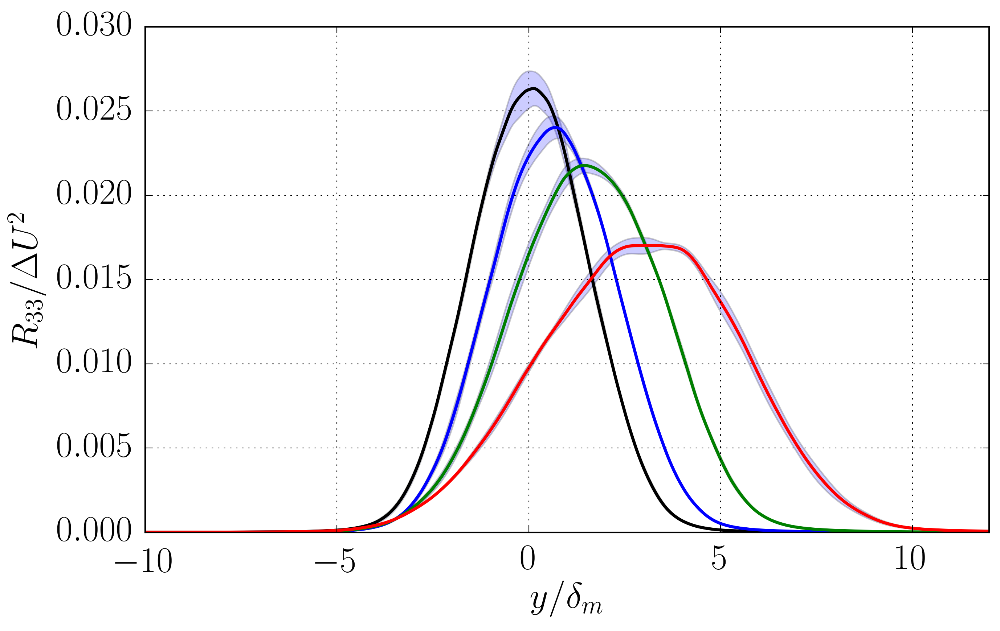

In [2470]:
figname = 'R33_dm_ave'
ylabel = r'$R_{33}/\Delta U^2$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R33'
#plt.plot(vrmsRM[:,0]/4.2,vrmsRM[:,1],'-o',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
plt.xlim([-10,12])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 4.49519606414  for case 0
Relative dispersion is 3.49497161349  for case 1
Relative dispersion is 3.47863172878  for case 2
Relative dispersion is 2.77701776223  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R33_dw_ave.pdf!


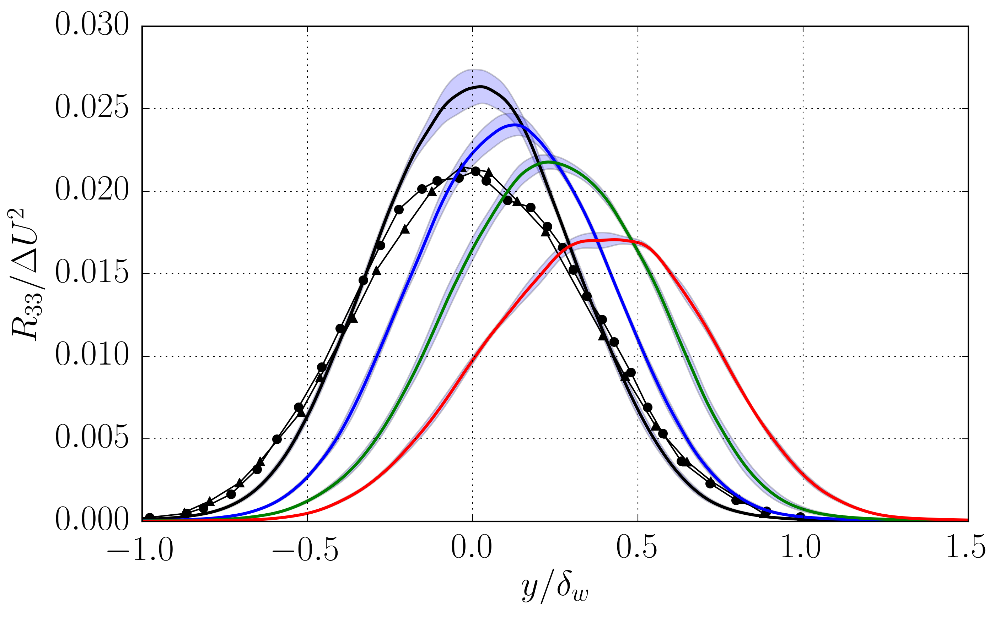

In [2471]:
figname = 'R33_dw_ave'
ylabel = r'$R_{33}/\Delta U^2$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R33'
plt.plot(wrmsRM[:,0]/4.2,wrmsRM[:,1],'-o',color='k')
plt.plot(R33BM[:,0],R33BM[:,1]**2,'-^',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
plt.xlim([-1,1.5])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 3.53953073904  for case 0
Relative dispersion is 3.12176312668  for case 1
Relative dispersion is 5.10808613006  for case 2
Relative dispersion is 3.59402805947  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R12_dm_ave.pdf!


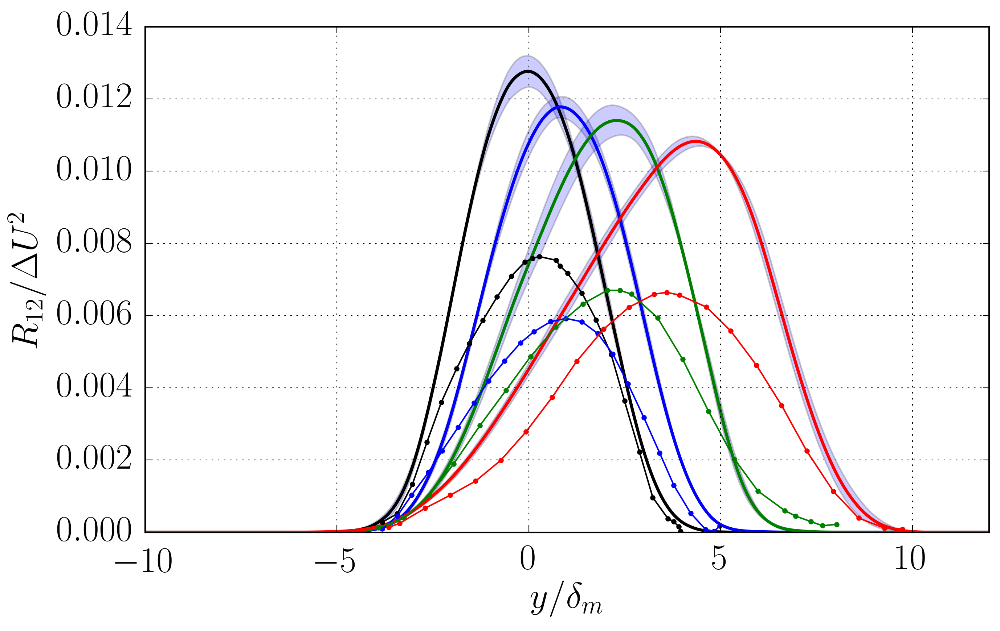

In [2472]:
figname = 'R12_dm_ave'
ylabel = r'$R_{12}/\Delta U^2$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R12'
#plt.plot(R12BM[:,0],R12BM[:,1]**2,'-^',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-10,12])
plt.ylim(bottom=0.0)
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Relative dispersion is 2.80140940934  for case 0
Relative dispersion is 2.92066036777  for case 1
Relative dispersion is 5.10221155458  for case 2
Relative dispersion is 2.23833667455  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/R12_dw_ave.pdf!


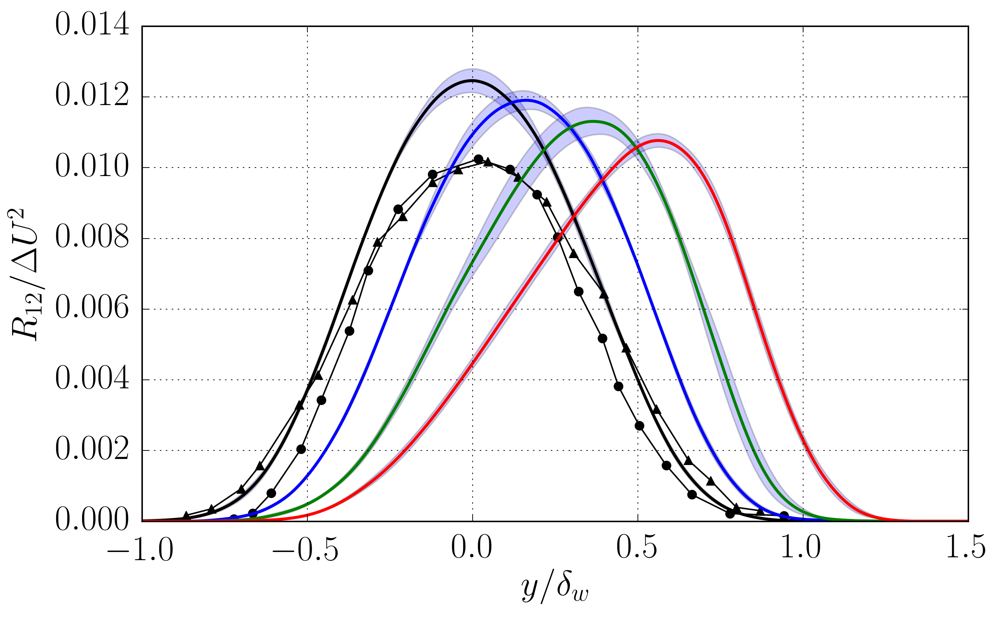

In [2404]:
figname = 'R12_dw_ave'
ylabel = r'$R_{12}/\Delta U^2$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'R12'
plt.plot(R12RM[:,0],R12RM[:,1]**2,'-o',color='k')
plt.plot(R12BM[:,0],R12BM[:,1]**2,'-^',color='k')
for icase in range(ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase])
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-1,1.5])
plt.ylim(bottom=0.0)
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

In [2473]:
print SS1

[400, 400, 450, 550]


0.666666671639
Taking derivative and multiplying by scaling
Relative dispersion is 2.60642738323  for case 1
1.20000000895
Taking derivative and multiplying by scaling
Relative dispersion is 3.63859218032  for case 2
1.55555556715
Taking derivative and multiplying by scaling
Relative dispersion is 3.89733430734  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/drhomdy_dm_ave.pdf!


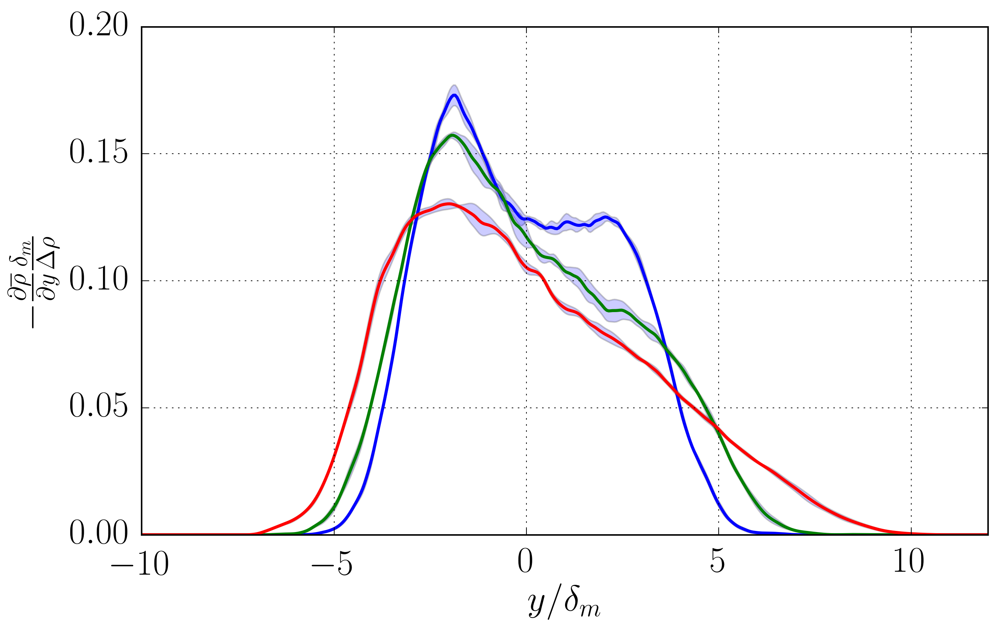

In [2474]:
figname = 'drhomdy_dm_ave'
ylabel = r'$-\frac{\partial \overline{\rho}}{\partial y}\frac{\delta_m}{\Delta \rho}$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'rhom'
derivative = True

for icase in range(1,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    Drho = np.nanmax(fun[:,1])-np.nanmin(fun[:,1])
    print Drho
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase],500,derivative)
    fun = -fun / Drho
    efun = efun/Drho
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-10,12])
plt.ylim(bottom=0.0)
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Taking derivative and multiplying by scaling
Relative dispersion is 3.85995605306  for case 0
Taking derivative and multiplying by scaling
Relative dispersion is 2.32396238308  for case 1
Taking derivative and multiplying by scaling
Relative dispersion is 3.09487687102  for case 2
Taking derivative and multiplying by scaling
Relative dispersion is 4.73361525273  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/dumdy_dm_ave.pdf!


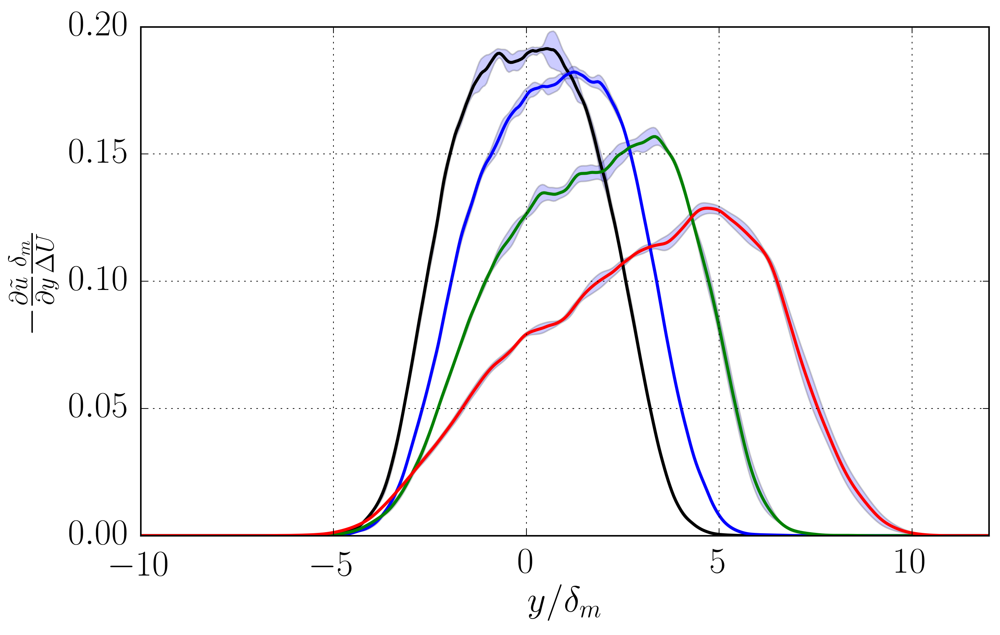

In [2475]:
figname = 'dumdy_dm_ave'
ylabel = r'$-\frac{\partial \tilde{u}}{\partial y}\frac{\delta_m}{\Delta U}$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'rum'
derivative = True

for icase in range(0,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])/np.array(mydict[icase]['rhom'])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase],500,derivative)
    fun = -fun 
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-10,12])
plt.ylim([0,0.20])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

0.75
Taking derivative and multiplying by scaling
Relative dispersion is 2.80808426564  for case 1
1.875
Taking derivative and multiplying by scaling
Relative dispersion is 3.92895930171  for case 2
3.9375
Taking derivative and multiplying by scaling
Relative dispersion is 2.92475235211  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/drhomdy_dw_ave.pdf!


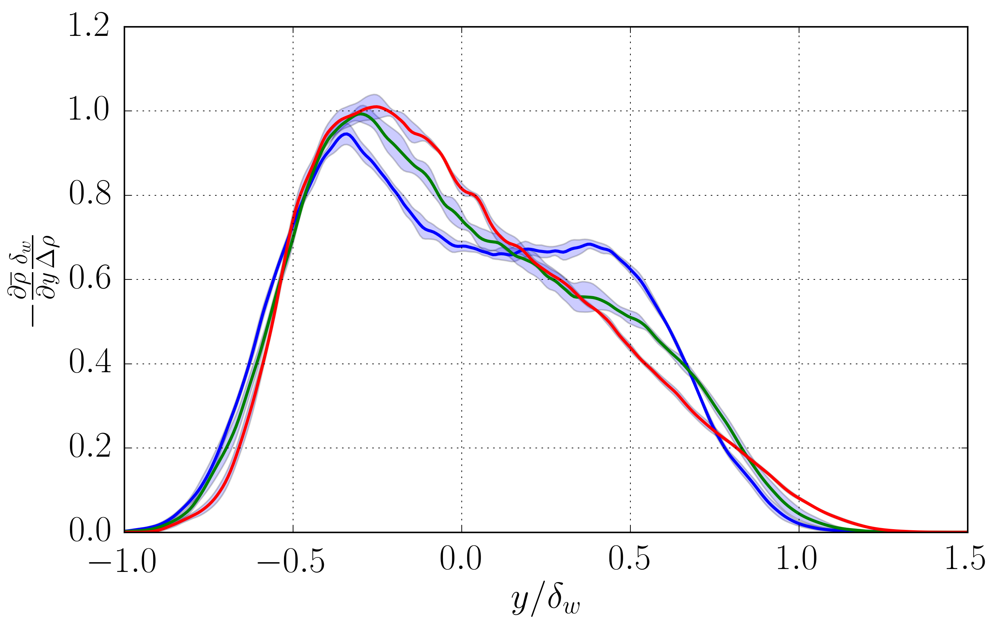

In [2476]:
figname = 'drhomdy_dw_ave'
ylabel = r'$-\frac{\partial \overline{\rho}}{\partial y}\frac{\delta_w}{\Delta \rho}$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'rhom'
derivative = True

for icase in range(1,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    Drho =fun[0,1]-fun[-1,1]
    DTT =np.array(mydict[icase]['Tm'])[-1,1]-np.array(mydict[icase]['Tm'])[0,1]
    print DTT
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase],500,derivative)
    fun = -fun / Drho
    efun = efun/Drho
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-1,1.5])
plt.ylim(bottom=0)
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

Taking derivative and multiplying by scaling
Relative dispersion is 4.45978896615  for case 0
Taking derivative and multiplying by scaling
Relative dispersion is 2.72790508691  for case 1
Taking derivative and multiplying by scaling
Relative dispersion is 5.47838384462  for case 2
Taking derivative and multiplying by scaling
Relative dispersion is 2.34967786584  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/dumdy_dw_ave.pdf!


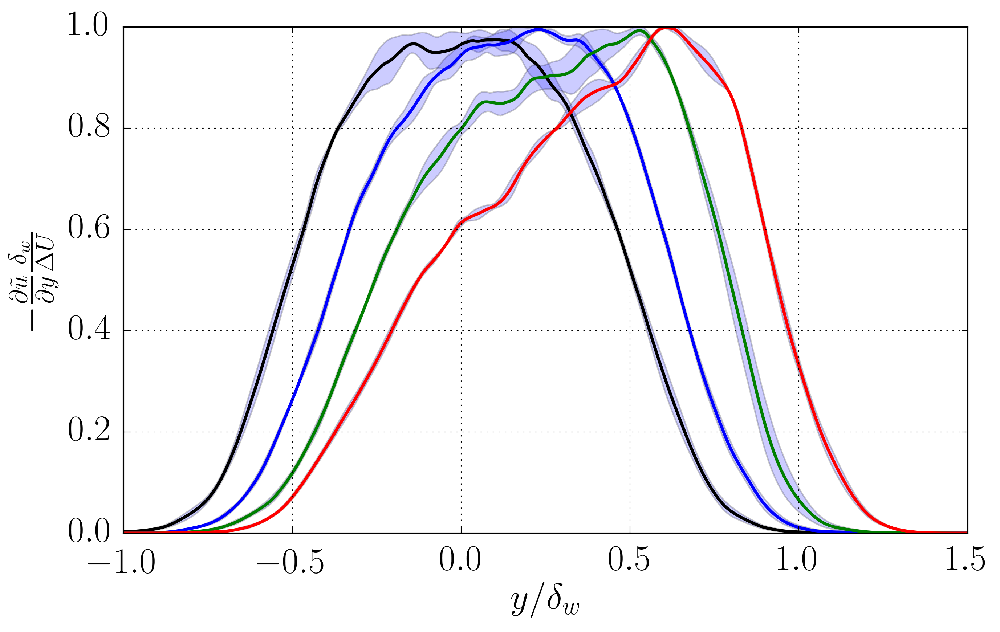

In [2477]:
figname = 'dumdy_dw_ave'
ylabel = r'$-\frac{\partial \tilde{u}}{\partial y}\frac{\delta_w}{\Delta U}$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
variable = 'rum'
derivative = True

for icase in range(0,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])/np.array(mydict[icase]['rhom'])
    time = vtcases[icase]
    y=vy[icase]
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase],500,derivative)
    fun = -fun 
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-1,1.5])
plt.ylim([0,1.0])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

1.0
Relative dispersion is 0.189278809544  for case 0
0.75
Relative dispersion is 0.272605576873  for case 1
1.875
Relative dispersion is 0.286462385801  for case 2
3.9375
Relative dispersion is 0.141107607666  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/theta_dw_ave.pdf!


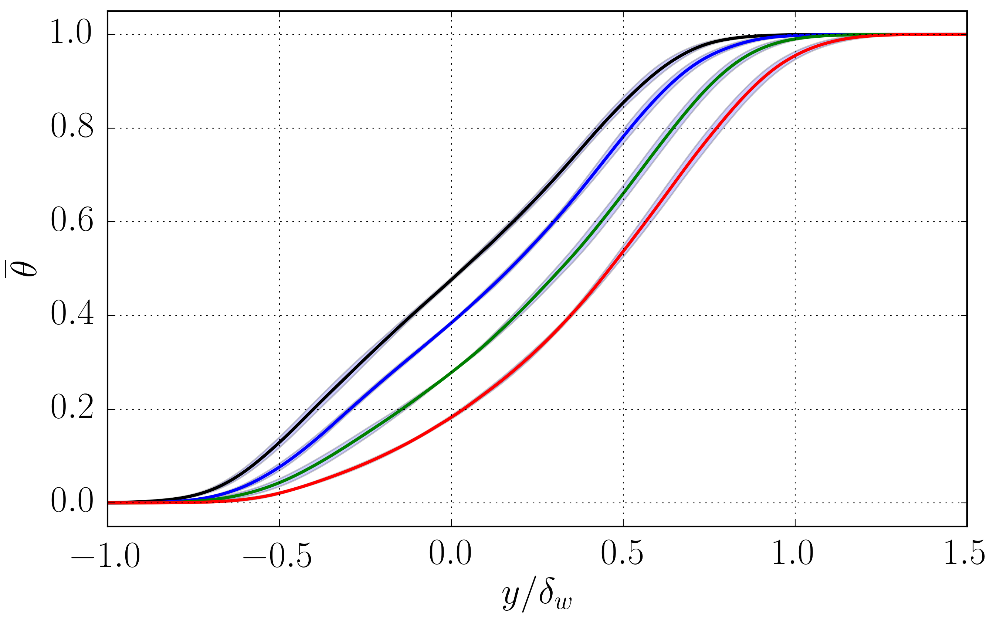

In [2491]:
figname = 'theta_dw_ave'
ylabel = r'$\overline{\theta}$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
PRINT = True
variable = 'Tm'
derivative = False
vDT = [0,0,0,0]
for icase in range(0,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    funstd   = np.array(mydict[icase][variable+'std'])
    time = vtcases[icase]
    y=vy[icase]
    DT = fun[-1,1]-fun[0,1]
    vDT[icase]=DT
    print DT
    fun = (fun - fun[0,1])/DT
    funstd = funstd /DT
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase],500,derivative)
    yxi2,funstd,efun = getSSprofile(time,y,delta,funstd,variable+'std',SS1[icase],tmaxcases[icase],500,derivative)
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+funstd), fun-funstd,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-1,1.5])
plt.ylim([-0.05,1.05])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

1.0
Taking derivative and multiplying by scaling
Relative dispersion is 1.55155142973  for case 0
0.75
Taking derivative and multiplying by scaling
Relative dispersion is 1.25357244324  for case 1
1.875
Taking derivative and multiplying by scaling
Relative dispersion is 3.37985683626  for case 2
3.9375
Taking derivative and multiplying by scaling
Relative dispersion is 6.99481730677  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/dTdy_dw_ave.pdf!


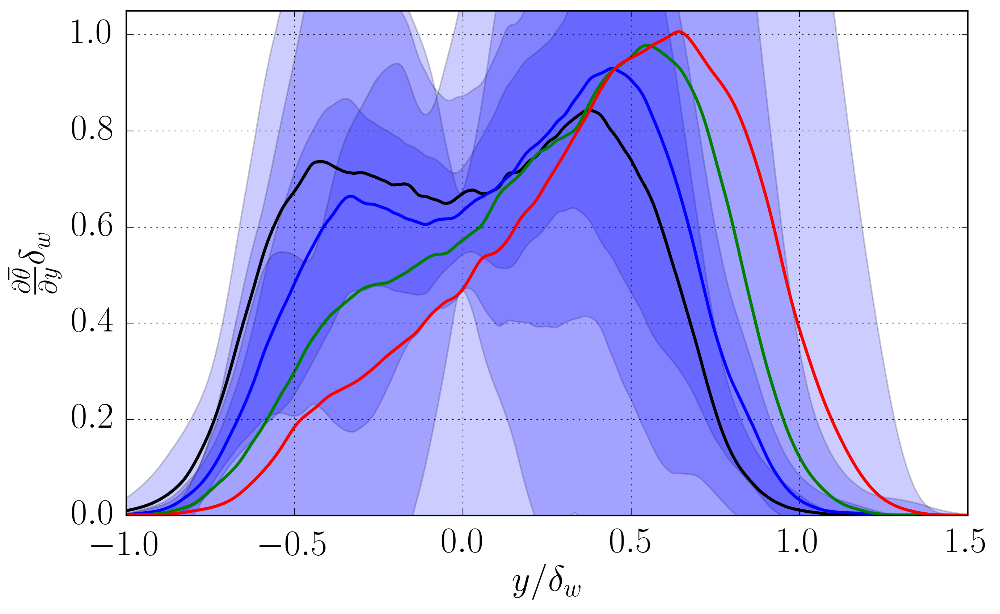

In [2505]:
figname = 'dTdy_dw_ave'
ylabel = r'$\frac{\partial \overline{\theta}}{\partial y} \delta_w$'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
PRINT = True
variable = 'Tm'
derivative = True

for icase in range(0,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    funstd   = np.array(mydict[icase][variable+'std'])
    time = vtcases[icase]
    y=vy[icase]
    DT = vDT[icase]
    print DT
    fun = fun/DT
    funstd/DT
    #print delta
    yxi,fun,efun = getSSprofile2(time,y,delta,fun,funstd,variable,SS1[icase],tmaxcases[icase],500,derivative)
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun*delta[-1]), fun-efun*delta[-1],alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-1,1.5])
plt.ylim([0.0,1.05])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

1.0
Taking derivative and multiplying by scaling
Relative dispersion is 7.93658144556  for case 0
0.75
Taking derivative and multiplying by scaling
Relative dispersion is 6.80620120683  for case 1
1.875
Taking derivative and multiplying by scaling
Relative dispersion is 21.6271268495  for case 2
3.9375
Taking derivative and multiplying by scaling
Relative dispersion is 53.8107106027  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/dTdy_dm_ave.pdf!


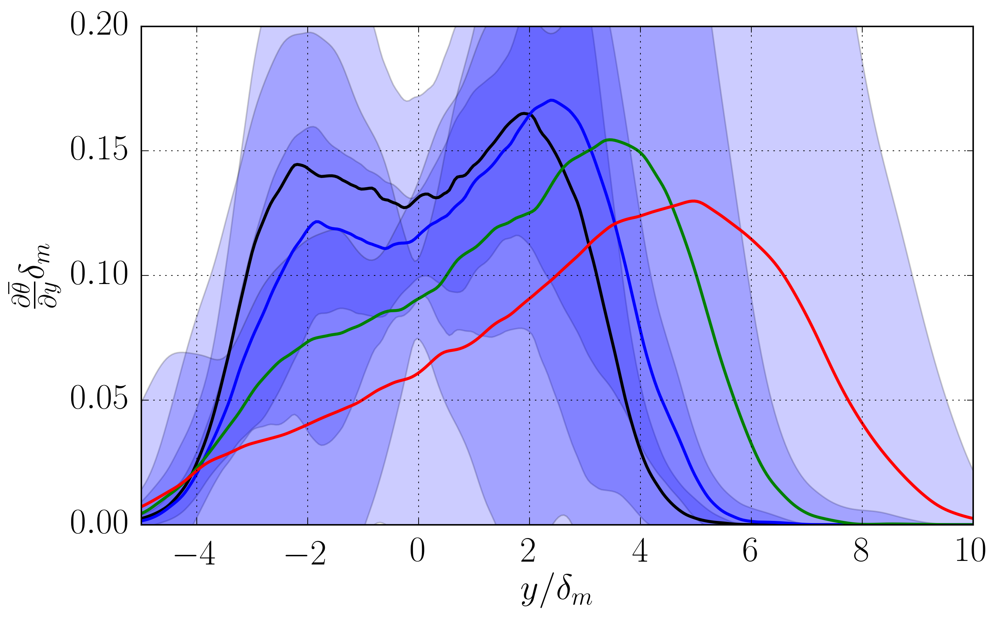

In [2508]:
figname = 'dTdy_dm_ave'
ylabel = r'$\frac{\partial \overline{\theta}}{\partial y} \delta_m$'
xlabel = r'$y/\delta_m$'
scaling = 'dm'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
PRINT = True
variable = 'Tm'
derivative = True

for icase in range(0,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    funstd   = np.array(mydict[icase][variable+'std'])
    time = vtcases[icase]
    y=vy[icase]
    DT = vDT[icase]
    print DT
    fun = fun/DT
    funstd/DT
    #print delta
    yxi,fun,efun = getSSprofile2(time,y,delta,fun,funstd,variable,SS1[icase],tmaxcases[icase],500,derivative)
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun*delta[-1]), fun-efun*delta[-1],alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-5,10])
plt.ylim([0.0,0.2])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

1.0
Relative dispersion is 3.25247066885  for case 0
0.75
Relative dispersion is 5.26692981992  for case 1
1.875
Relative dispersion is 6.40331725136  for case 2
3.9375
Relative dispersion is 4.76985309649  for case 3
figure saved at /share/drive/toni/VDML/JFM_joint/Trms_dw_ave.pdf!


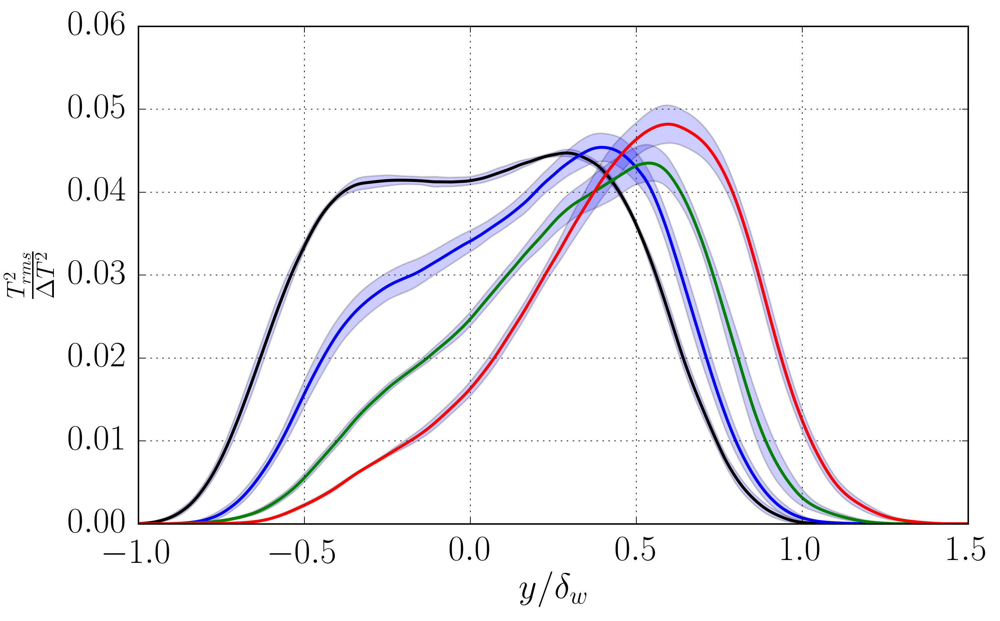

In [2281]:
figname = 'Trms_dw_ave'
ylabel = r'$\frac{T_{rms}^2}{\Delta T^2} $'
xlabel = r'$y/\delta_w$'
scaling = 'dwe'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Debug = False
PRINT = True
variable = 'Trms'
derivative = False

for icase in range(0,ncases):
    delta = np.array(mydict[icase][scaling])
    fun   = np.array(mydict[icase][variable])
    time = vtcases[icase]
    y=vy[icase]
    DT = vDT[icase]
    print DT
    fun = fun**2/DT**2
    #print delta
    yxi,fun,efun = getSSprofile(time,y,delta,fun,variable,SS1[icase],tmaxcases[icase],500,derivative)
    plt.plot(yxi,fun,color=l_case_color[icase],lw=2.0)
    plt.fill_between(yxi, (fun+efun), fun-efun,alpha=0.2)
    print "Relative dispersion is %s  for case %s"%(efun.max()/fun.max()*100,icase)
#plt.plot(R12s1pantano[:,0],R12s1pantano[:,1],'.-',color=l_case_color[0])
#plt.plot(R12s2pantano[:,0],R12s2pantano[:,1],'.-',color=l_case_color[1])
#plt.plot(R12s4pantano[:,0],R12s4pantano[:,1],'.-',color=l_case_color[2])
#plt.plot(R12s8pantano[:,0],R12s8pantano[:,1],'.-',color=l_case_color[3])
plt.xlim([-1,1.5])
plt.ylim([0.0,0.06])
plt.grid('on')
plt.xlabel(xlabel);plt.ylabel(ylabel)
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

In [2503]:
def getSSprofile2(time,y,delta,fun,funstd,variable,tmin,tmax,Npoints=500,derivative=False):
    """
    Obtain SS profile averaged in the given time
    """
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
       
    lim = 12.0;
    if np.max(y/delta[it2-1])<lim:
        lim = 2
    ydelta = np.linspace(-lim,lim,Npoints)
    funintcum = np.zeros(Npoints);
    fyjob = np.zeros(Npoints)
    fyjob2 = np.zeros(Npoints)
    count = 0
    for itime in range(it1,it2):
        dd = delta[itime]
        if derivative == True:
            funint = np.interp(ydelta,y/dd,dd*der1(y,fun[:,itime]))
            funstdint = np.interp(ydelta,y/dd,funstd[:,itime])
            if itime==it1:
                print "Taking derivative and multiplying by scaling"
        else:
            if variable=='w3m' or variable[0:2] =='ep':
                funint = np.interp(ydelta,y/dd,dd*fun[:,itime])
                funstdint = np.interp(ydelta,y/dd,funstd[:,itime])
                if itime==it1: #First time
                    print "Multiplying by scaling"
            else:
                funint = np.interp(ydelta,y/dd,fun[:,itime])
                funstdint = np.interp(ydelta,y/dd,funstd[:,itime])
        if np.isnan(np.sum(funint))==False:
            fyjob = fyjob + funint
            #fyjob2= fyjob2 + funint**2
            fyjob2 = fyjob2 + funstdint
            count = count+1
    fstd = fyjob2/count
    
    return ydelta,fyjob/count,fstd
#return ydelta,fyjob/count,np.sqrt(fyjob2/count-(fyjob/count)**2)
            

In [2479]:
def getSSprofile(time,y,delta,fun,variable,tmin,tmax,Npoints=500,derivative=False):
    """
    Obtain SS profile averaged in the given time
    """
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
       
    lim = 12.0;
    if np.max(y/delta[it2-1])<lim:
        lim = 2
    ydelta = np.linspace(-lim,lim,Npoints)
    funintcum = np.zeros(Npoints);
    fyjob = np.zeros(Npoints)
    fyjob2 = np.zeros(Npoints)
    count = 0
    for itime in range(it1,it2):
        dd = delta[itime]
        if derivative == True:
            funint = np.interp(ydelta,y/dd,dd*der1(y,fun[:,itime]))
            if itime==it1:
                print "Taking derivative and multiplying by scaling"
        else:
            if variable=='w3m' or variable[0:2] =='ep':
                funint = np.interp(ydelta,y/dd,dd*fun[:,itime])
                if itime==it1: #First time
                    print "Multiplying by scaling"
            else:
                funint = np.interp(ydelta,y/dd,fun[:,itime])
        if np.isnan(np.sum(funint))==False:
            fyjob = fyjob + funint
            fyjob2= fyjob2 + funint**2
            count = count+1
    
    return ydelta,fyjob/count,np.sqrt(fyjob2/count-(fyjob/count)**2)
            

In [2480]:
vdmpoint = []
vDw = []
vs = [1,2,4,8]
for icase in range(ncases):
    vdmpoint.append(unumpy.uarray(np.mean(mydict[icase]['dmpoint'][ivtmin[icase]:-1]),np.std(mydict[icase]['dmpoint'][ivtmin[icase]:-1])))
    vDw.append(unumpy.uarray(np.mean(mydict[icase]['dwe'][ivtmin[icase]:-1]/mydict[icase]['dme'][ivtmin[icase]:-1]),np.std(mydict[icase]['dw'][ivtmin[icase]:-1]/mydict[icase]['dm'][ivtmin[icase]:-1])))
print vDw
print vdmpoint
#mydict[0]['dmpoint'][ivtmin:]

[array(5.100269395917431+/-0.07602061420309762, dtype=object), array(5.45951736231574+/-0.05198086868803114, dtype=object), array(6.330136662088516+/-0.05262566306841061, dtype=object), array(7.762869834387549+/-0.18360080612095947, dtype=object)]
[array(0.01744378275942846+/-0.0004555058337155228, dtype=object), array(0.014852429063530763+/-0.00044516683799153964, dtype=object), array(0.011037313086022063+/-0.0005304487512854668, dtype=object), array(0.006986378239357859+/-0.0001544511537973905, dtype=object)]


In [2481]:
vDw[0:4]

[array(5.100269395917431+/-0.07602061420309762, dtype=object),
 array(5.45951736231574+/-0.05198086868803114, dtype=object),
 array(6.330136662088516+/-0.05262566306841061, dtype=object),
 array(7.762869834387549+/-0.18360080612095947, dtype=object)]

0.036929061584
figure saved at /share/drive/toni/VDML/JFM_joint/dmratio.pdf!


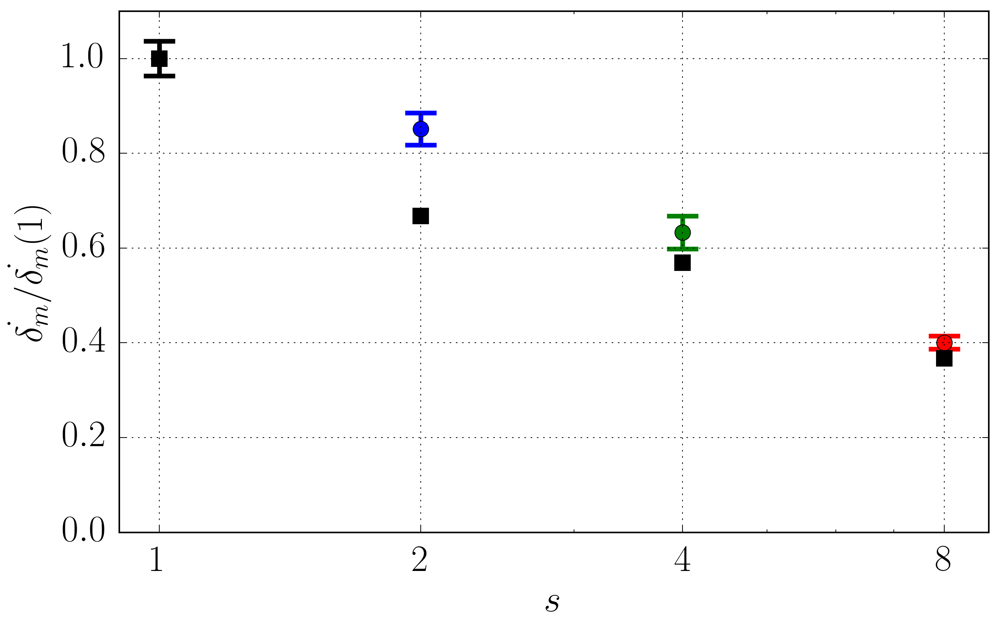

In [2482]:
figname = 'dmratio'
ylabel = r'$\dot{\delta_m}/\dot{\delta_m}(1)$'
xlabel = r'$s$'

fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

vs = np.array(vs)
vs2=np.linspace(1,10,21)
ramshaw = 2*np.sqrt(vs2)/(vs2+1.0)

dwpoint = [0,0,0,0]
dmratio = [0,0,0,0]
Cdelta = [0,0,0,0]
for icase in range(ncases):
    dwpoint[icase] = vdmpoint[icase]/vdmpoint[0]*vDw[icase]/vDw[0]
    dmratio[icase] = vdmpoint[icase]/vdmpoint[0]
    Cdelta[icase]  = 2*vdmpoint[icase]*vDw[icase]
kk = np.zeros(ncases)
kke = np.zeros(ncases)
for icase in range(ncases):
    if icase==0:
        kk[icase]=unumpy.nominal_values(dmratio[icase])
        kke[icase]=np.sqrt(2.0)*unumpy.std_devs(vdmpoint[icase])/unumpy.nominal_values(vdmpoint[icase])
        
    else:
        kk[icase]=unumpy.nominal_values(dmratio[icase])
        kke[icase]=unumpy.std_devs(dmratio[icase])
#plt.plot(vs,unumpy.nominal_values(dwpoint[:]),'*')
for icase in range(0,ncases):
    (_,caps,_) = ax.errorbar(vs[icase],kk[icase],yerr=kke[icase],marker='o',mfc=l_case_color[icase], \
               ms=10.0,color=l_case_color[icase],capsize=10,lw=3.0)
    for cap in caps:
        #cap.set_color('red')
        cap.set_markeredgewidth(3)
#plt.plot(vs, kk,'r^-',lw=2.0,ms=10)
print kke[0]
#plt.plot(vs, kk+kke,'b-')
#plt.plot(vs, kk-kke,'b-')
#plt.fill_between(vs,kk+kke,kk-kke,alpha=0.2)
plt.plot(pantanodotdm[0],pantanodotdm[1],'ks',ms=10)
#plt.plot(vs,fpant,'k^',ms=10)
#plt.plot(vs2,ramshaw,'--')
plt.ylim([0,1.1])
#plt.xlim([0,10])
plt.xscale('log')
plt.xlim([0.9,9])
ax.set_xticks([1,2, 4, 8])
ax.get_xaxis().set_major_formatter(plt.matplotlib.ticker.ScalarFormatter())
plt.xlabel(xlabel)
plt.ylabel(ylabel)

plt.grid('on')
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

[0.1779359827138902+/-0.00535005668303106, 0.1621741886898182+/-0.005100146749079376, 0.1397354004335552+/-0.006815362269299572, 0.10846868977186543+/-0.0035116346083992325]
figure saved at /share/drive/toni/VDML/JFM_joint/ramshaw.pdf!


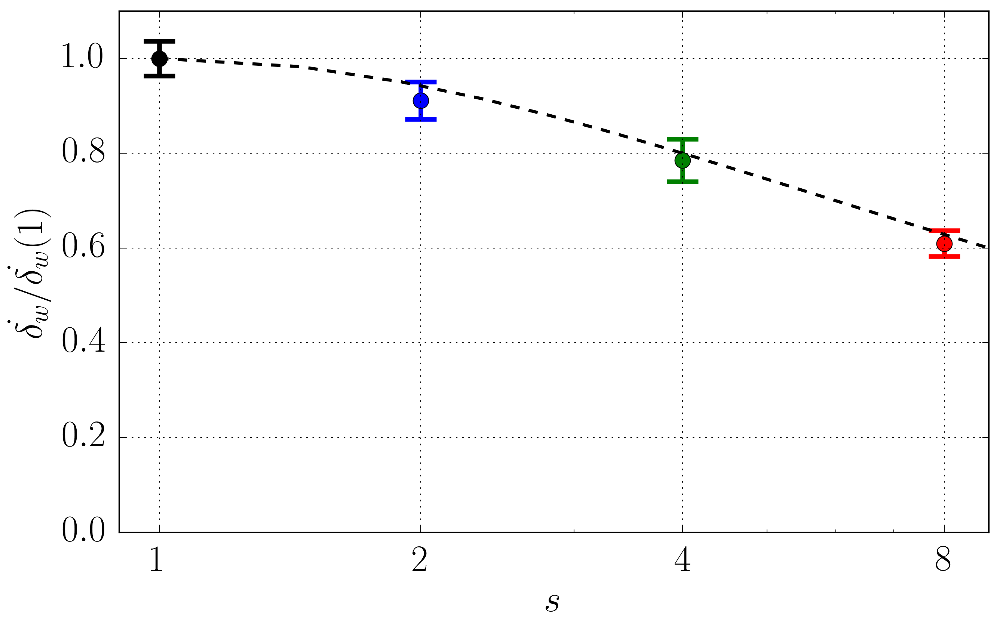

In [2483]:
figname = 'ramshaw'
ylabel = r'$\dot{\delta_w}/\dot{\delta_w}(1)$'
xlabel = r'$s$'

fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

vs = np.array(vs)
vs2=np.linspace(1,10,21)
ramshaw = 2*np.sqrt(vs2)/(vs2+1.0)

dwpoint = [0,0,0,0]
Cdelta = [0,0,0,0]
for icase in range(ncases):
    dwpoint[icase] = vdmpoint[icase]/vdmpoint[0]*vDw[icase]/vDw[0]
    Cdelta[icase]  = 2*vdmpoint[icase]*vDw[icase]
kk = np.zeros(ncases)
kke = np.zeros(ncases)
for icase in range(ncases):
    if icase==0:
        kk[icase]=unumpy.nominal_values(dmratio[icase])
        kke[icase]=np.sqrt(2.0)*unumpy.std_devs(vdmpoint[icase])/unumpy.nominal_values(vdmpoint[icase])
    else:
        kk[icase]=unumpy.nominal_values(dwpoint[icase])
        kke[icase]=unumpy.std_devs(dwpoint[icase])

#plt.plot(vs,unumpy.nominal_values(dwpoint[:]),'*')
for icase in range(0,ncases):
    (_,caps,_)=ax.errorbar(vs[icase],kk[icase],yerr=kke[icase],marker='o',mfc=l_case_color[icase], \
                ms=10.0,fmt='o',color=l_case_color[icase],capsize=10,lw=3.0)

    for cap in caps:
        #cap.set_color('red')
        cap.set_markeredgewidth(3)
#plt.plot(vs, kk,'ko',lw=2.0,ms=10)
#plt.plot(pantanodotdm[0],pantanodotdm[1],'k^',ms=10)
#plt.fill_between(vs,kk+kke,kk-kke,alpha=0.2)
#PANTANO
#plt.plot(vs,fpant,'ks',ms=10)
plt.plot(vs2,ramshaw,'--',lw=2.0,color='k')
plt.ylim([0,1.1])
#plt.xlim([0,10])
plt.xscale('log')
plt.xlim([0.9,9])
print Cdelta
ax.set_xticks([1,2, 4, 8])
ax.get_xaxis().set_major_formatter(plt.matplotlib.ticker.ScalarFormatter())
plt.xlabel(xlabel)
plt.ylabel(ylabel)

plt.grid('on')
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%(pathname)

STATS

## $R_{ij} = \overline{\rho u_i'' u_j''}/\overline{\rho}$ (Reynolds Stresses)

In [1924]:
R11_1990=np.loadtxt('/data2/toni/work/db/R11_1990.dat');
R11_1994=np.loadtxt('/data2/toni/work/db/R11_1994.dat');
R11_1971=np.loadtxt('/data2/toni/work/db/R11_1971.dat');
R22_1990=np.loadtxt('/data2/toni/work/db/R22_1990.dat');
R22_1994=np.loadtxt('/data2/toni/work/db/R22_1994.dat');
R22_1971=np.loadtxt('/data2/toni/work/db/R22_1971.dat');
R33_1990=np.loadtxt('/data2/toni/work/db/R22_1990.dat');
R33_1994=np.loadtxt('/data2/toni/work/db/R22_1994.dat');
R33_1971=np.loadtxt('/data2/toni/work/db/R22_1971.dat');
R12_1990=np.loadtxt('/data2/toni/work/db/R12_1990.dat');
R12_1994=np.loadtxt('/data2/toni/work/db/R12_1994.dat');
R12_1971=np.loadtxt('/data2/toni/work/db/R12_1971.dat');
u1u1_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u1.dat');
u2u2_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u2.dat');
u3u3_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u3.dat');
u1u2_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u12.dat');

# STATISTICS FROM FIELD

In [1925]:
Kuref=np.loadtxt('/share/drive/toni/python/Ku.dat')
Suref=np.loadtxt('/share/drive/toni/python/Su.dat')
Kvref=np.loadtxt('/share/drive/toni/python/Kv.dat')
Svref=np.loadtxt('/share/drive/toni/python/Sv.dat')
Ktref=np.loadtxt('/share/drive/toni/python/Kt.dat')
Stref=np.loadtxt('/share/drive/toni/python/St.dat')

In [1926]:
#print Kuref

## Temperature

In [2033]:
#print Dwcase
Dwcase=[1.0,1.0,1.0,1.0] #Using dw!

In [2034]:
p_root = '/share/drive/toni/VDML/'
cases = ['s10','s20','s40','s80']
p_folder_stats = [p_root + cases[i]+'/Tstats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )
l_width=2.0
l_job_color=['k','b','g','r']

In [2035]:
l_width=2.0
l_job_color=['k','b','g','r']

1.0 0.0
0.75 0.75
0.625 1.875
0.5625 3.9375


(-1.0, 1.5)

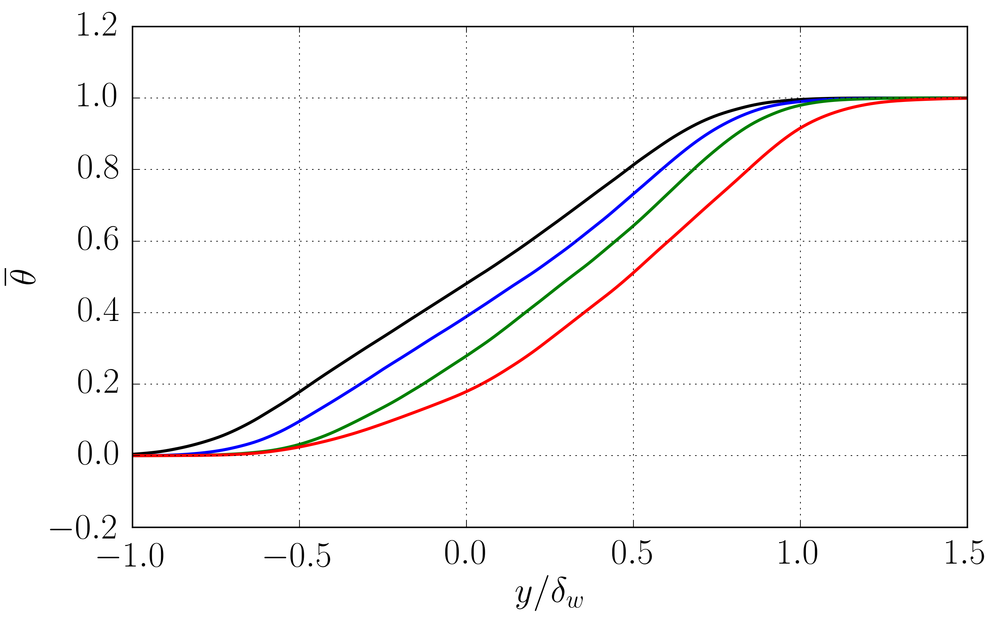

In [2036]:
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
lamb = [0 for i in range(len(cases))]
Tmin = [0 for i in range(len(cases))]
Tmax = [0 for i in range(len(cases))]
DT = [0 for i in range(len(cases))]
s = [1,2,4,8]
for i in range(len(cases)):
    lamb[i] = (s[i]-1.0)/(s[i]+1.0)
    Tmax[i]=1.0/(1-lamb[i])
    Tmin[i] = 1.0/(1.0+lamb[i])
    DT[i]=Tmax[i]- Tmin[i]
    print Tmin[i],DT[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(stat[i][1,:]-Tmin[i])/DT[i],lw=l_width,color=l_job_color[i]);plt.grid('on')
plt.xlabel(r'$y/\delta_w$')
#ylabel=r'$\frac{T-T_{min}}{\Delta T}$'
ylabel=r'$\overline{\theta}}$'
plt.ylabel(ylabel)
plt.xlim([-1.0,1.5])

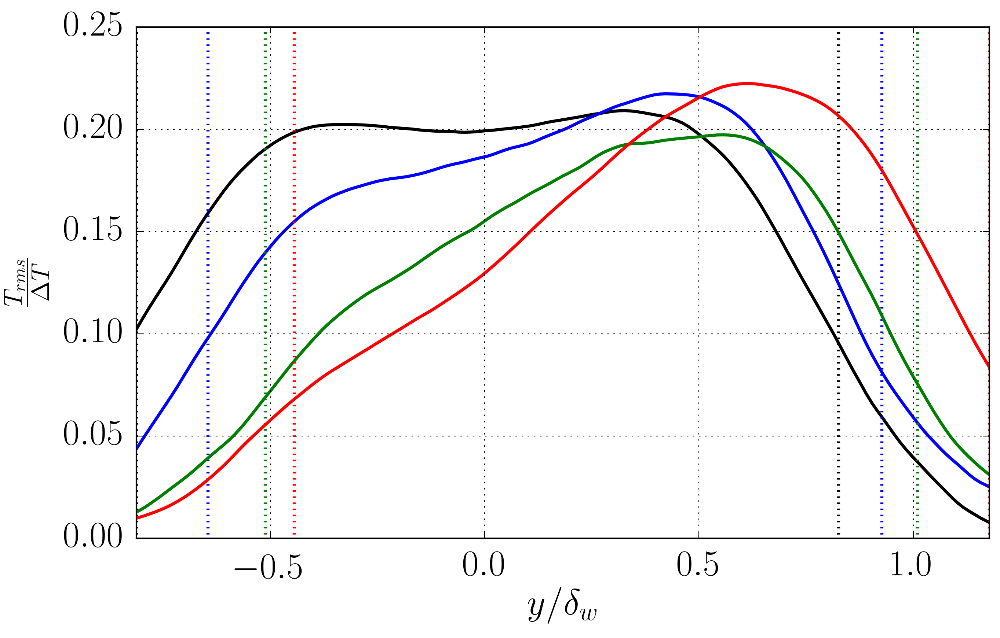

In [2037]:
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
column=2
for i in range(len(cases)):
    Tmax[i]=1.0/(1-lamb[i])
    Tmin[i] = 1.0/(1.0+lamb[i])
    DT[i]=Tmax[i]- Tmin[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(np.sqrt(stat[i][column,:]))/DT[i],lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.ylim([0.0,0.25])
plt.xlim([np.min(ymin),np.max(ymax)])
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$\frac{T_{rms}}{\Delta T}$')

In [2038]:
print SS1,SS2

[550, 580, 680, 700] [ 890.57037354  890.57037354  846.13543701  858.60467529]


0.499999990465
219.7
0.500000040965
227.5
0.500008269727
234.0
0.500052843217
247.0
figure saved!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:16: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


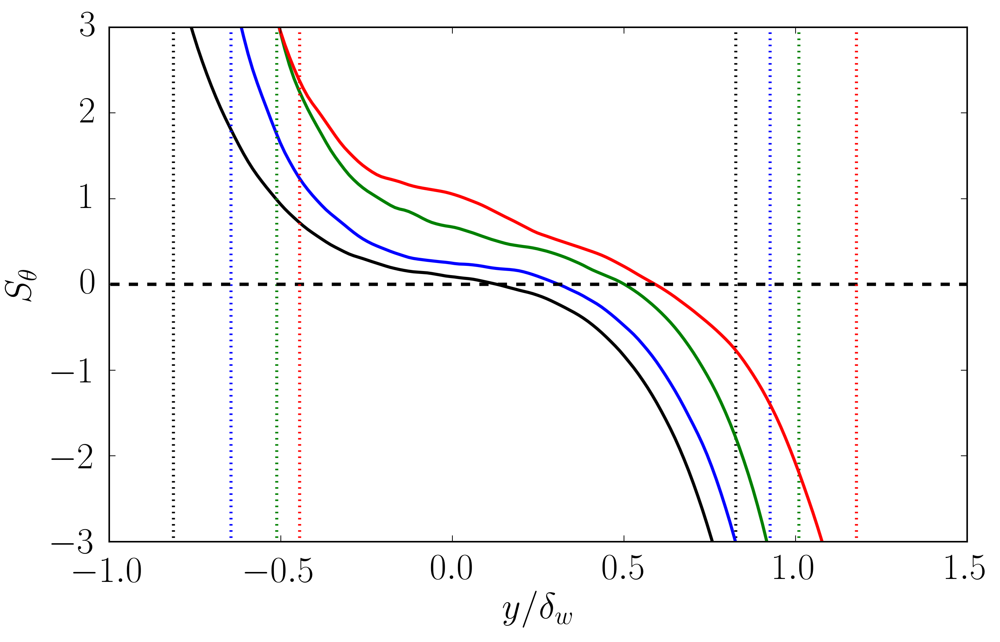

In [2046]:
figname = 'skewT_dw2'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]<=mllim*0.5)[0][0]
    print np.max(umm[i,:])
    itop = 1.3*where(umm[i,:]<=-mllim*0.5)[0][0]
    #itop = -1
    #if i == 2 or i==3:
    #    itop=round(itop*1.3)
    print itop
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    #plt.plot(Stref[:,0],Stref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

0.499999990465
0.500000040965
0.500008269727
0.500052843217
figure saved!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:12: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


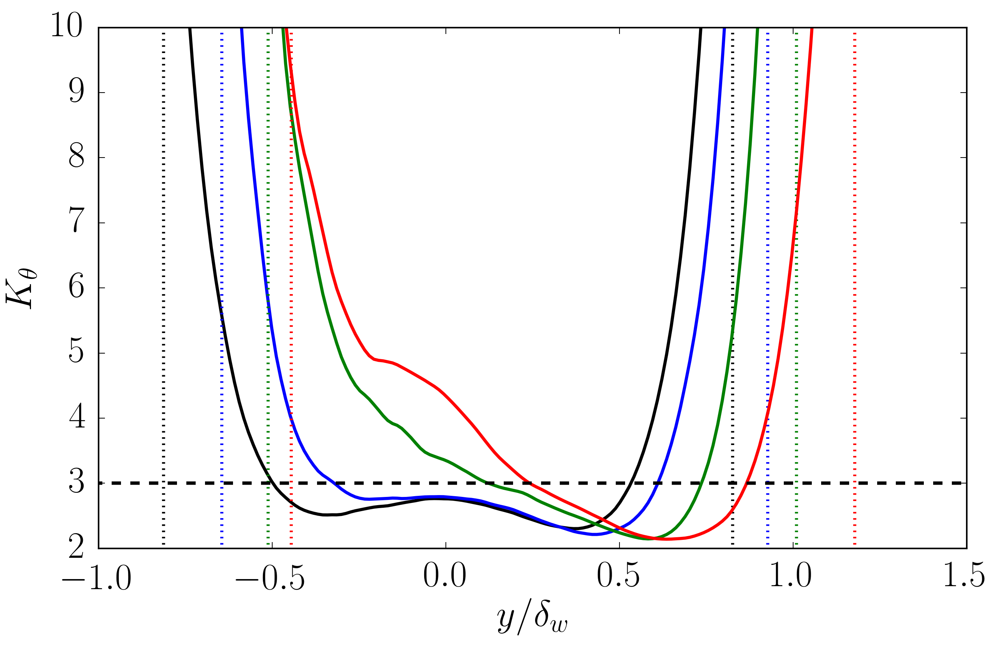

In [2047]:
column=4
figname = 'kurtT_dw2'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]<=mllim*0.5)[0][0]
    print np.max(umm[i,:])
    itop = 1.3*where(umm[i,:]<=-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    #plt.plot(Ktref[:,0],Ktref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# Comparison

0.499999990465
figure saved!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:12: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


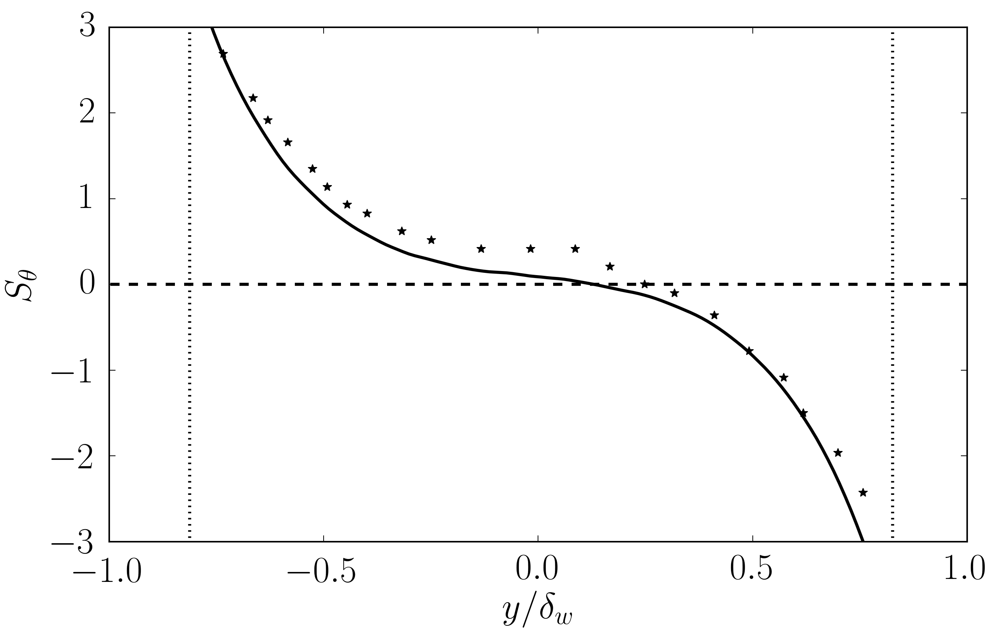

In [2048]:
figname = 'skewT_comp'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]<=mllim*0.5)[0][0]
    print np.max(umm[i,:])
    itop = 1.3*where(umm[i,:]<=-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Stref[:,0],Stref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


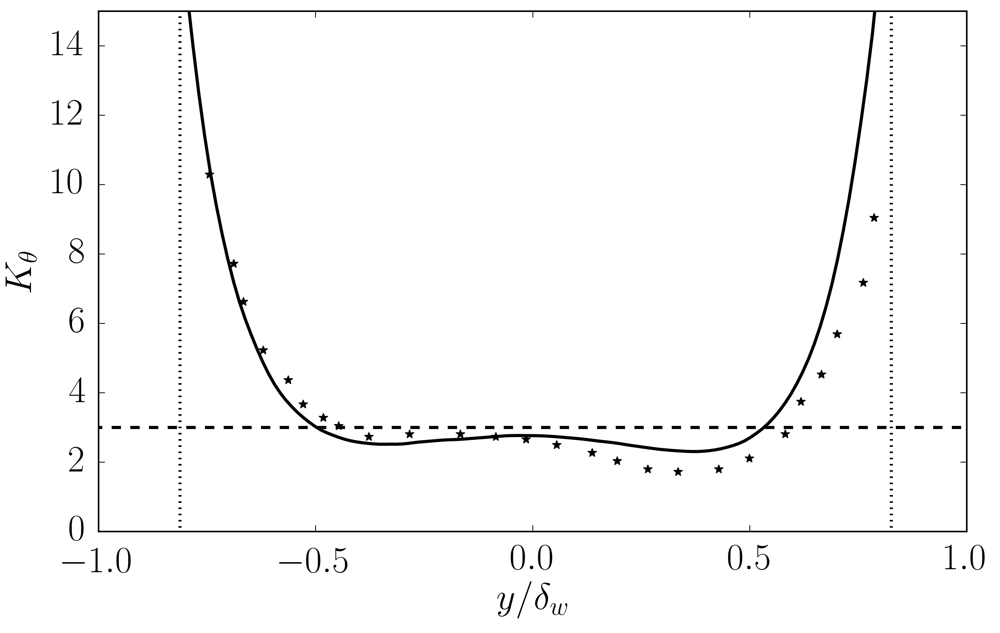

In [2049]:
column=4
figname = 'kurtT_comp'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    #itop = where(umm[i,:]<-mllim*0.51)[0][0]
    itop = -1
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Ktref[:,0],Ktref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([0,15])
plt.xlim([-1.0,1.0])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

## U

In [2050]:
p_root = '/share/drive/toni/VDML/'
cases = ['s10','s20','s40','s80']
p_folder_stats = [p_root + cases[i]+'/ustats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

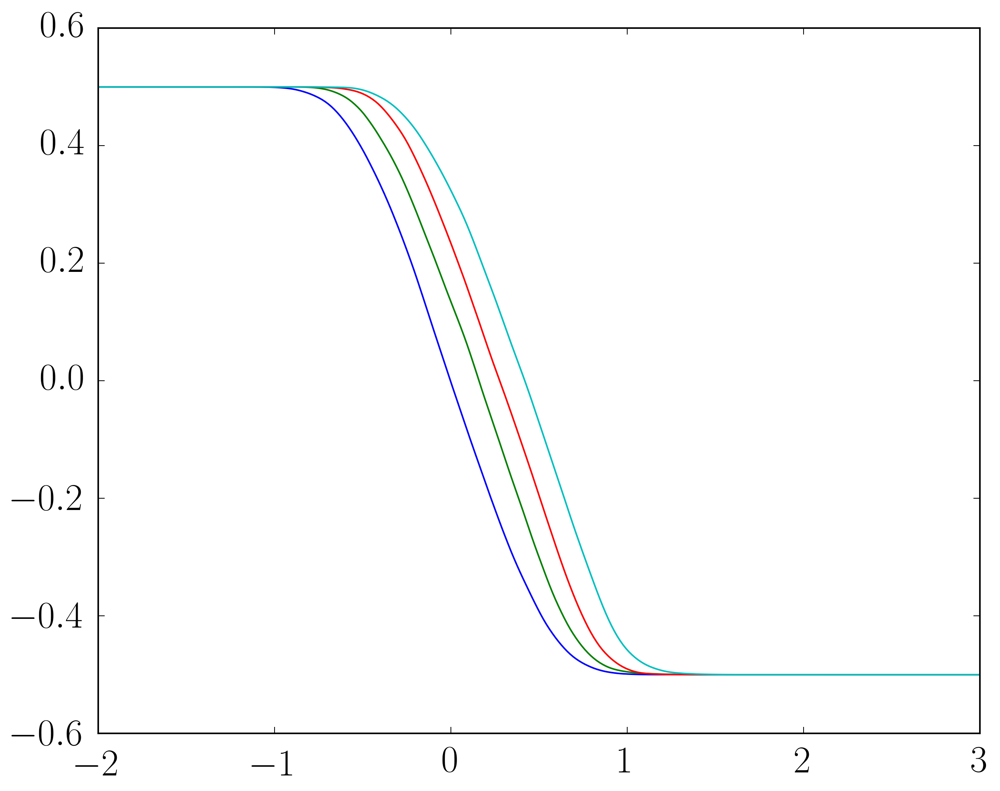

In [2051]:
for icase in range(ncases):
    plt.plot(stat[icase][0,:],stat[icase][1,:])

0.499999990465
-0.8127090301 0.826086956522
0.500000040965
-0.645484949833 0.926421404682
0.500008269727
-0.511705685619 1.01003344482
0.500052843217
-0.444816053512 1.17725752508
figure saved!


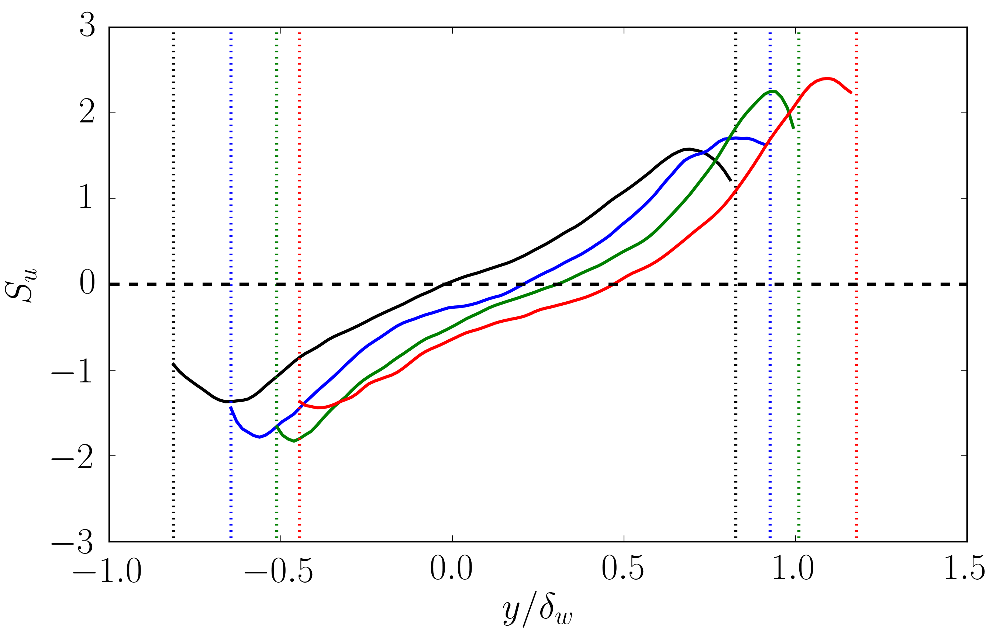

In [2021]:
figname = 'skewu_dw2'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
umm = np.zeros([shape(stat)[0],shape(stat)[2]])
yyy = np.zeros([shape(stat)[0],shape(stat)[2]])
ymin = np.zeros([shape(stat)[0]])
ymax = np.zeros([shape(stat)[0]])
mllim=0.98
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    umm[i,:] = stat[i][1,:]
    ibot = where(umm[i,:]<=mllim*0.5)[0][0]
    print np.max(umm[i,:])
    itop = where(umm[i,:]<=-mllim*0.5)[0][0]
    ymin[i]=yyy[i,ibot]
    ymax[i]=yyy[i,itop]
    print ymin[i],ymax[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    #plt.plot(Suref[:,0],Suref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

0.499999990465
0.500000040965
0.500008269727
0.500052843217
figure saved!


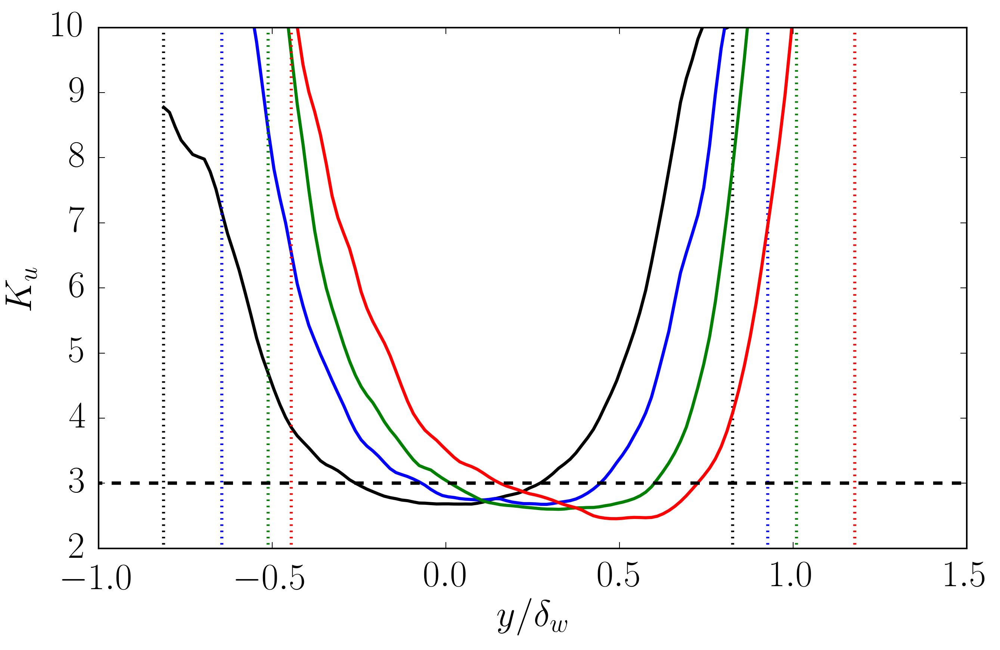

In [2022]:
column=4
figname = 'kurtu_dw2'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    ibot = where(umm[i,:]<=mllim*0.5)[0][0]
    print np.max(umm[i,:])
    itop = where(umm[i,:]<=-mllim*0.5)[0][0]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(Dwcase[i]*stat[i][0,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
plt.xlim([-1,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# Comparison

figure saved!


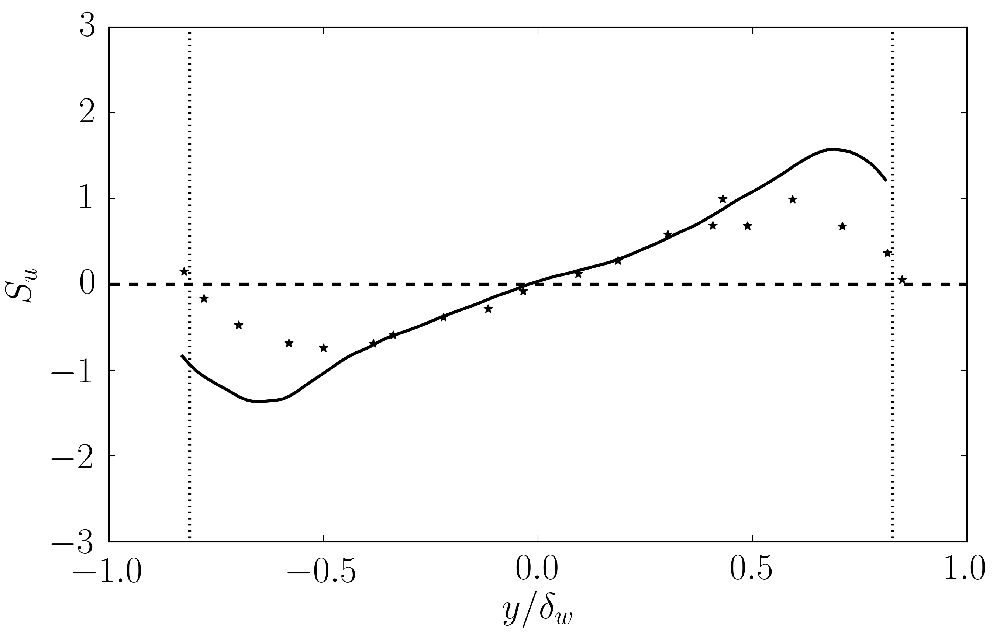

In [2023]:
figname = 'skewu_comp'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Suref[:,0],Suref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


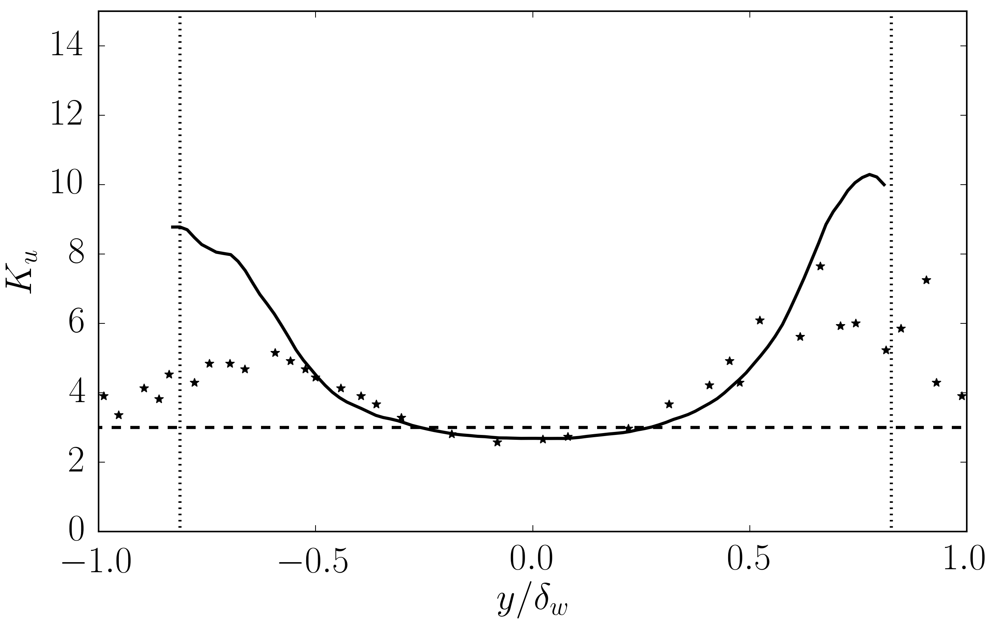

In [2024]:
column=4
figname = 'kurtu_comp'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Kuref[:,0],Kuref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([0,15])
plt.xlim([-1.0,1.0])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# $v$

In [2025]:
p_root = '/share/drive/toni/VDML/'
cases = ['s10','s20','s40','s80']
p_folder_stats = [p_root + cases[i]+'/vstats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

figure saved!


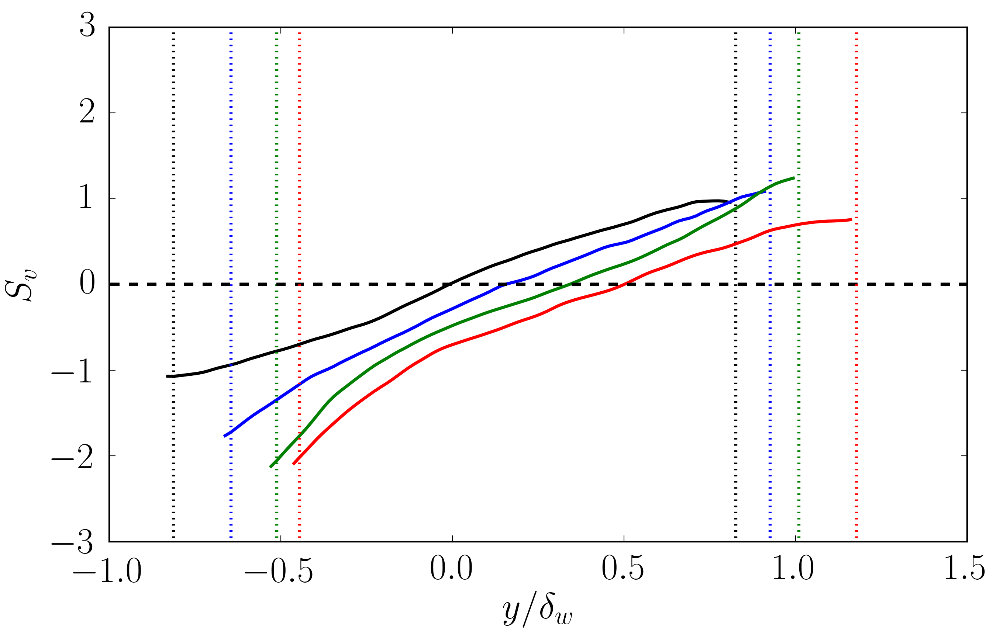

In [2026]:
figname = 'skewv_dw2'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


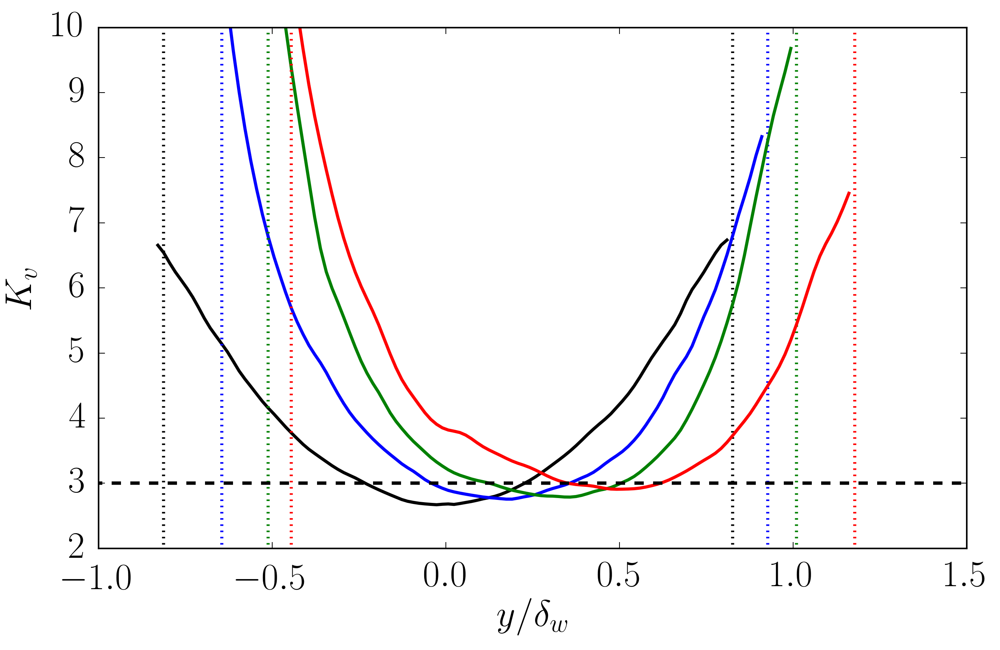

In [2027]:
column=4
figname = 'kurtv_dw2'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# Comparison

figure saved!


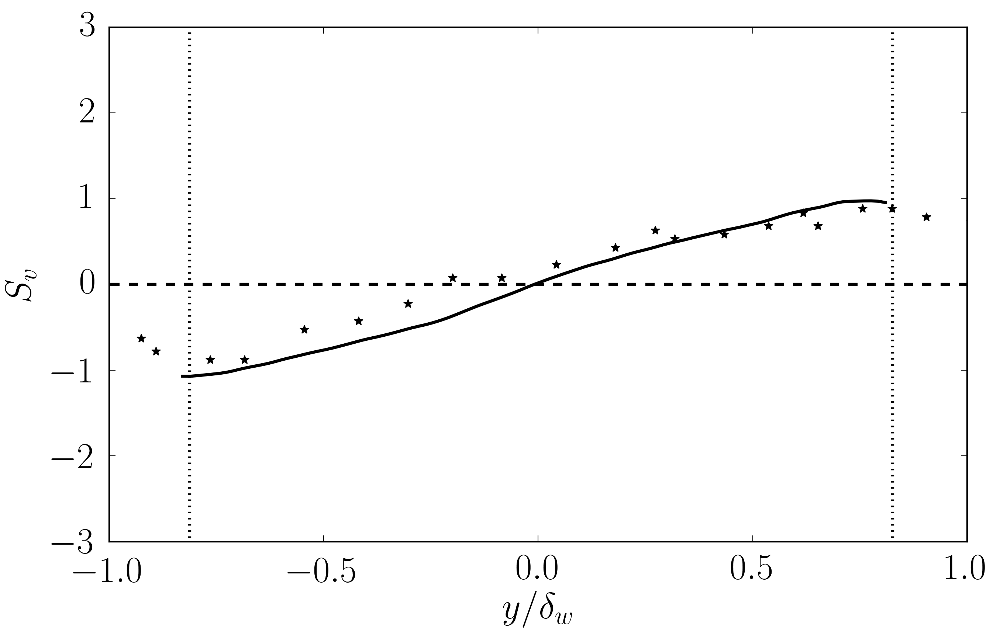

In [2028]:
figname = 'skewv_comp'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Svref[:,0],Svref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


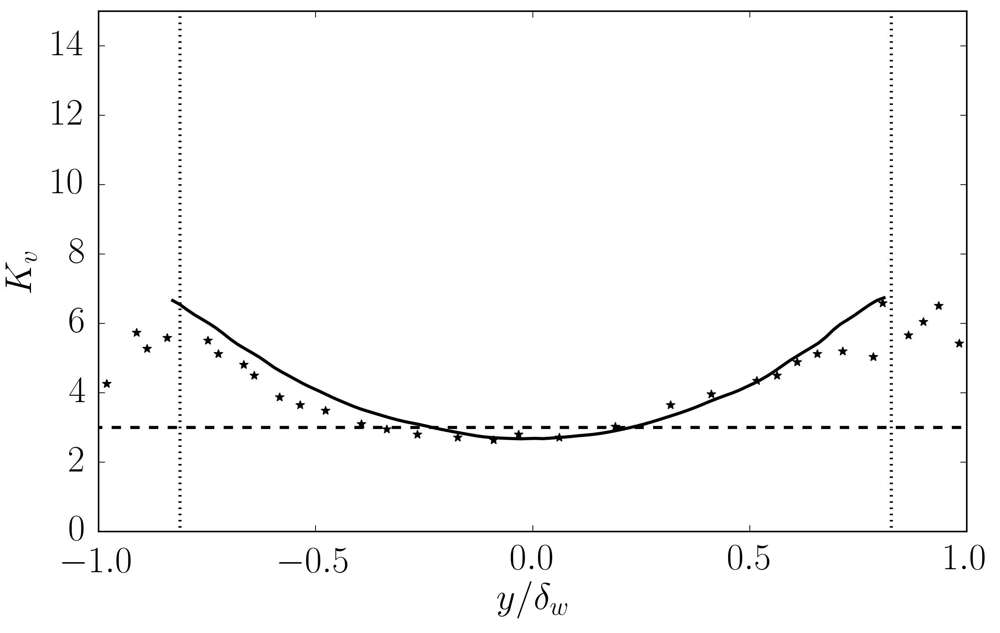

In [2029]:
column=4
figname = 'kurtv_comp'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Kvref[:,0],Kvref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([0,15])
plt.xlim([-1.0,1.0])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# w

In [2052]:
p_root = '/share/drive/toni/VDML/'
cases = ['s10','s20','s40','s80']
p_folder_stats = [p_root + cases[i]+'/wstats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

figure saved!


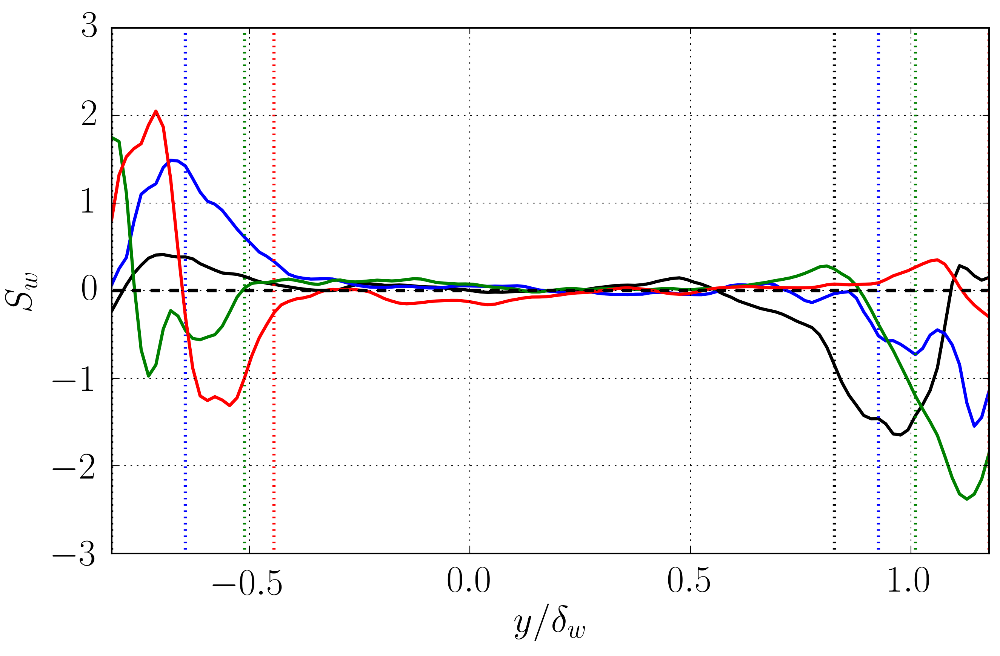

In [2053]:
figname = 'skeww_dw'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-2.0,2.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_w$')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!
/share/drive/toni/VDML/JFM_joint/kurtw_dw.pdf


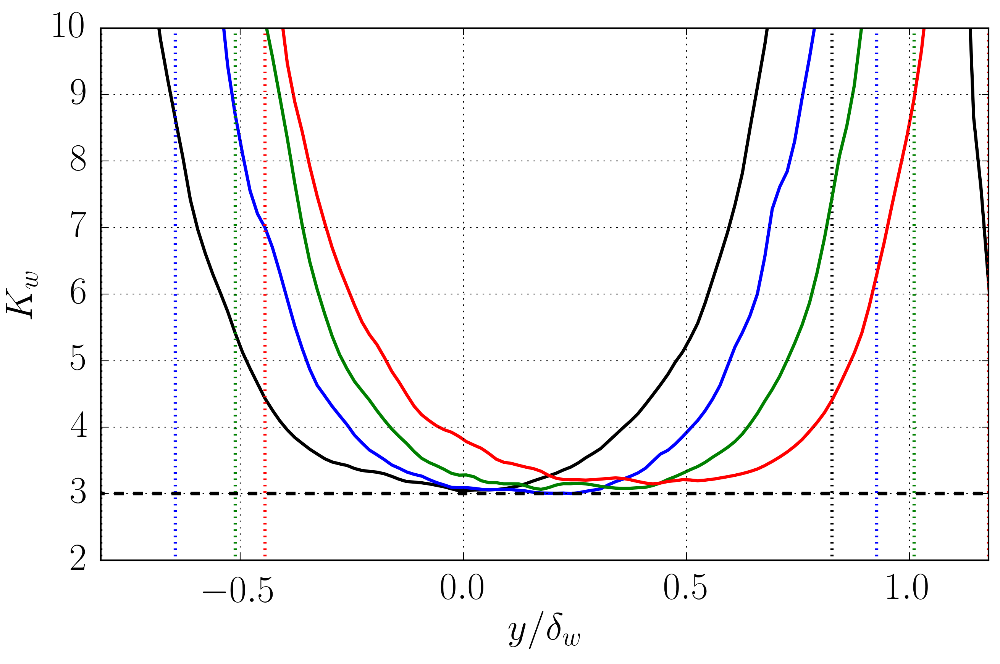

In [2032]:
column=4
figname = 'kurtw_dw'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-2.0,2.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_w$')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')
    print pathname

In [1961]:
print DT

[1.0, 0.7499999999999998, 1.875, 3.9375]


In [1962]:
print Tmin

[0, 0.75, 0.625, 0.5625]


In [1963]:
print vplanes[3]

[125, 145, 165, 185, 205, 225, 245, 265, 285, 305, 325, 345, 365, 385, 405, 426, 445, 465, 485, 505, 525, 545, 565, 585, 605, 625, 645, 665, 685, 705, 725]


# SPECTRA

In [1247]:
St1=SS1
St2=np.array(St1)
for i in range(len(St1)):
    St2[i]=St1[i]+10.0
print St2

[560 660 690 700]


In [1249]:
def getSpectra(path,nplane,pathSTA,variable,tmin,tmax, sumaxis,scaling = 'dm',Npoints=500):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(pathSTA,"r") as g:
        delta = np.array(g[scaling])
        y=np.array(g['y'])
    planePOS=y[nplane]
    print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmin = kx[1]*delta[it2]#Kmin scaled with max dm
        kmax = kx[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kx
    elif sumaxis==1:
        kmin = kz[1]*delta[it2]#Kmin scaled with max dm
        kmax = kz[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kz
    #xik = np.linspace(kmin,kmax,Npoints)
    funintcum = np.zeros(Npoints);
    nacum = 0
    fyjob = [np.zeros(Npoints) for i in range(it2-it1)]
    f00job = [0.0 for i in range(it2-it1)]
    print it1,it2
    print np.shape(fun)
    for itime in range(it1,it2):
        dd = delta[itime]
        if variable==5 or variable==6 or variable==7:
            funint = np.interp(xik,kk*dd,dd**2*kk*fun[:,itime],left=NaN,right=NaN)
        else:
            funint = np.interp(xik,kk*dd,dd*kk*fun[:,itime],left=NaN,right=NaN)
        fyjob[itime-it1] = funint
        f00job[itime-it1] = fun00[itime]
    planedeltaEVO = planePOS/delta[it1:it2]

    return xik,np.mean(fyjob,axis=0),np.std(fyjob,axis=0),time[it1:it2],f00job,planedeltaEVO

In [1250]:
def getSpectra2(path,nplane,pathSTA,variable,tmin,tmax, sumaxis,scaling = 'dm',Npoints=500):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(pathSTA,"r") as g:
        delta = np.array(g[scaling])
        y=np.array(g['y'])

    planePOS=y[nplane-1]
    #print nplane
    print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmin = kx[1]*delta[it2]#Kmin scaled with max dm
        kmax = kx[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kx
    elif sumaxis==1:
        kmin = kz[1]*delta[it2]#Kmin scaled with max dm
        kmax = kz[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kz
    #xik = np.linspace(kmin,kmax,Npoints)
    funintcum = np.zeros(Npoints);
    nacum = 0
    fyjob = [np.zeros(Npoints) for i in range(it2-it1)]
    f00job = [0.0 for i in range(it2-it1)]
    print it1,it2
    print np.shape(fun)
    ydm = np.zeros([it2-it1])
    for itime in range(it1,it2):
        dd = delta[itime]
        if variable==5 or variable==6 or variable==7:
            funint = np.interp(xik,kk*dd,dd**2*kk*fun[:,itime],left=NaN,right=NaN)
        else:
            funint = np.interp(xik,kk*dd,dd*kk*fun[:,itime],left=NaN,right=NaN)
            
        fyjob[itime-it1] = funint
        f00job[itime-it1] = fun00[itime]
        ydm[itime-it1] = planePOS/delta[itime]

    return xik,ydm,fyjob,time[it1:it2],f00job,

# ACCUMULATION SPECTRA

In [1251]:
def accumSpectraScaled(path,nplane,y,delta,variable,tmin,tmax, sumaxis,kbin,ydbin,matrix,countM):
    """
    Accum spectra in y/delta bins and kxdelta bins, saved in matrix
    """
    lenkbin,lenydbin=np.shape(matrix)
    planePOS=y[nplane-1]
    #print nplane
    #print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx);
        mz = len(kz);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)

    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kk = kx
        m  = mx
    elif sumaxis==1:
        kk = kz
        m  = mz
    #Get Dkbin supposing linear distribution
    Dk =  kbin[-1]-kbin[-2]
    #For each time --> different y/delta
    for itime in range(it1,it2):
        dd = delta[itime]
        ydm = planePOS/dd;
        maxE= np.max(fun[:,itime])
        fun2 = fun[:,itime]/maxE
        #Find ydbin location 
        jj = where(ydbin>=ydm)[0][0]
        k1 = np.round((dd/Dk)*kk)
        k1= k1.astype(int)
        iibefore = -1; #First is always new!
        for ii,ikx in zip(k1,range(m)):
            matrix[ii,jj]+=fun2[ikx]
            #Count is counting how many lines do we have per grid square
            if ii !=iibefore:
                countM[ii,jj]+=1
            iibefore = ii
 

    return matrix,countM

In [2070]:
p_folders
SS2 = tmaxcases

In [2071]:
ijob = 0
SS1j= np.zeros([njobs])
SS2j= np.zeros([njobs])
for icase in range(ncases):
    for jcase in lcases[icase]:
        print p_folders[ijob]
        SS1j[ijob] = SS1[icase]
        SS2j[ijob] = tmaxcases[icase]
        ijob+=1
print SS2j

/share/drive/toni/VDML/s10/01/h5.stats
/share/drive/toni/VDML/s10/02/h5.stats
/share/drive/toni/VDML/s10/03/h5.stats
/share/drive/toni/VDML/s10/04/newman/h5.stats
/share/drive/toni/VDML/s10/06/h5.stats
/share/drive/toni/VDML/s20/01/h5.stats
/share/drive/toni/VDML/s20/02/h5.stats
/share/drive/toni/VDML/s20/03/h5.stats
/share/drive/toni/VDML/s20/04/h5.stats
/share/drive/toni/VDML/s40/01/h5.stats
/share/drive/toni/VDML/s40/02/h5.stats
/share/drive/toni/VDML/s40/03/h5.stats
/share/drive/toni/VDML/s40/04/h5.stats
/share/drive/toni/VDML/s80/01/h5.stats
/share/drive/toni/VDML/s80/02/h5.stats
/share/drive/toni/VDML/s80/03/h5.stats
/share/drive/toni/VDML/s80/04/h5.stats
[ 900.02752686  900.02752686  900.02752686  900.02752686  900.02752686
  848.05938721  848.05938721  848.05938721  848.05938721  890.6673584
  890.6673584   890.6673584   890.6673584   873.09320068  873.09320068
  873.09320068  873.09320068]


In [2072]:
#Creating Matrix for accumulations
#NEED SOME CHECKING IN ORDER TO CREATE BIN VECTORS!
#kbin = [0,DK,kmax] with kmax = kx[-1]*max(delta)
#ydbin = [-y/max(delta),y/max(delta)]
sumaxis=0 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m =512; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,njobs)
Nkbins =m-12;
Nydbins = 31;
if scaling=='dw':
    ydmin = -1.05
    ydmax = 2.0 
    ydbin = np.linspace(ydmin,ydmax,Nydbins)
else: 
    print "I do not recommend using dm..."
    
matrix = np.zeros([Nkbins,Nydbins])
countM = np.zeros([Nkbins,Nydbins])
kmax = 0.0;
for ijob in jlist:
    tmin=SS1j[ijob]
    tmax=SS2j[ijob]
    path = p_folders[ijob]
    print path
    with h5py.File(path,"r") as f:
        
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = np.nanmax([m*alp[0]*delta[it2],kmax]) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = np.nanmax([m*bet[0]*delta[it2],kmax]) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(0,kmax,Nkbins)


print "kmax = %s"%kmax
print "lambda min = %s, lambda max=%s"%(np.min(lbin),np.max(lbin))
#print kbin/np.min(np.diff(kbin))

/share/drive/toni/VDML/s10/01/h5.stats
/share/drive/toni/VDML/s10/02/h5.stats
/share/drive/toni/VDML/s10/03/h5.stats
/share/drive/toni/VDML/s10/04/newman/h5.stats
/share/drive/toni/VDML/s10/06/h5.stats
/share/drive/toni/VDML/s20/01/h5.stats
/share/drive/toni/VDML/s20/02/h5.stats
/share/drive/toni/VDML/s20/03/h5.stats
/share/drive/toni/VDML/s20/04/h5.stats
/share/drive/toni/VDML/s40/01/h5.stats
/share/drive/toni/VDML/s40/02/h5.stats
/share/drive/toni/VDML/s40/03/h5.stats
/share/drive/toni/VDML/s40/04/h5.stats
/share/drive/toni/VDML/s80/01/h5.stats
/share/drive/toni/VDML/s80/02/h5.stats
/share/drive/toni/VDML/s80/03/h5.stats
/share/drive/toni/VDML/s80/04/h5.stats
kmax = 460.647986246
lambda min = 0.0, lambda max=12.6215


In [1273]:
def getSpectravstime(path,nplane,variable):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;

        
        #funSPE = np.array(f['SPEC'][1:,variable,1:,:]);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = funSPE[0,0,:]
        for tt in range(len(time)):
            funSPE[0,0,tt]=0.0
        funkx0  = np.sum(funSPE[:,0,:],axis=0)
        res=time*0.0
        for kk,ii in  zip(kx,range(len(kx))):
            res += np.sum(funSPE[:,ii,:],axis=0)
        funRest = res
        #funRest = np.sum(kx[1:]*np.sum(kz[:]*funSPE[1:,0:,:],axis=1),axis=0)
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    return kx,kz,time,funkx0,funRest,fun00

In [1274]:
def accumSpectra(path,nplane,y,delta,variable,tmin,tmax, sumaxis,kbin,ydbin,matrix,countM):
    """
    Accum spectra in y/delta bins and kxdelta bins, saved in matrix
    """
    lenkbin,lenydbin=np.shape(matrix)
    planePOS=y[nplane-1]
    #print nplane
    #print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx);
        mz = len(kz);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kk = kx
        m  = mx
    elif sumaxis==1:
        kk = kz
        m  = mz
    #Get Dkbin supposing linear distribution
     Dk =  kbin[-1]-kbin[-2]
    #Dk =  np.min(np.diff(kbin))
    #For each time --> different y/delta
    for itime in range(it1,it2):
        dd = delta[itime]
        ydm = planePOS/dd;
        outofbounds=False
        #Find ydbin location 
        try:
            jj = where(ydbin>=ydm)[0][0]
        except IndexError:
            #break
            jj = len(ydbin)-1 #Save into last line
            outofbounds=True
        if (ydm-ydbin[0])<=-np.diff(ydbin)[0]/2:#Too far from ydbin minimum
            outofbounds=True
        k1 = np.round((dd/Dk)*kk)
        if k1.any()>len(k1):
            print "Houston we have a problem: k1=%s"%k1
        k1= k1.astype(int)
        iibefore = -1; #First is always new!
        if outofbounds==False:
            #for ii,ikx in zip(k1,range(m)):
                #matrix[ii,jj]+=fun[ikx,itime]
            for ikx in range(m):
                ii = k1[ikx]
                matrix[ii,jj]+=fun[ikx,itime]
                #Count is counting how many lines do we have per grid square
                if ii !=iibefore:
                    countM[ii,jj]+=1
                iibefore = ii
    

    return matrix,countM

In [2057]:
ik = where(vtcases[0]<=500)

# SPECTRA PRINT STREAM

In [2074]:
print SS1j

[ 550.  550.  550.  550.  550.  580.  580.  580.  580.  680.  680.  680.
  680.  700.  700.  700.  700.]


In [2075]:
p_folders_spe=[]
print p_folders

['/share/drive/toni/VDML/s10/01/h5.stats', '/share/drive/toni/VDML/s10/02/h5.stats', '/share/drive/toni/VDML/s10/03/h5.stats', '/share/drive/toni/VDML/s10/04/newman/h5.stats', '/share/drive/toni/VDML/s10/06/h5.stats', '/share/drive/toni/VDML/s20/01/h5.stats', '/share/drive/toni/VDML/s20/02/h5.stats', '/share/drive/toni/VDML/s20/03/h5.stats', '/share/drive/toni/VDML/s20/04/h5.stats', '/share/drive/toni/VDML/s40/01/h5.stats', '/share/drive/toni/VDML/s40/02/h5.stats', '/share/drive/toni/VDML/s40/03/h5.stats', '/share/drive/toni/VDML/s40/04/h5.stats', '/share/drive/toni/VDML/s80/01/h5.stats', '/share/drive/toni/VDML/s80/02/h5.stats', '/share/drive/toni/VDML/s80/03/h5.stats', '/share/drive/toni/VDML/s80/04/h5.stats']


In [2076]:
fnplane='mid'
vplanes=[]
nmaxplanes=[]
for ijob,path in zip(range(len(p_folders)),p_folders):
    print ijob
    p_folders_spe.append(path[0:-5]+fnplane+'.spes')
    print p_folders_spe[ijob]
    path = p_folders_spe[ijob]
    with h5py.File(path,"r") as f:
        v=np.array(f['jsp'])
        vplanes.append(v)
        nmaxplanes.append(len(v))
    #New sorted planes trick
    vplanes[ijob]=sorted(vplanes[ijob])
print vplanes
print nmaxplanes
#scaling = 'dm'
p_folders_spe=[['']*nmaxplanes[ijob] for ijob in range(len(p_folders))]
for ijob,path in zip(range(len(p_folders)),p_folders):
    with h5py.File(path,"r") as g:
        my = len(np.array(g['y']))
        time=np.array(g['time'])
        dd=np.array(g[scaling])
        midplane = my/2+1
        #print "midplane=%s"%midplane
    for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
        if nplane==midplane: #Lastplane
            #print "This is midplane"
            fnplane='mid'
        else:
            fnplane="%03d"%nplane
        p_folders_spe[ijob][jj]=path[0:-5]+fnplane+'.spes'
        #print "Reading spe file: %s" %(pathSPE)

0
/share/drive/toni/VDML/s10/01/h5.mid.spes
1
/share/drive/toni/VDML/s10/02/h5.mid.spes
2
/share/drive/toni/VDML/s10/03/h5.mid.spes
3
/share/drive/toni/VDML/s10/04/newman/h5.mid.spes
4
/share/drive/toni/VDML/s10/06/h5.mid.spes
5
/share/drive/toni/VDML/s20/01/h5.mid.spes
6
/share/drive/toni/VDML/s20/02/h5.mid.spes
7
/share/drive/toni/VDML/s20/03/h5.mid.spes
8
/share/drive/toni/VDML/s20/04/h5.mid.spes
9
/share/drive/toni/VDML/s40/01/h5.mid.spes
10
/share/drive/toni/VDML/s40/02/h5.mid.spes
11
/share/drive/toni/VDML/s40/03/h5.mid.spes
12
/share/drive/toni/VDML/s40/04/h5.mid.spes
13
/share/drive/toni/VDML/s80/01/h5.mid.spes
14
/share/drive/toni/VDML/s80/02/h5.mid.spes
15
/share/drive/toni/VDML/s80/03/h5.mid.spes
16
/share/drive/toni/VDML/s80/04/h5.mid.spes
[[125, 145, 165, 185, 205, 225, 245, 265, 285, 305, 325, 345, 365, 385, 405, 426, 445, 465, 485, 505, 525, 545, 565, 585, 605, 625, 645, 665, 685, 705, 725], [125, 145, 165, 185, 205, 225, 245, 265, 285, 305, 325, 345, 365, 385, 405, 426,

In [2198]:
def accumSpectraB(path,nplane,variable,vtime, tmax,sumaxis,matrix,countM):
    """
    For each plane in the database, for all spectra, find position in the temporal bin and add
    vtime=vtcases[icase]            
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx']);
        kz = np.array(f['kz']);
        mx = len(kx);
        mz = len(kz);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:]);
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    #print np.shape(fun)
    if sumaxis==0:
        kk = kx
        m  = mx
    elif sumaxis==1:
        kk = kz
        m  = mz
    #Locate where to put this SPECTRA
    itmax = where(time>=tmax)[0][0]
    for itime in range(0,itmax):
        itint = where(vtime>=time[itime])[0][0]
        matrix[itint,:,nplane-1] += fun[:,itime]
        countM[itint,nplane-1]+=1

    return matrix,countM,kk,m

In [2153]:
def interp_spectra(kbin,ydbin,vtime,delta,fun,kk,y,vplanes,tmin,tmax):
    """
    For a given spec matrix interp
    vtime=vtcases[icase]      
    """
    matrix = np.zeros([len(kbin),len(ydbin)])
    countM  = np.zeros([len(kbin),len(ydbin)])
    Dk =  kbin[-1]-kbin[-2]
    m = len(kk)
    it1 = where(vtime>=tmin)[0][0]
    it2 = where(vtime<=tmax)[0][-1]
    for itime in range(it1,it2):
        dd = delta[itime]
        ydm = y[vplanes]/dd;#This is a vector
        outofbounds=False
        #Find ydbin location 
        vjj =np.round((ydm-ydbin[0])/np.diff(ydbin)[0]) 
        vjj = vjj.astype(int)
        print vjj
        k1 = np.round((dd/Dk)*kk)
        if k1.any()>len(k1):
            print "Houston we have a problem: k1=%s"%k1
        k1= k1.astype(int)
        for ikx in range(m):
            ii = k1[ikx]
            for jplane in range(len(vplanes)):
                jj = vjj[jplane]
                if jj>=0 and jj<len(ydbin):
                    matrix[ii,jj]+=fun[itime,ikx,jplane]
                #Count is counting how many lines do we have per grid square
                    countM[ii,jj]+=1

   
    

    return matrix/countM

In [2196]:
root = '/share/drive/toni/VDML/'
p_folders_cases = [root+'s10/',root+'s20/',root+'s20/',root+'s20/']
print p_folders_cases

['/share/drive/toni/VDML/s10/', '/share/drive/toni/VDML/s20/', '/share/drive/toni/VDML/s20/', '/share/drive/toni/VDML/s20/']


In [2201]:
#READ ALL SPECTRA PLANES AND ENSEMBLE AVERAGE ALL TO WRITE A HDF5FILE
sumaxis =0
mx = 512 #MAKE SURE THIS IS CORRECT
mz = 192
lvariable=[0,1,2,11] #u,v,w,T
lvariable=[0,1,2,11] #u,v,w,T
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#range(ncases)
for icase in [0]:
    #Path to write file
    ffirst = True
    pathwrite = p_folders_cases[icase]+'spec_'+str(sumaxis)+'_h5.stats'
    with h5py.File(pathwrite,"w") as g:
        g['y']=vy[icase]
        g['vplanes']= vplanes[lcases[icase][0]]
        g['time']   = vtcases[icase]
        g['dwe']    = mydict[icase]['dwe'][:]
        g['dm']     = mydict[icase]['dm'][:]
    Ntimes = len(vtcases[icase])
    print lcases[icase][0]
    Nplanes = len(vplanes[lcases[icase][0]])
    for variable in lvariable:
        varname = lnamevariable[variable]
        count  =  np.zeros([Ntimes,Nplanes])
        if sumaxis == 0:
            matrix =  np.zeros([Ntimes,mx,Nplanes])
        else:
            matrix =  np.zeros([Ntimes,mz,Nplanes])
        for ijob in lcases[icase]:
            for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
                path = p_folders_spe[ijob][jj]
                matrix, count , k , m= accumSpectraB(path,jj,variable,vtcases[icase],SS2j[ijob], sumaxis,matrix,count)
        Ntimes,mmax,Nplanes = np.shape(matrix)   
        print "modes = %s"%(m)
        mtest= np.zeros([Ntimes,mmax,Nplanes])
        #Divide by count
        for im in range(mmax):
            mtest[:,im,:] = matrix[:,im,:]/count[:,:]
    
        with h5py.File(pathwrite,"r+") as g:
            if ffirst==True:
                g['k'] = k #Write kx or kz vector
                ffirst=False
            g[varname] = mtest
            print "Writing spectra of %s for icase = %s"%(varname,icase)

0
modes = 512
Writing spectra of u for icase = 0
modes = 512
Writing spectra of v for icase = 0
modes = 512
Writing spectra of w for icase = 0
modes = 512
Writing spectra of T for icase = 0


In [2202]:
#READ ALL SPECTRA PLANES AND ENSEMBLE AVERAGE ALL TO WRITE A HDF5FILE
sumaxis = 1
mx = 512 #MAKE SURE THIS IS CORRECT
mz = 192
lvariable=[0,1,2,11] #u,v,w,T
lvariable=[0,1,2,11] #u,v,w,T
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#range(ncases)
for icase in [0]:
    #Path to write file
    ffirst = True
    pathwrite = p_folders_cases[icase]+'spec_'+str(sumaxis)+'_h5.stats'
    with h5py.File(pathwrite,"w") as g:
        g['y']=vy[icase]
        g['vplanes']= vplanes[lcases[icase][0]]
        g['time']   = vtcases[icase]
        g['dwe']    = mydict[icase]['dwe'][:]
        g['dm']     = mydict[icase]['dm'][:]
    Ntimes = len(vtcases[icase])
    print lcases[icase][0]
    Nplanes = len(vplanes[lcases[icase][0]])
    for variable in lvariable:
        varname = lnamevariable[variable]
        count  =  np.zeros([Ntimes,Nplanes])
        if sumaxis == 0:
            matrix =  np.zeros([Ntimes,mx,Nplanes])
        else:
            matrix =  np.zeros([Ntimes,mz,Nplanes])
        for ijob in lcases[icase]:
            for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
                path = p_folders_spe[ijob][jj]
                matrix, count , k , m= accumSpectraB(path,jj,variable,vtcases[icase],SS2j[ijob], sumaxis,matrix,count)
        Ntimes,mmax,Nplanes = np.shape(matrix)   
        print "modes = %s"%(m)
        mtest= np.zeros([Ntimes,mmax,Nplanes])
        #Divide by count
        for im in range(mmax):
            mtest[:,im,:] = matrix[:,im,:]/count[:,:]
    
        with h5py.File(pathwrite,"r+") as g:
            if ffirst==True:
                g['k'] = k #Write kx or kz vector
                ffirst=False
            g[varname] = mtest
            print "Writing spectra of %s for icase = %s"%(varname,icase)

0
modes = 192
Writing spectra of u for icase = 0
modes = 192
Writing spectra of v for icase = 0
modes = 192
Writing spectra of w for icase = 0
modes = 192
Writing spectra of T for icase = 0


In [2141]:
scaling = 'dw'
Nkbins =m;
Nydbins = 23;
kmax = 0.0;
kmin = 100.0
mx=512;
mz=192;
for ijob in lcases[icase]:
    tmin=SS1j[ijob]
    tmax=SS2j[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        kmin = min(kmin,alp[0]*delta[it1])
        #lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        kmin = min(kmin,bet[0]*delta[it1])
        #lbin = np.linspace(0,(2*pi/bet[0])/delta[it1],Nkbins)
        
kbin = np.linspace(kmin,kmax,Nkbins)
print "kmin = %s"%kmin
print "kmax = %s"%kmax

kmin = 0.550651920325
kmax = 419.492048842


In [2149]:
mtest2 = interp_spectra(kbin,ydbin,vtcases[icase],mydict[icase]['dwe'],mtest,k,vy[icase],vplanes[lcases[icase][0]],SS1[icase],SS2[icase])

1


In [2154]:

mtest2 = interp_spectra(kbin,ydbin,vtcases[icase],mydict[icase]['dwe'],mtest,k,vy[icase],vplanes[lcases[icase][0]],SS1[icase],SS2[icase])

[-14 -11  -8  -6  -3  -1   0   2   3   4   5   6   7   8   9  10  11  12
  13  14  15  16  17  18  20  21  23  26  28  31  34]
[-13 -10  -7  -5  -2  -1   1   2   4   5   6   7   7   8   9  10  11  12
  13  13  14  15  16  18  19  21  22  25  27  30  33]
[-12  -9  -6  -4  -2   0   1   3   4   5   6   7   8   8   9  10  11  12
  12  13  14  15  16  17  19  20  22  24  26  29  32]
[-11  -8  -6  -3  -2   0   2   3   4   5   6   7   8   8   9  10  11  12
  12  13  14  15  16  17  18  20  22  23  26  28  31]
[-10  -7  -5  -3  -1   1   2   3   4   5   6   7   8   9   9  10  11  11
  12  13  14  15  16  17  18  19  21  23  25  27  30]
[-9 -6 -4 -2  0  1  2  4  5  5  6  7  8  9  9 10 11 11 12 13 14 15 15 16 18
 19 20 22 24 26 29]
[-8 -5 -3 -1  0  2  3  4  5  6  7  7  8  9  9 10 11 11 12 13 13 14 15 16 17
 18 20 21 23 25 28]
[-7 -5 -3 -1  1  2  3  4  5  6  7  7  8  9  9 10 11 11 12 13 13 14 15 16 17
 18 19 21 23 25 27]


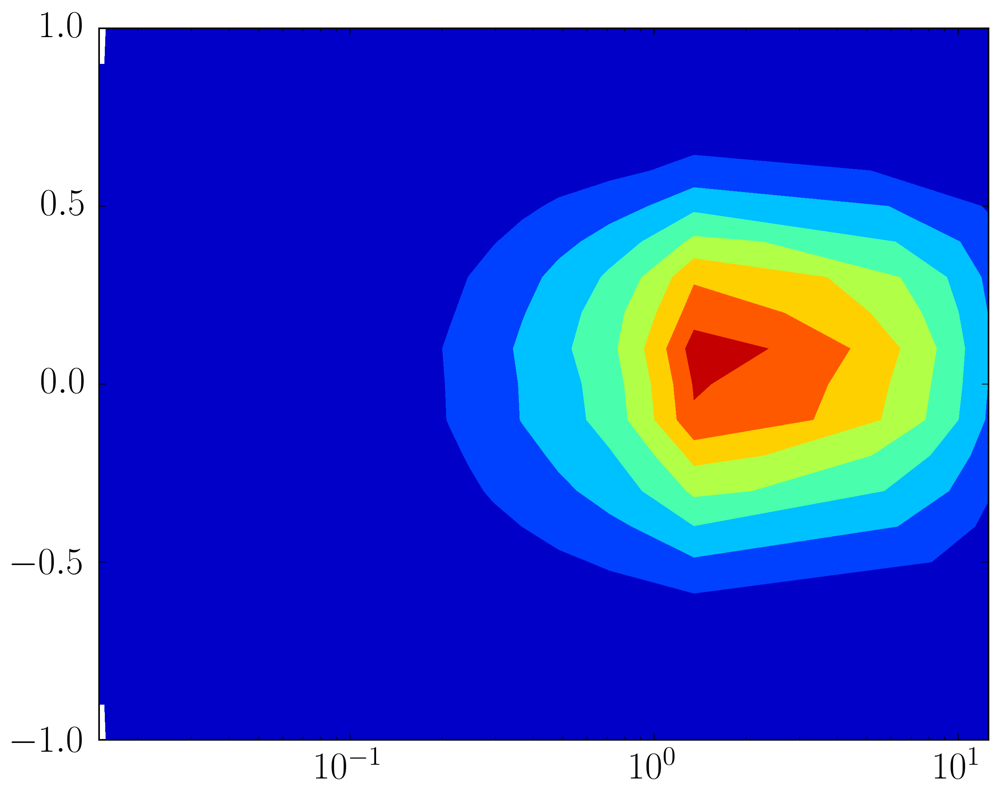

In [2159]:
plt.contourf(2*pi/kbin,ydbin,kbin*mtest2.transpose())
plt.xscale('log')

In [2101]:
print np.shape(matrix),np.shape(count)

(31, 512, 31) (31, 31)


In [2102]:
Ntimes,mmax,Nplanes = np.shape(matrix) 

In [2103]:
mtest= np.zeros([Ntimes,mmax,Nplanes])
for im in range(mmax):
    mtest[:,im,:] = matrix[:,im,:]/count[:,:]
    

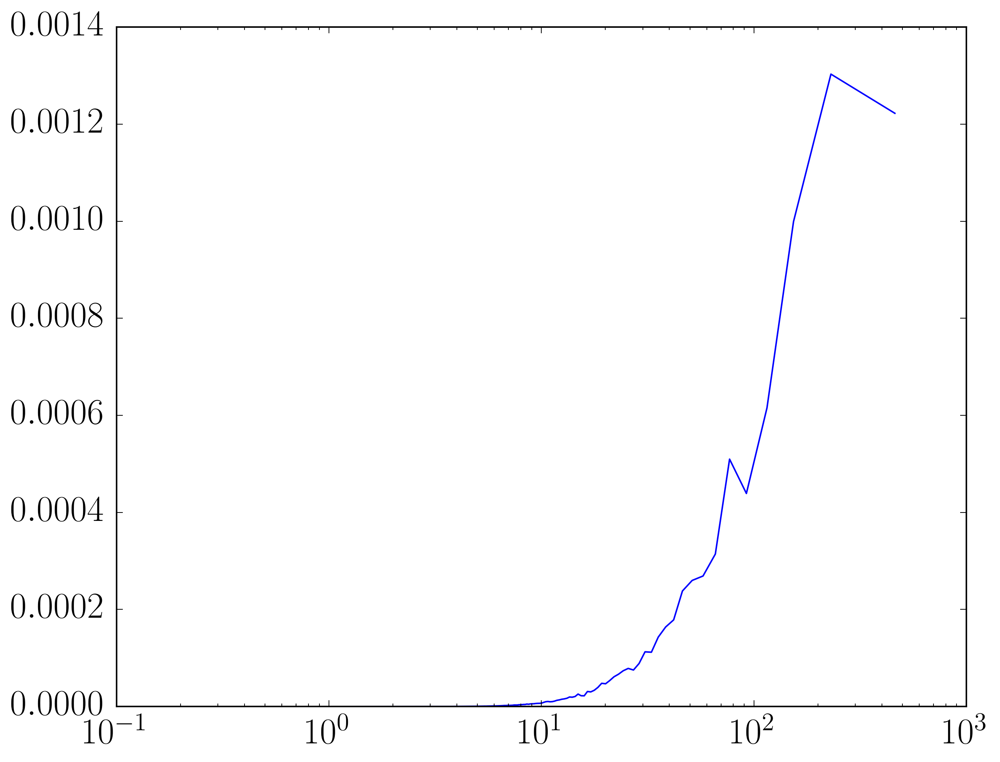

In [2107]:
plt.plot(2*np.pi/k,mtest[-2,:,13])
plt.xscale('log')

kmin = 0.508829206301
kmax = 450.08388369
yvslambdaEuu
Max countM = 58.0, plane numbers = 30
Max countM = 109.0, plane numbers = 30
Max countM = 167.0, plane numbers = 30
Max countM = 197.0, plane numbers = 30
Max countM = 250.0, plane numbers = 30
Max countM = 44.0, plane numbers = 30
Max countM = 91.0, plane numbers = 30
Max countM = 139.0, plane numbers = 30
Max countM = 34.0, plane numbers = 30
Max countM = 78.0, plane numbers = 30
Max countM = 112.0, plane numbers = 30
Max countM = 41.0, plane numbers = 30
Max countM = 75.0, plane numbers = 30
Max countM = 117.0, plane numbers = 30
maximorum=0.0365019036933
/share/drive/toni/VDML/JFM_joint/yvslambdaEuu.eps figure saved!
yvslambdaEvv
Max countM = 58.0, plane numbers = 30
Max countM = 109.0, plane numbers = 30
Max countM = 167.0, plane numbers = 30
Max countM = 197.0, plane numbers = 30
Max countM = 250.0, plane numbers = 30
Max countM = 44.0, plane numbers = 30
Max countM = 91.0, plane numbers = 30
Max countM = 139.0, plane numbers

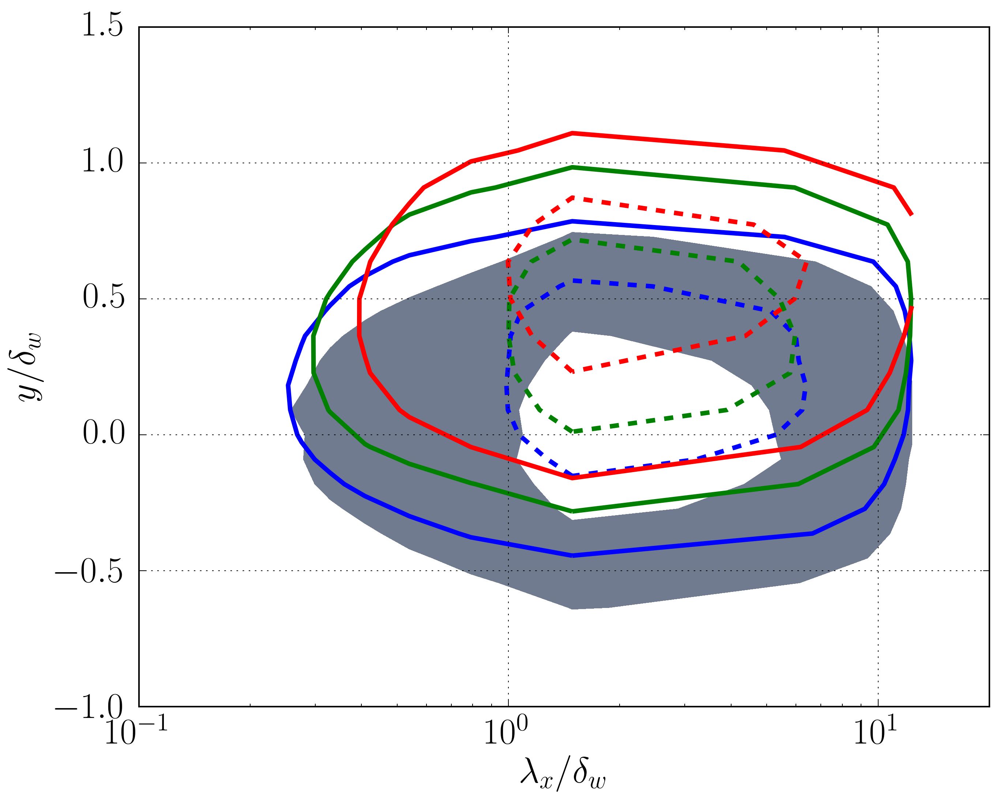

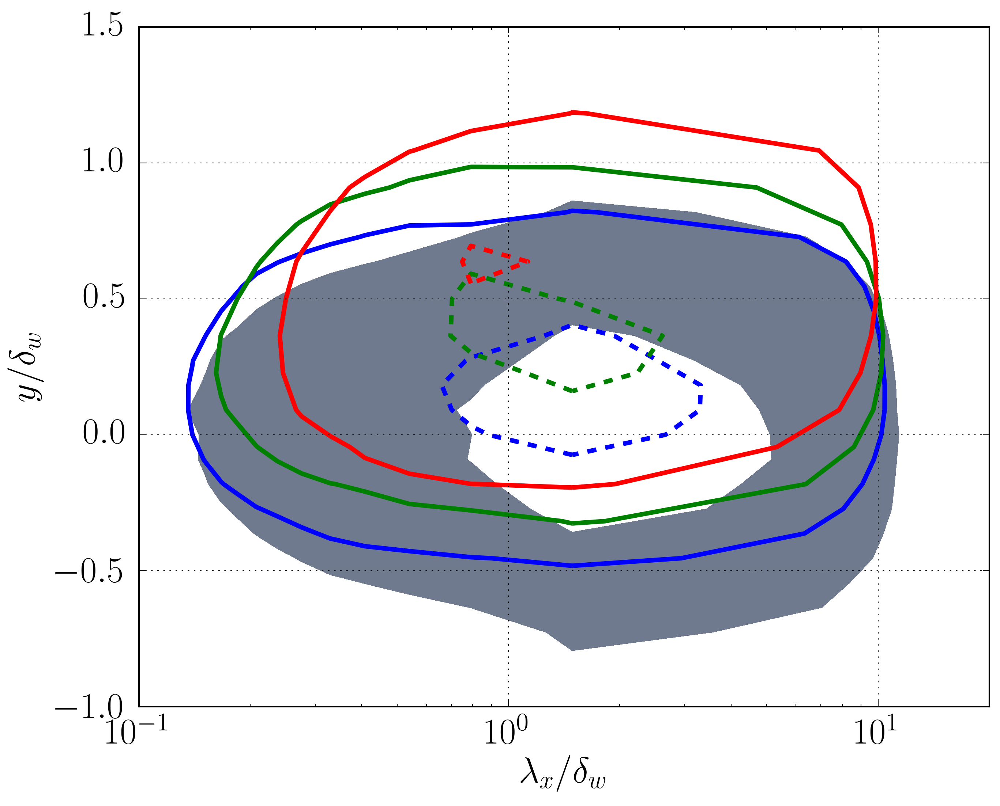

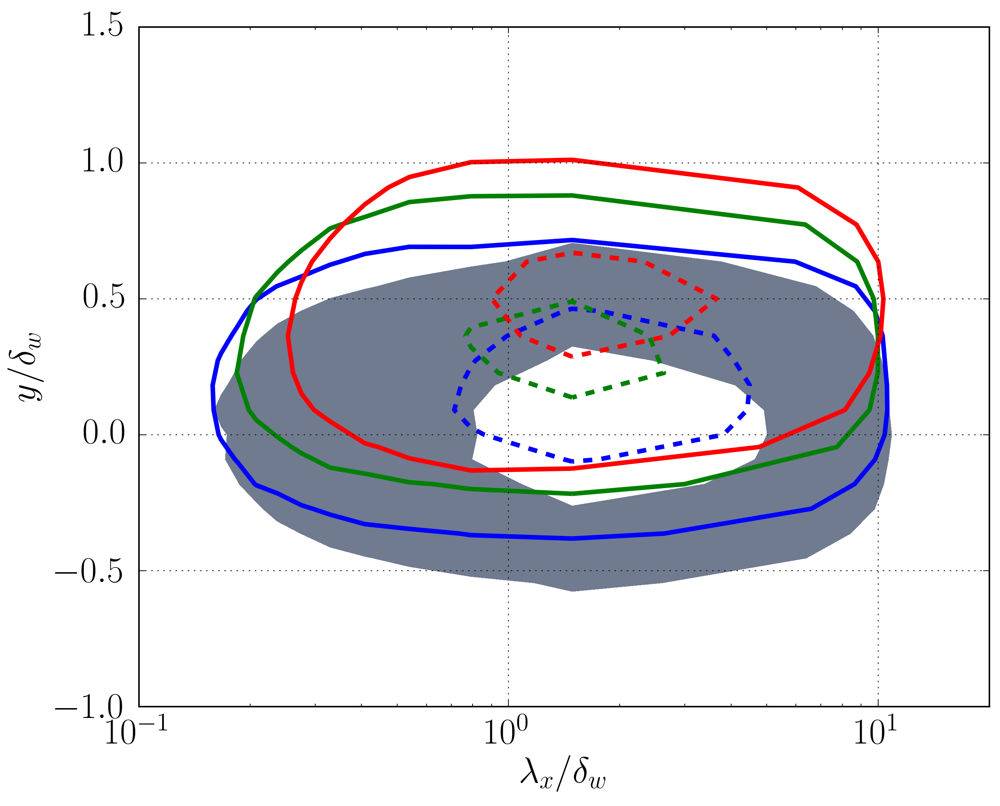

In [1368]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
#lvariable=[0,1,2] #u,v,w
lvariable=[0,1,2] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=0 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m =122; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,njobs)
Nkbins =m;
Nydbins = 23;
kmax = 0.0;
kmin = 100.0
mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1j[ijob]
    tmax=SS2j[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        kmin = min(kmin,alp[0]*delta[it1])
        #lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        kmin = min(kmin,bet[0]*delta[it1])
        #lbin = np.linspace(0,(2*pi/bet[0])/delta[it1],Nkbins)
        
kbin = np.linspace(kmin,kmax,Nkbins)
print "kmin = %s"%kmin
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdaE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1j[ijob]
            tmax=SS2j[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_x / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin*MspectraCASE[icases].transpose()
 
    CSF=plt.contourf(2*pi/kbin,ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    pectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        Z2 = kbin*MspectraCASE[icases].transpose()
        CS=plt.contour(2*pi/kbin,ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #CS2=plt.contour(2*pi/kbinref,ydbin[icases],Z2ref,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels_ref,colors=vcolors[icases],hold='on')
    
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')  

In [1363]:
kbinref = kbin;
Z2ref     = Z2;
levels_ref = levels

kmax = 899.515549186
yvslambdazEuu
Max countM = 58.0, plane numbers = 30
Max countM = 109.0, plane numbers = 30
Max countM = 167.0, plane numbers = 30
Max countM = 197.0, plane numbers = 30
Max countM = 250.0, plane numbers = 30
Max countM = 44.0, plane numbers = 30
Max countM = 91.0, plane numbers = 30
Max countM = 139.0, plane numbers = 30
Max countM = 34.0, plane numbers = 30
Max countM = 78.0, plane numbers = 30
Max countM = 112.0, plane numbers = 30
Max countM = 41.0, plane numbers = 30
Max countM = 75.0, plane numbers = 30
Max countM = 117.0, plane numbers = 30
maximorum=0.108565685023
/share/drive/toni/VDML/JFM_joint/yvslambdazEuu.eps figure saved!
yvslambdazEvv
Max countM = 58.0, plane numbers = 30
Max countM = 109.0, plane numbers = 30
Max countM = 167.0, plane numbers = 30
Max countM = 197.0, plane numbers = 30
Max countM = 250.0, plane numbers = 30
Max countM = 44.0, plane numbers = 30
Max countM = 91.0, plane numbers = 30
Max countM = 139.0, plane numbers = 30
Max countM = 

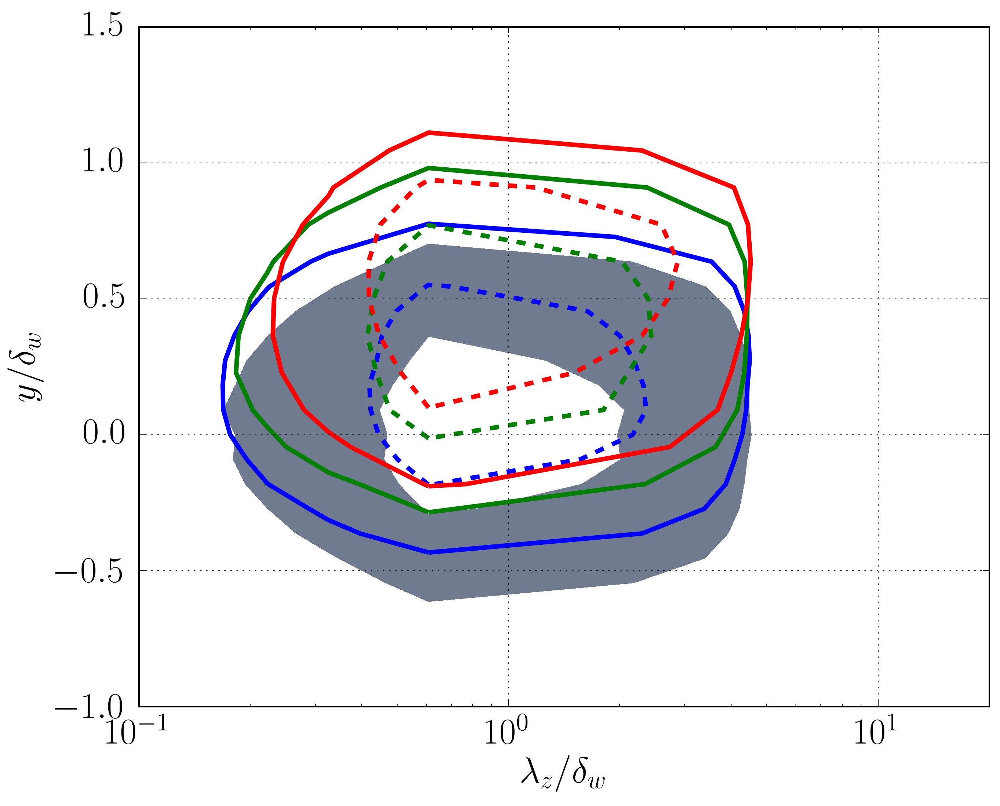

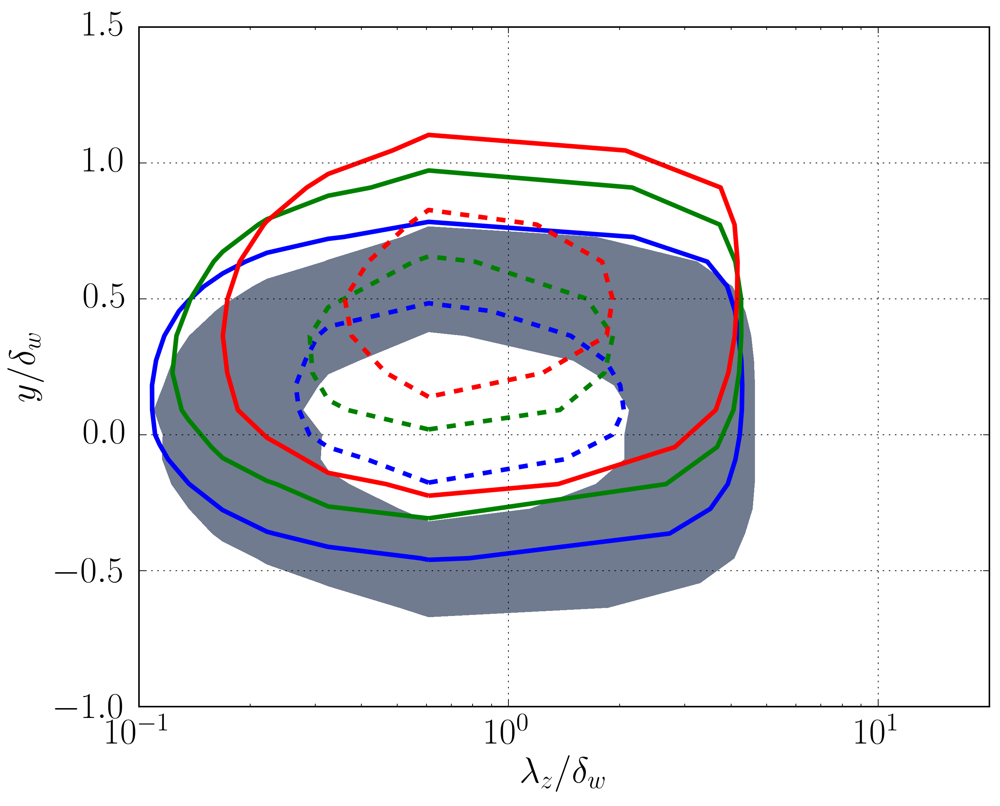

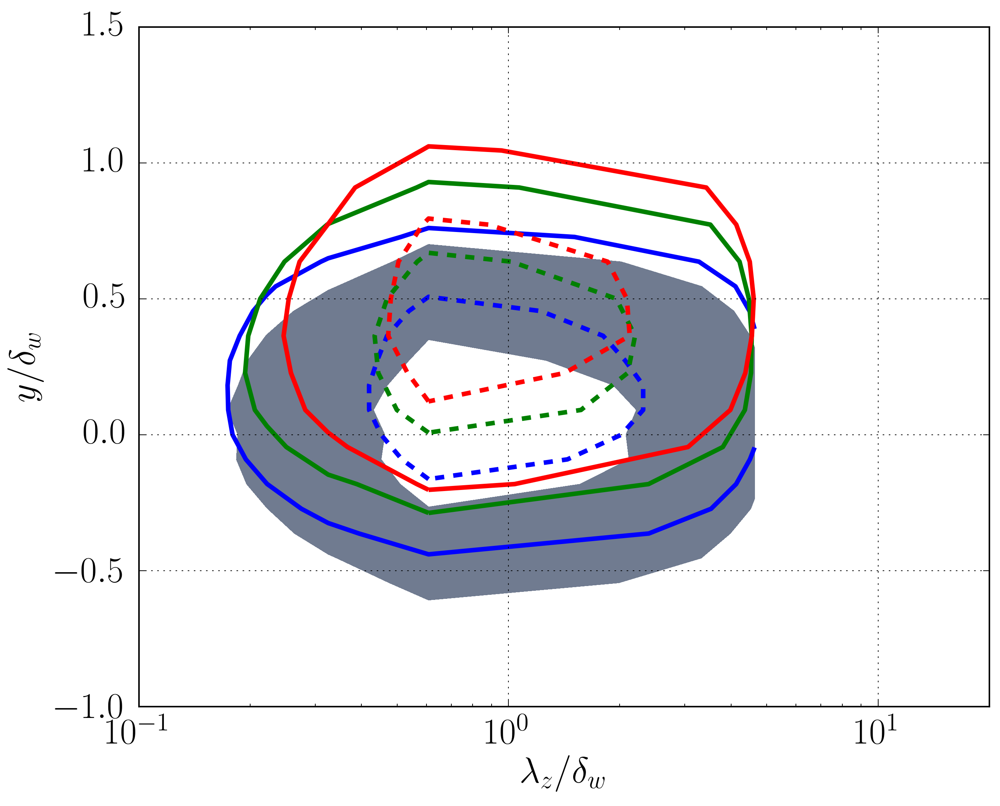

In [1370]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[0,1,2] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=1
m =101 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 23;
kmax = 0.0;
kmin=100.0
mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1j[ijob]
    tmax=SS2j[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
        kmin = min(kmin,alp[0]*delta[it1])
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
        kmin = min(kmin,bet[0]*delta[it1])
kbin = np.linspace(kmin,kmax,Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdazE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1j[ijob]
            tmax=SS2j[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_z / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin*MspectraCASE[icases].transpose()
 
    CSF=plt.contourf(2*pi/kbin,ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        Z2 = kbin*MspectraCASE[icases].transpose()
        CS=plt.contour(2*pi/kbin,ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

In [1371]:
DT = vDT

3.71549631805
kmax = 450.08388369
yvslambdaETT
Max countM = 62.0, plane numbers = 30
Max countM = 120.0, plane numbers = 30
Max countM = 181.0, plane numbers = 30
Max countM = 211.0, plane numbers = 30
Max countM = 269.0, plane numbers = 30
Max countM = 44.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 140.0, plane numbers = 30
Max countM = 34.0, plane numbers = 30
Max countM = 81.0, plane numbers = 30
Max countM = 115.0, plane numbers = 30
Max countM = 42.0, plane numbers = 30
Max countM = 80.0, plane numbers = 30
Max countM = 122.0, plane numbers = 30
maximorum=0.0539182615048
/share/drive/toni/VDML/JFM_joint/yvslambdaETT.eps figure saved!


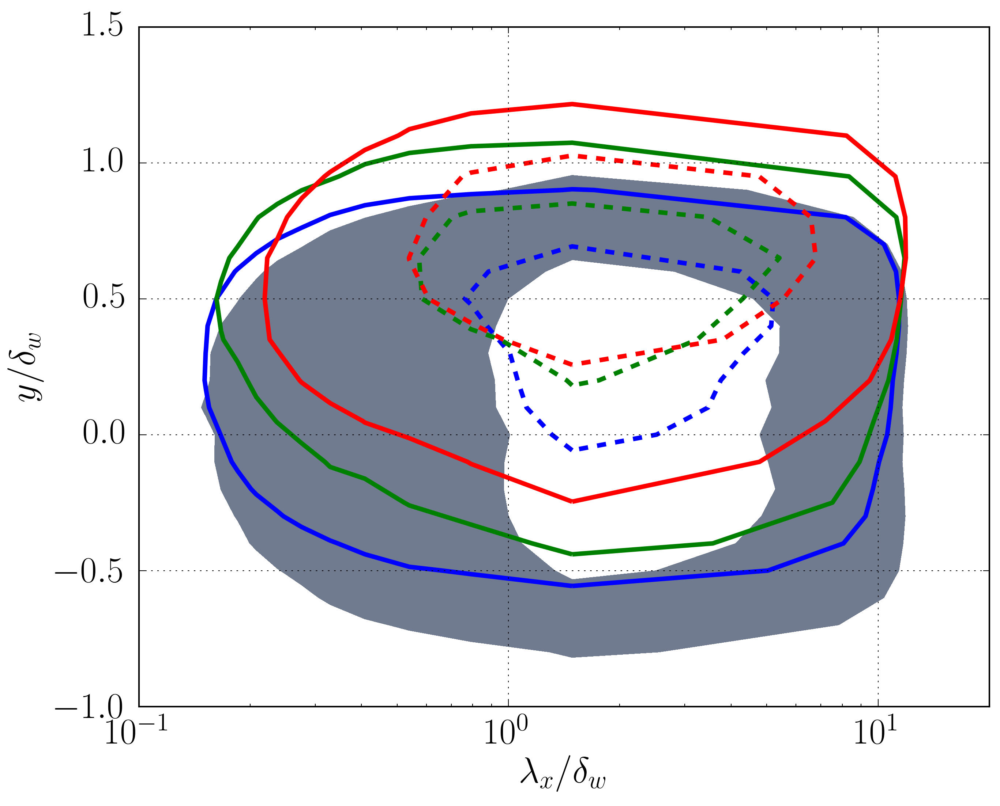

In [1373]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[11] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=0 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m = 122; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 21;
kmin=100;
kmax = 0.0;
mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1j[ijob]
    tmax=SS2j[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        kmin = min(kmin,alp[0]*delta[it1])
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        kmin = min(kmin,bet[0]*delta[it1])
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(kmin,kmax,Nkbins)
print np.min(np.diff(kbin))
#kbin = np.logspace(-2,np.log10(kmax),Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdaE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1j[ijob]
            tmax=SS2j[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_x / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin*MspectraCASE[icases].transpose()
 
    CSF=plt.contourf(2*pi/kbin,ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        levels=[maximorum*0.2*DT[icases]**2,maximorum*0.7*DT[icases]**2]
        Z2 = kbin*MspectraCASE[icases].transpose()
        CS=plt.contour(2*pi/kbin,ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

8.9815965443
kmax = 899.515549186
yvslambdaEzTT
Max countM = 62.0, plane numbers = 30
Max countM = 120.0, plane numbers = 30
Max countM = 181.0, plane numbers = 30
Max countM = 211.0, plane numbers = 30
Max countM = 269.0, plane numbers = 30
Max countM = 44.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 140.0, plane numbers = 30
Max countM = 34.0, plane numbers = 30
Max countM = 81.0, plane numbers = 30
Max countM = 115.0, plane numbers = 30
Max countM = 42.0, plane numbers = 30
Max countM = 80.0, plane numbers = 30
Max countM = 122.0, plane numbers = 30
maximorum=0.102212030431
/share/drive/toni/VDML/JFM_joint/yvslambdaEzTT.eps figure saved!


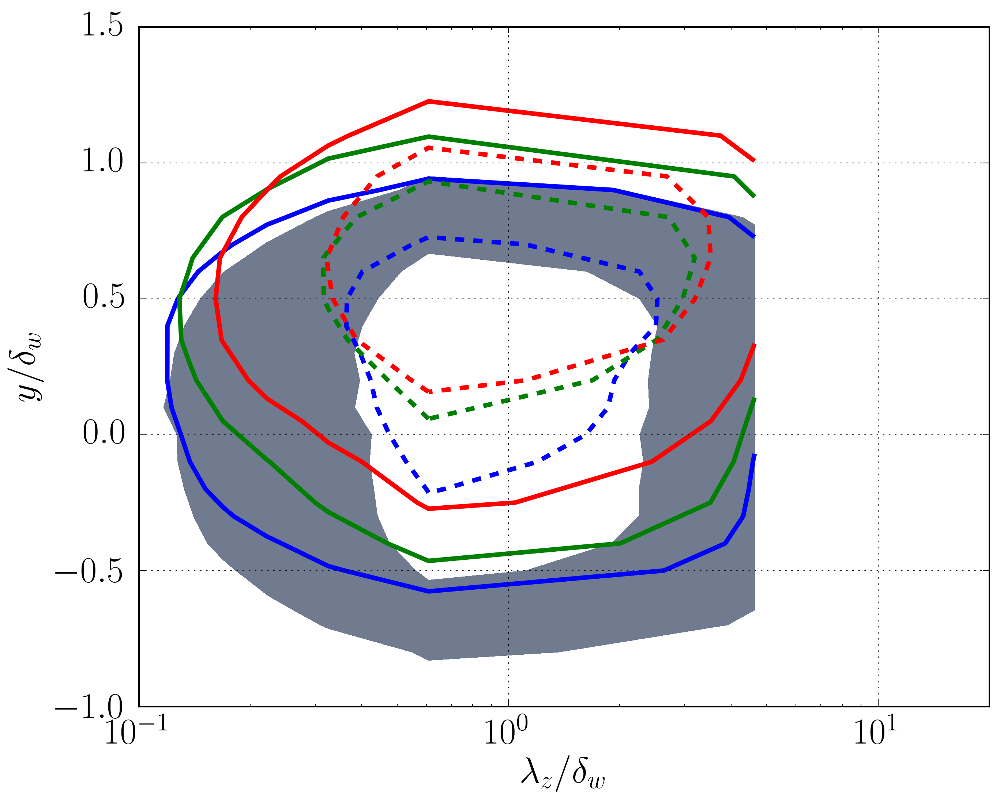

In [1377]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[11] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=1 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m = 101; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 21;
kmin=100;
kmax = 0.0;
mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1j[ijob]
    tmax=SS2j[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        kmin = min(kmin,alp[0]*delta[it1])
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        kmin = min(kmin,bet[0]*delta[it1])
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(kmin,kmax,Nkbins)
print np.min(np.diff(kbin))
#kbin = np.logspace(-2,np.log10(kmax),Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdaEz'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1j[ijob]
            tmax=SS2j[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_z / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin*MspectraCASE[icases].transpose()
 
    CSF=plt.contourf(2*pi/kbin,ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        levels=[maximorum*0.2*DT[icases]**2,maximorum*0.7*DT[icases]**2]
        Z2 = kbin*MspectraCASE[icases].transpose()
        CS=plt.contour(2*pi/kbin,ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

In [1376]:
print levels

[0.31497157547098725, 1.1024005141484552]


In [ ]:
print DT, Tmax

In [ ]:
MscaledCASE = np.zeros(np.shape(MspectraCASE))
for icases in [0,1,2,3]:
    for iyb in range(len(ydbin[icases])):
        maxE=np.max(MspectraCASE[icases][1:,iyb])
        if maxE!=0.0:
            MscaledCASE[icases][1:,iyb]=kbin[1:]*MspectraCASE[icases][1:,iyb]/maxE

In [ ]:
maximorum = 0.0
maximorum = np.max(MscaledCASE[:][1:,:])
print maximorum

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111)
plt.grid('on')
vcolors=['black','blue','green','red']
plt.ylim([-0.5,1.5])
plt.xscale('log')
plt.xlabel(r'$\lambda_x / \delta_w$')
plt.ylabel(r'$y/\delta_w$')
plt.xlim([0.1,20])
origin = 'lower'
#Special for s=1
icases=0
levels=[maximorum*0.2,maximorum*0.6]
CSF=plt.contourf(2*pi/kbin[1:],ydbin[icases],MscaledCASE[icases][1:,:].transpose(),levels=levels,                  #alpha=0.5,
                  cmap=plt.cm.bone,
                  origin=origin)

for icases in [1,2,3]:
    CS=plt.contour(2*pi/kbin[1:],ydbin[icases],MscaledCASE[icases][1:,:].transpose(),linewidths=(3,),levels=CSF.levels,colors=vcolors[icases],hold='on')
    # Label levels with specially formatted float
    #plt.clabel(CS, CS.levels)
#plt.clabel(CS, CS.levels, inline=False, fmt=fmt, fontsize=10)
#CB = plt.colorbar(CS, shrink=0.8, extend='both')
#plt.clabel(CS, CS.levels)

In [ ]:
print vplanes

# Conventional spectra

In [ ]:
fnplane='mid'
vplanes=[]
nmaxplanes=[]
for ijob,path in zip(range(len(p_folders)),p_folders):
    print ijob
    p_folders_spe[ijob]=path[0:-5]+fnplane+'.spes'
    print p_folders_spe[ijob]
    path = p_folders_spe[ijob]
    with h5py.File(path,"r") as f:
        v=np.array(f['jsp'])
        vplanes.append(v)
        nmaxplanes.append(len(v))
    #New sorted planes trick
    vplanes[ijob]=sorted(vplanes[ijob])
print vplanes
print nmaxplanes
#scaling = 'dm'
p_folders_spe=[['']*nmaxplanes[ijob] for ijob in range(len(p_folders))]
for ijob,path in zip(range(len(p_folders)),p_folders):
    with h5py.File(path,"r") as g:
        my = len(np.array(g['y']))
        time=np.array(g['time'])
        dd=np.array(g[scaling])
        midplane = my/2+1
        #print "midplane=%s"%midplane
    for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
        if nplane==midplane: #Lastplane
            #print "This is midplane"
            fnplane='mid'
        else:
            fnplane="%03d"%nplane
        p_folders_spe[ijob][jj]=path[0:-5]+fnplane+'.spes'
        #print "Reading spe file: %s" %(pathSPE)

In [ ]:
print vplanes[11]

# Spectra for s=1

# Spectra for s=4

In [ ]:
scaling='dw'
sumaxis=0
variable=0
Npoints=500;
ydeltaBIG=[]
fjob=True
joblist=[8]
count=1
iplane = 0
for ijob in joblist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    pathSTA = p_folders[ijob]
    for nplane in range(0,nmaxplanes[ijob],1):
        path = p_folders_spe[ijob][nplane]
        print "opening path= %s" %path
        [xik,ydelta,SPEC,timev,modes00]=getSpectra2(path,vplanes[ijob][nplane],pathSTA,variable,tmin,tmax, sumaxis,scaling)
        itimes=len(ydelta)
        if nplane==0 and fjob==True:
            matrix = np.zeros([itimes,Npoints+1])
            matrix[:,-1]=ydelta
            fjob=False
        else:
            mm = np.zeros([itimes,Npoints+1])
            mm[:,-1] = ydelta
            matrix = r_[matrix,mm]
        matrix[count*iplane*itimes:(count*iplane*itimes+itimes),:-1] = SPEC
        iplane+=1
    count+=1
    
    # scatter with colormap mapping to z value
matrix = matrix[matrix[:,-1].argsort()]
#print matrix[0,-1],matrix[-1,-1]
ydeltaBIG= matrix[:,-1]

In [ ]:
print matrix[0,-1],matrix[-1,-1]
fig = plt.figure()
ax = fig.add_subplot(111)
plt.xlabel(r'$\lambda_x/\delta_w$')
plt.ylabel(r'$y/\delta_w$')
print shape(matrix),shape(ydeltaBIG)
plt.contourf(2*pi/xik,ydeltaBIG,matrix[:,:-1],100)
plt.ylim([-1,1])
plt.xscale('log')
plt.grid('on')
plt.colorbar()

In [ ]:
scaling='dw'
sumaxis=0
variable=0
Npoints=500;
ydeltaBIG=[]
fjob=True
joblist=[2]
count=1
iplane = 0
for ijob in joblist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    pathSTA = p_folders[ijob]
    for nplane in range(0,nmaxplanes[ijob]-1,1):
        path = p_folders_spe[ijob][nplane]
        print "opening path= %s" %path
        [xik,ydelta,SPEC,timev,modes00]=getSpectra2(path,vplanes[ijob][nplane],pathSTA,variable,tmin,tmax, sumaxis,scaling)
        itimes=len(ydelta)
        if nplane==0 and fjob==True:
            matrix = np.zeros([itimes,Npoints+1])
            matrix[:,-1]=ydelta
            fjob=False
        else:
            mm = np.zeros([itimes,Npoints+1])
            mm[:,-1] = ydelta
            matrix = r_[matrix,mm]
        matrix[count*iplane*itimes:(count*iplane*itimes+itimes),:-1] = SPEC
        iplane+=1
    count+=1
    
    # scatter with colormap mapping to z value
matrix = matrix[matrix[:,-1].argsort()]
#print matrix[0,-1],matrix[-1,-1]
ydeltaBIG= matrix[:,-1]

In [ ]:
print matrix[0,-1],matrix[-1,-1]
fig = plt.figure()
ax = fig.add_subplot(111)
plt.xlabel(r'$\lambda_x/\delta_w$')
plt.ylabel(r'$y/\delta_w$')
print shape(matrix),shape(ydeltaBIG)
plt.contourf(2*pi/xik,ydeltaBIG,matrix[:,:-1])
plt.xscale('log')
plt.ylim([-1,1])
plt.grid('on')
plt.colorbar()

In [ ]:
scaling='dw'
sumaxis=0
variable=0
Npoints=500;
ydeltaBIG=[]
fjob=True
joblist=[9]
count=1
iplane = 0
for ijob in joblist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    pathSTA = p_folders[ijob]
    for nplane in range(0,nmaxplanes[ijob]-1,1):
        path = p_folders_spe[ijob][nplane]
        print "opening path= %s" %path
        [xik,ydelta,SPEC,timev,modes00]=getSpectra2(path,vplanes[ijob][nplane],pathSTA,variable,tmin,tmax, sumaxis,scaling)
        itimes=len(ydelta)
        if nplane==0 and fjob==True:
            matrix = np.zeros([itimes,Npoints+1])
            matrix[:,-1]=ydelta
            fjob=False
        else:
            mm = np.zeros([itimes,Npoints+1])
            mm[:,-1] = ydelta
            matrix = r_[matrix,mm]
        matrix[count*iplane*itimes:(count*iplane*itimes+itimes),:-1] = SPEC
        iplane+=1
    count+=1
    
    # scatter with colormap mapping to z value
matrix = matrix[matrix[:,-1].argsort()]
#print matrix[0,-1],matrix[-1,-1]
ydeltaBIG= matrix[:,-1]

In [ ]:
print matrix[0,-1],matrix[-1,-1]
fig = plt.figure()
ax = fig.add_subplot(111)
plt.xlabel(r'$\lambda_x/\delta_w$')
plt.ylabel(r'$y/\delta_w$')
print shape(matrix),shape(ydeltaBIG)
plt.contourf(2*pi/xik,ydeltaBIG,matrix[:,:-1])
plt.ylim([-1,1])
#plt.xlim([0,10])
plt.xscale('log')
plt.grid('on')
plt.colorbar()

In [ ]:
print DT

# INFINITELY LARGE MODES RATIO EVOLUTION

In [ ]:
fnplane='mid'
vplanes=[]
nmaxplanes=[]
for ijob,path in zip(range(len(p_folders)),p_folders):
    print ijob
    p_folders_spe[ijob]=path[0:-5]+fnplane+'.spes'
    print p_folders_spe[ijob]
    path = p_folders_spe[ijob]
    with h5py.File(path,"r") as f:
        v=np.array(f['jsp'])
        vplanes.append(v)
        nmaxplanes.append(len(v))
    #New sorted planes trick
    vplanes[ijob]=sorted(vplanes[ijob])
print vplanes
print nmaxplanes
#scaling = 'dm'
p_folders_spe=[['']*nmaxplanes[ijob] for ijob in range(len(p_folders))]
for ijob,path in zip(range(len(p_folders)),p_folders):
    with h5py.File(path,"r") as g:
        my = len(np.array(g['y']))
        time=np.array(g['time'])
        dd=np.array(g[scaling])
        midplane = my/2+1
        #print "midplane=%s"%midplane
    for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
        if nplane==midplane: #Lastplane
            #print "This is midplane"
            fnplane='mid'
        else:
            fnplane="%03d"%nplane
        p_folders_spe[ijob][jj]=path[0:-5]+fnplane+'.spes'
        #print "Reading spe file: %s" %(pathSPE)

In [ ]:
def getSpectracase(p_folders,nplane,p_foldersSTA,lcases,variable,scaling,SS1,SS2,sumaxis,Npoints=1000):
    """
    returns as many vectors as cases wanted to compute.
    Distribution of cases is given in lcases(ex. lcases = [[0,1,2],[3,5]])
    return only one profile per case
    """
    ncases = len(lcases)
    fycases = [[] for i in range(ncases)]
    vt = []
    f00 = []
    ycases = [[] for i in range(ncases)]
    ferrorcases = [[] for i in range(ncases)]
    for icase in range(ncases):
        vpcases = []
        vpcasesSTA=[]
        nacum = 0
        fy = np.zeros(Npoints)
        yf = [[]for i in range(len(lcases[icase]))]
        fy= [[]for i in range(len(lcases[icase]))]
        ferror = [[] for i in range(len(lcases[icase]))]
        nn=len(lcases[icase])
        for ijob in lcases[icase]:
            vpcases    = vpcases    + [p_folders[ijob]]
            vpcasesSTA = vpcasesSTA + [p_foldersSTA[ijob]]
        for path,i in zip(vpcases,range(len(vpcases))):
            ijob = lcases[icase][i]
            pathSTA = vpcasesSTA[i]
            print ijob
            yf[i],fy[i],ferror[i],tt,kk,ydmEVO = getSpectra(path,nplane,pathSTA,variable,SS1[ijob],SS2[ijob],sumaxis,scaling,Npoints)
            vt.append(tt)
            f00.append(kk)
        ycases[icase]=yf
        print "y/delta evolution with time: %s"%(ydmEVO)
        fycases[icase]=np.mean(fy,axis=0)
        ferrorcases[icase]=np.max(ferror,axis=0)
    return ycases,fycases,ferrorcases,vt,f00,ydmEVO

In [ ]:
def getSpectravstime(path,nplane,variable):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;

        
        #funSPE = np.array(f['SPEC'][1:,variable,1:,:]);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = funSPE[0,0,:]
        for tt in range(len(time)):
            funSPE[0,0,tt]=0.0
        funkx0  = np.sum(funSPE[:,0,:],axis=0)
        res=time*0.0
        for kk,ii in  zip(kx,range(len(kx))):
            res += np.sum(funSPE[:,ii,:],axis=0)
        funRest = res
        #funRest = np.sum(kx[1:]*np.sum(kz[:]*funSPE[1:,0:,:],axis=1),axis=0)
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    return kx,kz,time,funkx0,funRest,fun00

In [ ]:
def getSpectrazvstime(path,nplane,variable):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;

        
        #funSPE = np.array(f['SPEC'][1:,variable,1:,:]);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = funSPE[0,0,:]
        for tt in range(len(time)):
            funSPE[0,0,tt]=0.0
        funkz0  = np.sum(funSPE[0,:,:],axis=0)
        res=time*0.0
        for kk,ii in  zip(kz,range(len(kz))):
            res += np.sum(funSPE[ii,:,:],axis=0)
        funRest = res
        #funRest = np.sum(kx[1:]*np.sum(kz[:]*funSPE[1:,0:,:],axis=1),axis=0)
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    return kx,kz,time,funkz0,funRest,fun00

In [ ]:
var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
           '$\rho v$':9,'$\rho w$':10,'T':11}
ind_var = {v: k for k, v in var_ind.items()}
var_name = ['u','v','w','$\omega_2$','T']
nvar = len(var_name)+1
print "You will analyse a total of %s variables." %nvar
var_list = []
for j in range(len(var_name)):
    var_list.append(var_ind[var_name[j]])
print var_list

In [ ]:
#Define index of variables SPECTRA
#----------------------------------------
iu = 0 #index of variable
iv = 1
iw = 2
iT = 11
iome1 = 5
iome2 = 6
iome3 = 7

In [ ]:
def integralSpectravstime(p_folders_spe,vplanes,y,variable, sumaxis):
    """
    Spectra vs time integrated MAKE SURE PLANE NAMES ARE ORDERED
    """
    if sumaxis==0:
        yplanes = y[np.subtract(vplanes,1)]#Create vector with position of planes
        Dyplanes = y[np.subtract(vplanes,1)] #Create Dyplanes
        for j in range(1,len(Dyplanes)-1):
            Dyplanes[j]=(yplanes[j+1]-yplanes[j-1])/2.0
        Dyplanes[0]=(yplanes[1]-yplanes[0])/2.0
        Dyplanes[-1]=(yplanes[-1]-yplanes[-2])/2.0
        for iplane in range(len(vplanes)):
            #Initializing
            if iplane==0:
                path = p_folders_spe[iplane]
                [kx,kz,time,intSPECtime0,intSPECtimeRest,fun00]=getSpectravstime(path,iplane,variable)
                intSPECtime0 = intSPECtime0*Dyplanes[iplane]
                intSPECtimeRest = intSPECtimeRest*Dyplanes[iplane]
            else:
                path = p_folders_spe[iplane]
                [kx,kz,time,funkx0,funRest,fun00]=getSpectravstime(path,iplane,variable)
                intSPECtime0 += funkx0*Dyplanes[iplane]
                intSPECtimeRest += funRest*Dyplanes[iplane]
    elif sumaxis==1:
        yplanes = y[np.subtract(vplanes,1)]#Create vector with position of planes
        Dyplanes = y[np.subtract(vplanes,1)] #Create Dyplanes
        for j in range(1,len(Dyplanes)-1):
            Dyplanes[j]=(yplanes[j+1]-yplanes[j-1])/2.0
        Dyplanes[0]=(yplanes[1]-yplanes[0])/2.0
        Dyplanes[-1]=(yplanes[-1]-yplanes[-2])/2.0
        for iplane in range(len(vplanes)):
            #Initializing
            if iplane==0:
                path = p_folders_spe[iplane]
                [kx,kz,time,intSPECtime0,intSPECtimeRest,fun00]=getSpectrazvstime(path,iplane,variable)
                intSPECtime0 = intSPECtime0*Dyplanes[iplane]
                intSPECtimeRest = intSPECtimeRest*Dyplanes[iplane]
            else:
                path = p_folders_spe[iplane]
                [kx,kz,time,funkx0,funRest,fun00]=getSpectrazvstime(path,iplane,variable)
                intSPECtime0 += funkx0*Dyplanes[iplane]
                intSPECtimeRest += funRest*Dyplanes[iplane]            
                
    return kx,kz,time,intSPECtime0,intSPECtimeRest
 


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=0;
variable=0
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{u_i u_i}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{u_i u_i}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'modeskx0ratioEnergy'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,funu1,fun2u] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,0,sumaxis)
    [kx,kz,time,funv1,fun2v] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,1,sumaxis)
    [kx,kz,time,funw1,fun2w] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,2,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],((funu1+funv1+funw1)/(fun2u+fun2v+fun2w))[0:itmax]*100,l_job_style[ijob/3],lw=2.0)
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure %s saved!"%pathname

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=0
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{u_i u_i}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{u_i u_i}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'modeskz0ratioEnergy'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,funu1,fun2u] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,0,sumaxis)
    [kx,kz,time,funv1,fun2v] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,1,sumaxis)
    [kx,kz,time,funw1,fun2w] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,2,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],((funu1+funv1+funw1)/(fun2u+fun2v+fun2w))[0:itmax]*100,l_job_style[ijob/3],lw=2.0)
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure %s saved!"%pathname

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=0
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{uu}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{uu}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=0;
variable=1
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{vv}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=1
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{vv}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [ ]:
print SS2

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=0;
variable=2
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{ww}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=2
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{ww}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [ ]:
print p_folders[9]

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{uu}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{uu}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectravstime(p_folders_spe[ijob],-1,0)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{uu}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{uu}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectrazvstime(p_folders_spe[ijob],-1,0)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{vv}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectravstime(p_folders_spe[ijob],-1,1)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{vv}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectrazvstime(p_folders_spe[ijob],-1,1)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

In [ ]:
print SS1

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{ww}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectravstime(p_folders_spe[ijob],-1,2)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{ww}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectrazvstime(p_folders_spe[ijob],-1,2)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

# One-dimensional spectra
From Pope:

$R_{11}(\mathbf{e_1 r_1},t) = \langle u_1^2 \rangle f(r_1,t)$

$R_{22}(\mathbf{e_1 r_1},t) = \langle u_2^2 \rangle g(r_1,t)$

Where f and g are the longitudinal and transverse autocorrelation functions.

$R_{22}(\mathbf{e_1} r_1) = \int_0^\infty E_{22}(k_1) cos(k_1 r_1) dk_1$.

And:

$R_{22}(0) = \langle u_2^2 \rangle= \int_0^\infty E_{22}(k_1)  dk_1$.

In order to obtain the 1D spectra from the 2D spectra, we need to sum all $\textit{z-modes}$ for each $\textit{x-mode}$ and viceversa.

For the integral scale we need to use this:

$L_{11} = \int_0^\infty f(r_1) dr_1 = \cfrac{\pi E_{11}(0)}{2\langle u_1^2 \rangle}$.

In [ ]:
def getspectra(path,variable):
    """
    Obtain the spectra for dimension 0 (x) of 1 (z)
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        #The last distance being half of the box length
    #Clean the 00 mode, we want to analyze perturbations,not velocities.
    mode00 = np.zeros([len(time)])
    for tt in range(len(time)):
        mode00[tt]=funSPE[0,0,tt]
        funSPE[0,0,tt] = 0.0

    #Spectra has already been myltiplied by dkxdkz
   
    Eiik1=np.zeros([len(kx),len(time)])
    for kkx,ii in zip(kx,range(len(kx))):
        for kkz,jj in zip(kz,range(len(kz))):
            kk = (kkx**2+kkz**2)**0.5
            #Eiik1[ii,:]= Eiik1[ii,:]+1.0/(2*3.1416*kk**2)*(1.0-(kkx**2/kk**2))*funSPE[jj,ii,:]
            Eiik1[ii,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
    Eiik3=np.zeros([len(kz),len(time)])
    for kkz,jj in zip(kz,range(len(kz))):
        for kkx,ii in zip(kx,range(len(kx))):
                #kk = (kkx**2+kkz**2)**0.5
            Eiik3[jj,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
        #Scaling    
    return kx,kz,time,Eiik1,Eiik3,mode00

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$k_x$'
ylabel =r'$kxE_{u_iu_i} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([-0.5,1])
plt.grid('on')
plt.xscale('log')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,Ex,Ez,f00] = getspectra(p_folders_spe[ijob],0)
    [kx,kz,time,Ex2,Ez2,f002] = getspectra(p_folders_spe[ijob],1)
    [kx,kz,time,Ex3,Ez3,f003] = getspectra(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(kx/kx[1],kx*(Ex[:,ilim]+Ex2[:,ilim]+Ex3[:,ilim])/kx[1],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$k_x$'
ylabel =r'$E_{u_iu_i} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([-0.5,1])
plt.grid('on')
plt.xscale('log')
plt.yscale('log')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,Ex,Ez,f00] = getspectra(p_folders_spe[ijob],0)
    [kx,kz,time,Ex2,Ez2,f002] = getspectra(p_folders_spe[ijob],1)
    [kx,kz,time,Ex3,Ez3,f003] = getspectra(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(kx/kx[1],(Ex[:,ilim]+Ex2[:,ilim]+Ex3[:,ilim]),l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$k_z$'
ylabel =r'$E_{u_iu_i} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([-0.5,1])
plt.grid('on')
plt.xscale('log')
plt.yscale('log')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,Ex,Ez,f00] = getspectra(p_folders_spe[ijob],0)
    [kx,kz,time,Ex2,Ez2,f002] = getspectra(p_folders_spe[ijob],1)
    [kx,kz,time,Ex3,Ez3,f003] = getspectra(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(kz/kz[1],(Ez[:,ilim]+Ez2[:,ilim]+Ez3[:,ilim]),l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
def getRiivstime(path,variable,Npoints=200):
    """
    Obtain the correlation from spectra
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        #The last distance being half of the box length
    #Clean the 00 mode, we want to analyze perturbations,not velocities.
    mode00 = np.zeros([len(time)])
    for tt in range(len(time)):
        mode00[tt]=funSPE[0,0,tt]
        funSPE[0,0,tt] = 0.0
    xmax=np.pi/kx[1]
        #Define a vector x
    xvect = np.linspace(0,xmax,Npoints);
        #discretization integral factor
        #int(f(x)) = fact*sum(f(x_i))
    #Spectra has already been myltiplied by dkxdkz
    #fact=1
    #Riix = np.zeros([Npoints,len(time)],dtype=complex)
    Riix = np.zeros([Npoints,len(time)])
    Eiik1=np.zeros([len(kx),len(time)])
    
    for kkx,ii in zip(kx,range(len(kx))):
        for kkz,jj in zip(kz,range(len(kz))):
            kk = (kkx**2+kkz**2)**0.5
            #Eiik1[ii,:]= Eiik1[ii,:]+1.0/(2*3.1416*kk**2)*(1.0-(kkx**2/kk**2))*funSPE[jj,ii,:]
            Eiik1[ii,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
    for i in range(Npoints):   
        for kkx,ii in zip(kx,range(len(kx))):
            Riix[i,:] += Eiik1[ii,:]*cos(kkx*xvect[i])
        #Scaling    
    
    Riix=Riix/Riix[0,:]

    dk1=kx[-1]/(len(kx)-1)
    Lii = np.pi*(Eiik1[0,:])/(2*Riix[0,:])/dk1
    #Lii = np.pi*(Eiik1[0,:]+mode00)/(2*Riix[0,:])
    print Eiik1[0,-1],Riix[0,-1]
    #fun00 = funSPE[0,0,:]
        
    #funkx0  = np.sum(funSPE[1:,1,:],axis=0)
    #res=time*0.0
    #for kk,ii in  zip(kx[1:],range(1,len(kx))):
    #    res += np.sum(funSPE[1:,ii,:],axis=0)
    #funRest = res
    return kx,kz,time,xvect,Riix,Rii0,Lii

In [ ]:
def getRiizvstime(path,variable,Npoints=100):
    """
    Obtain the correlation from spectra
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        #The last distance being half of the box length
    #Clean the 00 mode, we want to analyze perturbations,not velocities.
    mode00 = np.zeros([len(time)])
    for tt in range(len(time)):
        mode00[tt]=funSPE[0,0,tt]
        funSPE[0,0,tt] = 0.0
    zmax=np.pi/kz[1]
        #Define a vector x
    zvect = np.linspace(0,zmax,Npoints);
        #discretization integral factor
        #int(f(x)) = fact*sum(f(x_i))
    #Spectra has already been myltiplied by dkxdkz
    #fact=1
    #Riix = np.zeros([Npoints,len(time)],dtype=complex)
    Riiz = np.zeros([Npoints,len(time)])
    Eiik3=np.zeros([len(kz),len(time)])
    
    
    for kkz,jj in zip(kz,range(len(kz))):
        for kkx,ii in zip(kx,range(len(kx))):
            #kk = (kkx**2+kkz**2)**0.5
            #Eiik1[ii,:]= Eiik1[ii,:]+1.0/(2*3.1416*kk**2)*(1.0-(kkx**2/kk**2))*funSPE[jj,ii,:]
            Eiik3[jj,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
    for i in range(Npoints):   
        for kkz,jj in zip(kz,range(len(kz))):
            Riiz[i,:] += Eiik3[jj,:]*cos(kkz*zvect[i])
        #Scaling    
    
    Riiz=Riiz/Riiz[0,:]

    dk3=kz[-1]/(len(kz)-1)
    Lii = np.pi*(Eiik3[0,:])/(2*Riiz[0,:])/dk3
    #Lii = np.pi*(Eiik1[0,:]+mode00)/(2*Riix[0,:])
    print Eiik3[0,-1],Riiz[0,-1]
    #fun00 = funSPE[0,0,:]
        
    #funkx0  = np.sum(funSPE[1:,1,:],axis=0)
    #res=time*0.0
    #for kk,ii in  zip(kx[1:],range(1,len(kx))):
    #    res += np.sum(funSPE[1:,ii,:],axis=0)
    #funRest = res
    return kx,kz,time,zvect,Riiz,Riiz[0,:],Lii

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$x$'
ylabel =r'$R_{uu} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$z$'
ylabel =r'$R_{uu} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$x$'
ylabel =r'$R_{vv} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],1)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$z$'
ylabel =r'$R_{vv} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],1)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$x$'
ylabel =r'$R_{ww} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$z$'
ylabel =r'$R_{ww} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [ ]:
l_point_style=['k*','k*','k*','b*','b*','b*','g*','g*','g*','r*','r*','r*']

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$time$'
ylabel =r'$l_{x}/L_x $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([0,0.2])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(time,L11,l_job_style[ijob/3])
    plt.plot(time[ilim],L11[ilim],l_point_style[ijob])
    print time[ilim]
    


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$time$'
ylabel =r'$l_{z}/L_z $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([0,0.2])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(time,L11,l_job_style[ijob/3])
    plt.plot(time[ilim],L11[ilim],l_point_style[ijob])
    print time[ilim]
    


 For Pantano: $lx/Lx = 0.126$ for $s=8$ at the end of the simulation
